In [ ]:
function ClickConnect(){
    console.log("코랩 연결 끊김 방지"); 
    document.querySelector("colab-toolbar-button#connect").click() 
}
setInterval(ClickConnect, 60 * 1000)

https://www.kaggle.com/slothkong/10-monkey-species/kernels

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')
import os                                            # 디렉토리 설정
os.chdir("/content/gdrive/My Drive/대학원/응용통계적특수연구/report")

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/gdrive


In [ ]:
import os
import numpy as np
import pandas as pd
from keras.preprocessing.imagea import ImageDataGenerator, image
from keras.layers import Conv2D, MaxPooling2D,Flatten,Dense,Dropout, UpSampling2D, concatenate, BatchNormalization, Conv2DTranspose, ZeroPadding2D, AveragePooling2D, Input,Lambda, Reshape
from keras.models import Sequential, Model
from keras.callbacks import ReduceLROnPlateau, EarlyStopping, ModelCheckpoint
from keras.applications import VGG16, inception_v3, Xception
from keras.applications.resnet50 import ResNet50, preprocess_input
from keras.applications.inception_v3 import preprocess_input
from keras.optimizers import Adam, SGD
from keras import Input
import keras.regularizers

from skimage import io
import glob
import datetime as dt
import matplotlib.pyplot as plt
from keras import backend as k
from keras.utils import plot_model
from sklearn.metrics import confusion_matrix, classification_report, accuracy_score
from PIL import ImageFile
ImageFile.LOAD_TRUNCATED_IMAGE = True
#from fastai.plots import *

# 데이터 불러오기

In [ ]:
base_dir='monkeys10'#여기부터~
train_dir=os.path.join(base_dir,'training/training')
validation_dir=os.path.join(base_dir,'validation/validation')
# test_dir=os.path.join(base_dir,'seg_pred/seg_pred')  #여기까지 아래 프로그램 작성을 위해 5.2절에서 만든 path만 지정

cols = ['Label','Latin Name', 'Common Name','Train Images', 'Validation Images']
labels = pd.read_csv("monkeys10/monkey_labels.txt", names=cols, skiprows=1)
labels

# 0) 사진 print

In [ ]:
labels = np.array(pd.read_csv("monkeys10/monkey_labels.txt", header=None, skiprows=1).iloc[:,2])
labels = [labels[i].strip() for i in range(len(labels))]
labels_name = ['Class: %d, %s'%(i,labels[i]) for i in range(10)]

def plots(ims, figsize=(12,6), rows=3, titles=None):
    f = plt.figure(figsize=figsize)
    for i in range(len(ims)):
        sp = f.add_subplot(rows, len(ims)//rows+1, i+1)
        sp.axis('Off')
        if titles is not None: sp.set_title(titles[i], fontsize=16)
        plt.imshow(ims[i])

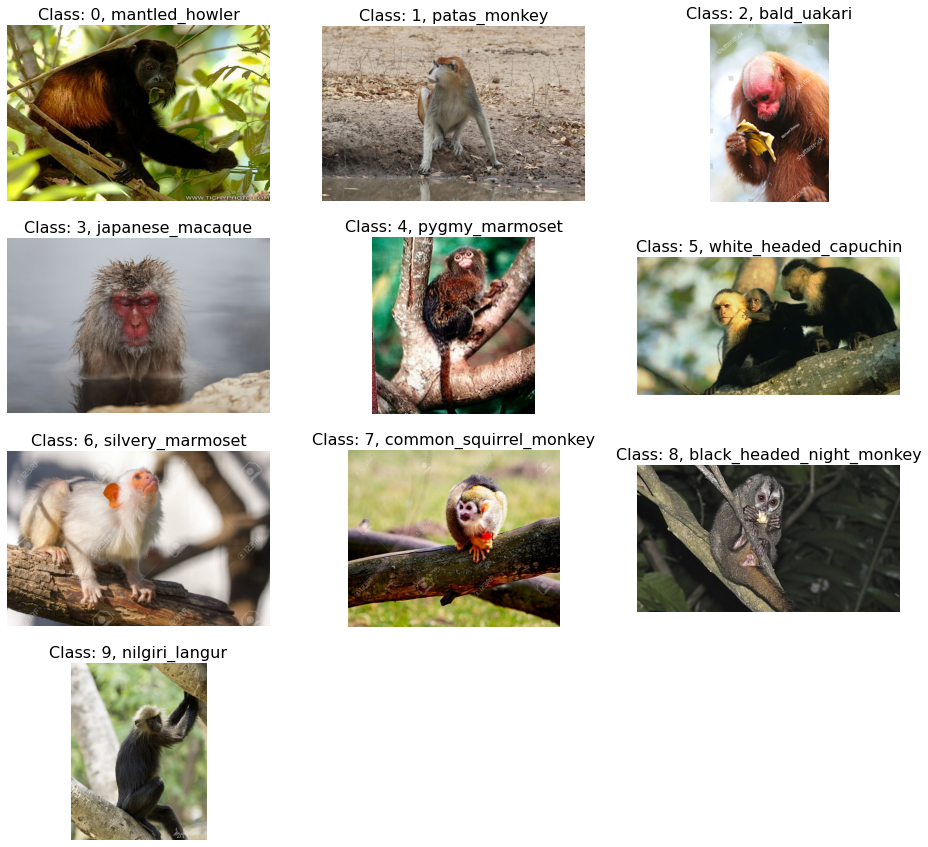

In [ ]:
imgs = []
for i in range(10):
    file = os.listdir(f'monkeys10/training/training/n%d'%i)
    img = plt.imread(f'monkeys10/training/training/n%d/{file[0]}'%i)
    imgs.append(img)

plots(imgs, titles=labels_name, rows=4, figsize=(16,15))

# 1) 기본 CNN - 0604코드 완료 - 돌려보기

In [ ]:
# image generator로 rescale만 하고 새로만들진 않음.
train_datagen=ImageDataGenerator(rescale=1./255)
validation_datagen=ImageDataGenerator(rescale=1./255)
train_generator=train_datagen.flow_from_directory(train_dir,target_size=(150,150),
                                              batch_size=16, class_mode='categorical')
validation_generator=train_datagen.flow_from_directory(validation_dir,target_size=(150,150),
                                              batch_size=16, class_mode='categorical')

Found 1098 images belonging to 10 classes.
Found 272 images belonging to 10 classes.


## 1st

acc: 0.8202 - val_loss: 1.0558 - val_acc: 0.6641

In [ ]:

model=Sequential()
model.add(Conv2D(32,(3,3),activation='relu',input_shape=[150,150,3]))
model.add(MaxPooling2D((2,2)))
model.add(Conv2D(64,(3,3),activation='relu',padding='same'))
model.add(MaxPooling2D((2,2)))
model.add(Conv2D(128,(3,3),activation='relu',padding='same'))
model.add(MaxPooling2D((2,2)))
model.add(Conv2D(256,(3,3),activation='relu',padding='same'))
model.add(Flatten())
model.add(Dense(100,activation='relu'))
model.add(Dense(10,activation='softmax'))
model.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_5 (Conv2D)            (None, 148, 148, 32)      896       
_________________________________________________________________
max_pooling2d_4 (MaxPooling2 (None, 74, 74, 32)        0         
_________________________________________________________________
conv2d_6 (Conv2D)            (None, 74, 74, 64)        18496     
_________________________________________________________________
max_pooling2d_5 (MaxPooling2 (None, 37, 37, 64)        0         
_________________________________________________________________
conv2d_7 (Conv2D)            (None, 37, 37, 128)       73856     
_________________________________________________________________
max_pooling2d_6 (MaxPooling2 (None, 18, 18, 128)       0         
_________________________________________________________________
conv2d_8 (Conv2D)            (None, 18, 18, 256)      

In [ ]:
from keras import optimizers
model.compile(loss='categorical_crossentropy', optimizer=optimizers.RMSprop(lr=1e-4),metrics=['acc'])
result=model.fit_generator(train_generator,steps_per_epoch=64,epochs=10,validation_data=validation_generator,validation_steps=16)

Epoch 1/10
64/64 [==============================] - 365s 6s/step - loss: 2.2125 - acc: 0.2033 - val_loss: 2.1563 - val_acc: 0.2812
Epoch 2/10
64/64 [==============================] - 96s 2s/step - loss: 1.7977 - acc: 0.3821 - val_loss: 1.7140 - val_acc: 0.3477
Epoch 3/10
64/64 [==============================] - 90s 1s/step - loss: 1.5183 - acc: 0.4823 - val_loss: 1.6643 - val_acc: 0.5156
Epoch 4/10
64/64 [==============================] - 90s 1s/step - loss: 1.2331 - acc: 0.5766 - val_loss: 1.5628 - val_acc: 0.4531
Epoch 5/10
64/64 [==============================] - 90s 1s/step - loss: 1.1329 - acc: 0.6277 - val_loss: 1.4333 - val_acc: 0.5742
Epoch 6/10
64/64 [==============================] - 90s 1s/step - loss: 0.9488 - acc: 0.6992 - val_loss: 1.3595 - val_acc: 0.6133
Epoch 7/10
64/64 [==============================] - 88s 1s/step - loss: 0.8321 - acc: 0.7154 - val_loss: 1.1702 - val_acc: 0.6094
Epoch 8/10
64/64 [==============================] - 89s 1s/step - loss: 0.7392 - acc: 0.7

## 2nd

cc: 0.9219 - val_loss: 1.2275 - val_acc: 0.6367

In [ ]:

model2=Sequential()
model2.add(Conv2D(32,(3,3),activation='relu',input_shape=[150,150,3]))
model2.add(MaxPooling2D((2,2)))
model2.add(Conv2D(64,(3,3),activation='relu',padding='same'))
model2.add(MaxPooling2D((2,2)))
model2.add(Conv2D(128,(3,3),activation='relu',padding='same'))
model2.add(MaxPooling2D((2,2)))
model2.add(Conv2D(256,(3,3),activation='relu',padding='same'))
model2.add(Flatten())
model2.add(Dense(1000,activation='relu'))
model2.add(Dense(100,activation='relu'))
model2.add(Dense(10,activation='softmax'))
model2.summary()

from keras import optimizers
model2.compile(loss='categorical_crossentropy', optimizer=optimizers.RMSprop(lr=1e-4),metrics=['acc'])
result2=model2.fit_generator(train_generator,steps_per_epoch=64,epochs=10,validation_data=validation_generator,validation_steps=16)

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_9 (Conv2D)            (None, 148, 148, 32)      896       
_________________________________________________________________
max_pooling2d_7 (MaxPooling2 (None, 74, 74, 32)        0         
_________________________________________________________________
conv2d_10 (Conv2D)           (None, 74, 74, 64)        18496     
_________________________________________________________________
max_pooling2d_8 (MaxPooling2 (None, 37, 37, 64)        0         
_________________________________________________________________
conv2d_11 (Conv2D)           (None, 37, 37, 128)       73856     
_________________________________________________________________
max_pooling2d_9 (MaxPooling2 (None, 18, 18, 128)       0         
_________________________________________________________________
conv2d_12 (Conv2D)           (None, 18, 18, 256)      

## 3rd

- acc: 0.6006 - val_loss: 1.9599 - val_acc: 0.4688

In [ ]:

model3=Sequential()
model3.add(Conv2D(32,(3,3),activation='relu',input_shape=[150,150,3]))
model3.add(Dropout(0.5))
model3.add(MaxPooling2D((2,2)))
model3.add(Conv2D(64,(3,3),activation='relu',padding='same'))
model3.add(Dropout(0.5))
model3.add(MaxPooling2D((2,2)))
model3.add(Conv2D(128,(3,3),activation='relu',padding='same'))
model3.add(Dropout(0.5))
model3.add(MaxPooling2D((2,2)))
model3.add(Conv2D(256,(3,3),activation='relu',padding='same'))
model3.add(Dropout(0.5))
model3.add(Flatten())
model3.add(Dense(100,activation='relu'))
model3.add(Dropout(0.5))
model3.add(Dense(10,activation='softmax'))
model3.summary()

from keras import optimizers
model3.compile(loss='categorical_crossentropy', optimizer=optimizers.RMSprop(lr=1e-4),metrics=['acc'])
#result1=model3.fit_generator(train_generator,steps_per_epoch=64,epochs=10,validation_data=validation_generator,validation_steps=16)
result3=model3.fit_generator(train_generator,steps_per_epoch=64,epochs=10,validation_data=validation_generator,validation_steps=16)

Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_13 (Conv2D)           (None, 148, 148, 32)      896       
_________________________________________________________________
dropout_1 (Dropout)          (None, 148, 148, 32)      0         
_________________________________________________________________
max_pooling2d_10 (MaxPooling (None, 74, 74, 32)        0         
_________________________________________________________________
conv2d_14 (Conv2D)           (None, 74, 74, 64)        18496     
_________________________________________________________________
dropout_2 (Dropout)          (None, 74, 74, 64)        0         
_________________________________________________________________
max_pooling2d_11 (MaxPooling (None, 37, 37, 64)        0         
_________________________________________________________________
conv2d_15 (Conv2D)           (None, 37, 37, 128)      

## 4th

acc: 0.5361 - val_loss: 1.7940 - val_acc: 0.5742

In [ ]:

model4=Sequential()
model4.add(Conv2D(32,(2,2),activation='relu',input_shape=[150,150,3]))
model4.add(Dropout(0.3))
model4.add(MaxPooling2D((3,3)))
model4.add(Conv2D(64,(2,2),activation='relu',padding='same'))
model4.add(Dropout(0.3))
model4.add(MaxPooling2D((3,3)))
model4.add(Conv2D(128,(2,2),activation='relu',padding='same'))
model4.add(Dropout(0.3))
model4.add(MaxPooling2D((3,3)))
model4.add(Conv2D(256,(2,2),activation='relu',padding='same'))
model4.add(Dropout(0.3))
model4.add(Flatten())
model4.add(Dense(100,activation='relu'))
model4.add(Dropout(0.3))
model4.add(Dense(10,activation='softmax'))
model4.summary()

from keras import optimizers
model4.compile(loss='categorical_crossentropy', optimizer=optimizers.RMSprop(lr=1e-4),metrics=['acc'])
result4=model4.fit_generator(train_generator,steps_per_epoch=64,epochs=10,validation_data=validation_generator,validation_steps=16)


Model: "sequential_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_17 (Conv2D)           (None, 149, 149, 32)      416       
_________________________________________________________________
dropout_6 (Dropout)          (None, 149, 149, 32)      0         
_________________________________________________________________
max_pooling2d_13 (MaxPooling (None, 49, 49, 32)        0         
_________________________________________________________________
conv2d_18 (Conv2D)           (None, 49, 49, 64)        8256      
_________________________________________________________________
dropout_7 (Dropout)          (None, 49, 49, 64)        0         
_________________________________________________________________
max_pooling2d_14 (MaxPooling (None, 16, 16, 64)        0         
_________________________________________________________________
conv2d_19 (Conv2D)           (None, 16, 16, 128)      

## 5th

acc: 0.7377 - val_loss: 1.5400 - val_acc: 0.6250

In [ ]:
model5=Sequential()
model5.add(Conv2D(32,(2,2),activation='relu',input_shape=[150,150,3]))
model5.add(Dropout(0.3))
model5.add(MaxPooling2D((2,2)))
model5.add(Conv2D(64,(2,2),activation='relu',padding='same'))
model5.add(Dropout(0.3))
model5.add(MaxPooling2D((3,3)))
model5.add(Conv2D(128,(2,2),activation='relu',padding='same'))
model5.add(Dropout(0.3))
model5.add(MaxPooling2D((2,2)))
model5.add(Conv2D(256,(2,2),activation='relu',padding='same'))
model5.add(Dropout(0.3))
model5.add(Flatten())
model5.add(Dense(100,activation='relu'))
model5.add(Dense(10,activation='softmax'))
model5.summary()

from keras import optimizers
model5.compile(loss='categorical_crossentropy', optimizer=optimizers.RMSprop(lr=1e-4),metrics=['acc'])
result5=model5.fit_generator(train_generator,steps_per_epoch=64,epochs=10,validation_data=validation_generator,validation_steps=16)


Model: "sequential_9"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_33 (Conv2D)           (None, 149, 149, 32)      416       
_________________________________________________________________
dropout_24 (Dropout)         (None, 149, 149, 32)      0         
_________________________________________________________________
max_pooling2d_25 (MaxPooling (None, 74, 74, 32)        0         
_________________________________________________________________
conv2d_34 (Conv2D)           (None, 74, 74, 64)        8256      
_________________________________________________________________
dropout_25 (Dropout)         (None, 74, 74, 64)        0         
_________________________________________________________________
max_pooling2d_26 (MaxPooling (None, 24, 24, 64)        0         
_________________________________________________________________
conv2d_35 (Conv2D)           (None, 24, 24, 128)      

# 2) 이전학습 VGG - 0604코드 완료 - 돌려보기

In [ ]:
# image generator로 rescale만 하고 새로만들진 않음.
train_datagen=ImageDataGenerator(rescale=1./255)
validation_datagen=ImageDataGenerator(rescale=1./255)
train_generator=train_datagen.flow_from_directory(train_dir,target_size=(150,150),
                                              batch_size=16, class_mode='categorical')
validation_generator=train_datagen.flow_from_directory(validation_dir,target_size=(150,150),
                                              batch_size=16, class_mode='categorical')

Found 1098 images belonging to 10 classes.
Found 272 images belonging to 10 classes.


In [ ]:
from keras.callbacks import ReduceLROnPlateau
STEP_SIZE_TRAIN=train_generator.n//train_generator.batch_size
STEP_SIZE_VALID=validation_generator.n//validation_generator.batch_size

learning_rate_reduction = ReduceLROnPlateau(monitor='val_accuracy', # 검증 정확도를 기준으로 call back 호출ㄹ
                                            patience=2,   # epoch2동안 개선 되지 않으면 call back호출
                                            verbose=1, 
                                            factor=0.5, # callback호출시 학습률을 1/2로 줄임
                                            min_lr=0.00001)

In [ ]:
from keras.applications import VGG16
vgg_base=VGG16(weights='imagenet',include_top=False, input_shape=(150,150,3))
vgg_base.summary()

## 2-1) 이전학습 VGGVGG16 미세조정 X

#### 1st - optimizer는 adam으로 하자. RMSprop으로 하면 터짐

accuracy: 1.0000 - val_loss: 0.3165 - val_accuracy: 0.7941

In [ ]:
# 이건 대체 뭐야 왜 잘나옴?
# vgg16_model = vgg16.VGG16(weights='imagenet')
# for layer in vgg16_model.layers[:-1]:
    #model2.add(layer)
model = Sequential()
for layer in vgg_base.layers[:-1]:
  model.add(layer)

for layer in model.layers:
  layer.trainable = False

model.add(Flatten())
model.add(Dense(10, activation='softmax'))
model.compile(optimizer=optimizers.RMSprop(lr=2e-5), loss='categorical_crossentropy', metrics=['accuracy'])
model.fit_generator(generator=train_generator,
                    steps_per_epoch=STEP_SIZE_TRAIN,
                    validation_data=validation_generator,
                    validation_steps=STEP_SIZE_VALID,
                    epochs=10,
                    verbose=1,
                    callbacks=[learning_rate_reduction]
  )

Epoch 1/10
68/68 [==============================] - 332s 5s/step - loss: 1.7946 - accuracy: 0.4750 - val_loss: 0.8237 - val_accuracy: 0.6838
Epoch 2/10


/usr/local/lib/python3.6/dist-packages/keras/callbacks/callbacks.py:1042: RuntimeWarning: Reduce LR on plateau conditioned on metric `val_acc` which is not available. Available metrics are: val_loss,val_accuracy,loss,accuracy,lr
  (self.monitor, ','.join(list(logs.keys()))), RuntimeWarning


68/68 [==============================] - 333s 5s/step - loss: 0.2557 - accuracy: 0.9233 - val_loss: 1.2824 - val_accuracy: 0.6507
Epoch 3/10
68/68 [==============================] - 334s 5s/step - loss: 0.0630 - accuracy: 0.9936 - val_loss: 0.5739 - val_accuracy: 0.7794
Epoch 4/10
68/68 [==============================] - 333s 5s/step - loss: 0.0247 - accuracy: 1.0000 - val_loss: 0.4703 - val_accuracy: 0.7647
Epoch 5/10
68/68 [==============================] - 330s 5s/step - loss: 0.0142 - accuracy: 1.0000 - val_loss: 0.3909 - val_accuracy: 0.7831
Epoch 6/10
68/68 [==============================] - 335s 5s/step - loss: 0.0110 - accuracy: 1.0000 - val_loss: 0.4654 - val_accuracy: 0.7831
Epoch 7/10
68/68 [==============================] - 332s 5s/step - loss: 0.0087 - accuracy: 1.0000 - val_loss: 0.6467 - val_accuracy: 0.7684
Epoch 8/10
68/68 [==============================] - 332s 5s/step - loss: 0.0071 - accuracy: 1.0000 - val_loss: 0.3225 - val_accuracy: 0.7721
Epoch 9/10
68/68 [======

In [ ]:
model_tran = Sequential()
for layer in vgg_base.layers[:]:
  model_tran.add(layer)

for layer in model_tran.layers:
  layer.trainable = False
  
model_tran.add(Flatten())
model_tran.add(Dense(10, activation='softmax'))
model_tran.summary()

model_tran.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model_tran.fit_generator(generator=train_generator,
                        steps_per_epoch=STEP_SIZE_TRAIN,
                        validation_data=validation_generator,
                        validation_steps=STEP_SIZE_VALID,
                        epochs=10,
                        verbose=1,
                        callbacks=[learning_rate_reduction])

Model: "sequential_34"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
block1_conv1 (Conv2D)        (None, 150, 150, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 150, 150, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 75, 75, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 75, 75, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 75, 75, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 37, 37, 128)       0         
_________________________________________________________________
block3_conv1 (Conv2D)        (None, 37, 37, 256)     

/usr/local/lib/python3.6/dist-packages/keras/callbacks/callbacks.py:1042: RuntimeWarning: Reduce LR on plateau conditioned on metric `val_acc` which is not available. Available metrics are: val_loss,val_accuracy,loss,accuracy,lr
  (self.monitor, ','.join(list(logs.keys()))), RuntimeWarning


68/68 [==============================] - 331s 5s/step - loss: 0.6196 - accuracy: 0.8484 - val_loss: 0.9409 - val_accuracy: 0.7243
Epoch 3/10
68/68 [==============================] - 328s 5s/step - loss: 0.3306 - accuracy: 0.9436 - val_loss: 0.7411 - val_accuracy: 0.7316
Epoch 4/10
68/68 [==============================] - 334s 5s/step - loss: 0.2210 - accuracy: 0.9741 - val_loss: 0.7924 - val_accuracy: 0.7757
Epoch 5/10
68/68 [==============================] - 337s 5s/step - loss: 0.1429 - accuracy: 0.9963 - val_loss: 0.4817 - val_accuracy: 0.7757
Epoch 6/10
68/68 [==============================] - 339s 5s/step - loss: 0.0983 - accuracy: 0.9972 - val_loss: 0.9516 - val_accuracy: 0.7904
Epoch 7/10
68/68 [==============================] - 332s 5s/step - loss: 0.0772 - accuracy: 1.0000 - val_loss: 0.5898 - val_accuracy: 0.7941
Epoch 8/10
68/68 [==============================] - 338s 5s/step - loss: 0.0575 - accuracy: 1.0000 - val_loss: 0.8806 - val_accuracy: 0.7868
Epoch 9/10
68/68 [======

#### 2nd

acc: 0.5518 - val_loss: 1.0941 - val_acc: 0.7463

In [ ]:
from keras.models import Sequential
from keras.layers import Flatten, Dense

model2_tran=Sequential()
for layer in vgg_base.layers[:]:
  model2_tran.add(layer)

for layer in model2_tran.layers:
  layer.trainable = False

model2_tran.add(Flatten())
model2_tran.add(Dense(256, activation='relu'))
model2_tran.add(Dropout(0.7))
model2_tran.add(Dense(10, activation='softmax'))
model2_tran.summary()

model2_tran.compile(optimizer='adam',loss='categorical_crossentropy',metrics=['acc'])
model2_tran.fit_generator(generator=train_generator,
                    steps_per_epoch=STEP_SIZE_TRAIN,
                    validation_data=validation_generator,
                    validation_steps=STEP_SIZE_VALID,
                    epochs=10,
                    verbose=1,
                    callbacks=[learning_rate_reduction]
                    )

Model: "sequential_35"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
block1_conv1 (Conv2D)        (None, 150, 150, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 150, 150, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 75, 75, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 75, 75, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 75, 75, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 37, 37, 128)       0         
_________________________________________________________________
block3_conv1 (Conv2D)        (None, 37, 37, 256)     

#### 3rd

accuracy: 0.9824 - val_loss: 0.8588 - val_accuracy: 0.7831

In [ ]:
model_tran = Sequential()
for layer in vgg_base.layers[:]:
  model_tran.add(layer)

for layer in model_tran.layers:
  layer.trainable = False
  
model_tran.add(Flatten())
model_tran.add(Dropout(0.5))
model_tran.add(Dense(10, activation='softmax'))
model_tran.summary()

model_tran.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model_tran.fit_generator(generator=train_generator,
                        steps_per_epoch=STEP_SIZE_TRAIN,
                        validation_data=validation_generator,
                        validation_steps=STEP_SIZE_VALID,
                        epochs=10,
                        verbose=1,
                        callbacks=[learning_rate_reduction])

Model: "sequential_36"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
block1_conv1 (Conv2D)        (None, 150, 150, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 150, 150, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 75, 75, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 75, 75, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 75, 75, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 37, 37, 128)       0         
_________________________________________________________________
block3_conv1 (Conv2D)        (None, 37, 37, 256)     

#### 4th

accuracy: 0.9067 - val_loss: 0.6799 - val_accuracy: 0.7831

In [ ]:
model4_tran = Sequential()
for layer in vgg_base.layers[:]:
  model4_tran.add(layer)

for layer in model4_tran.layers:
  layer.trainable = False
  
model4_tran.add(Flatten())
model4_tran.add(Dense(256, activation='relu'))
model4_tran.add(Dropout(0.5))
model4_tran.add(Dense(10, activation='softmax'))
model4_tran.summary()
  
model4_tran.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model4_tran.fit_generator(generator=train_generator,
                           steps_per_epoch=STEP_SIZE_TRAIN,
                           validation_data=validation_generator,
                           validation_steps=STEP_SIZE_VALID,
                           epochs=10,
                           verbose=1,
                           callbacks=[learning_rate_reduction])

Model: "sequential_37"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
block1_conv1 (Conv2D)        (None, 150, 150, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 150, 150, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 75, 75, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 75, 75, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 75, 75, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 37, 37, 128)       0         
_________________________________________________________________
block3_conv1 (Conv2D)        (None, 37, 37, 256)     

#### 5th

accuracy: 0.9325 - val_loss: 0.3610 - val_accuracy: 0.7757

In [ ]:
model5_tran = Sequential()
for layer in vgg_base.layers[:]:
  model5_tran.add(layer)

for layer in model5_tran.layers:
  layer.trainable = False
  
model5_tran.add(Flatten())
model5_tran.add(Dropout(0.4))
model5_tran.add(Dense(256, activation='relu'))
model5_tran.add(Dropout(0.4))
model5_tran.add(Dense(10, activation='softmax'))
model5_tran.summary()

model5_tran.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model5_tran.fit_generator(generator=train_generator,
                          steps_per_epoch=STEP_SIZE_TRAIN,
                          validation_data=validation_generator,
                          validation_steps=STEP_SIZE_VALID,
                          epochs=10,
                          verbose=1,
                          callbacks=[learning_rate_reduction])

Model: "sequential_39"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
block1_conv1 (Conv2D)        (None, 150, 150, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 150, 150, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 75, 75, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 75, 75, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 75, 75, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 37, 37, 128)       0         
_________________________________________________________________
block3_conv1 (Conv2D)        (None, 37, 37, 256)     

#### 6th

accuracy: 0.7994 - val_loss: 0.3470 - val_accuracy: 0.7757

In [ ]:
model6_tran = Sequential()
for layer in vgg_base.layers[:]:
  model6_tran.add(layer)

for layer in model6_tran.layers:
  layer.trainable = False


model6_tran.add(Flatten())
model6_tran.add(Dense(256, activation='relu'))
model6_tran.add(Dropout(0.6))
model6_tran.add(Dense(10, activation='softmax'))
model6_tran.summary()
  
model6_tran.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model6_tran.fit_generator(generator=train_generator,
                          steps_per_epoch=STEP_SIZE_TRAIN,
                          validation_data=validation_generator,
                          validation_steps=STEP_SIZE_VALID,
                          epochs=10,
                          verbose=1,
                          callbacks=[learning_rate_reduction])

Model: "sequential_40"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
block1_conv1 (Conv2D)        (None, 150, 150, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 150, 150, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 75, 75, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 75, 75, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 75, 75, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 37, 37, 128)       0         
_________________________________________________________________
block3_conv1 (Conv2D)        (None, 37, 37, 256)     

## 2-2) 이전학습 VGGVGG16 미세조정 O 

#### 1st

 RMSprop

In [ ]:
vgg_base.trainable=True
trainable_layer=False
for layer in vgg_base.layers:
    if layer.name=='block5_conv1': # block5_conv1부터 trainable_layer가 True로 layer.trainable이 True로 바뀜
        trainable_layer=True
    if trainable_layer:
        layer.trainable=True
    else:
        layer.trainable=False

In [ ]:
from keras.models import Sequential
from keras.layers import Flatten, Dense
from keras import optimizers
model_aug=Sequential()
model_aug.add(vgg_base)
model_aug.add(Flatten())
model_aug.add(Dense(256,activation='relu'))
model_aug.add(Dropout(0.6))
model_aug.add(Dense(10,activation='softmax'))
model_aug.summary()

model_aug.compile(optimizer=optimizers.RMSprop(lr=2e-5), loss='categorical_crossentropy', metrics=['accuracy'])
model_aug.fit_generator(generator=train_generator,
                          steps_per_epoch=STEP_SIZE_TRAIN,
                          validation_data=validation_generator,
                          validation_steps=STEP_SIZE_VALID,
                          epochs=10,
                          verbose=1,
                          callbacks=[learning_rate_reduction])

Model: "sequential_42"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg16 (Model)                (None, 4, 4, 512)         14714688  
_________________________________________________________________
flatten_33 (Flatten)         (None, 8192)              0         
_________________________________________________________________
dense_67 (Dense)             (None, 256)               2097408   
_________________________________________________________________
dropout_49 (Dropout)         (None, 256)               0         
_________________________________________________________________
dense_68 (Dense)             (None, 10)                2570      
Total params: 16,814,666
Trainable params: 9,179,402
Non-trainable params: 7,635,264
_________________________________________________________________
Epoch 1/10
68/68 [==============================] - 377s 6s/step - loss: 2.3026 - accuracy: 0.0850 -

KeyboardInterrupt: ignored

#### 2nd 

adam

In [ ]:
from keras.models import Sequential
from keras.layers import Flatten, Dense
from keras import optimizers
model_aug=Sequential()
model_aug.add(vgg_base)
model_aug.add(Flatten())
model_aug.add(Dense(256,activation='relu'))
model_aug.add(Dropout(0.6))
model_aug.add(Dense(10,activation='softmax'))
model_aug.summary()

model_aug.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model_aug.fit_generator(generator=train_generator,
                          steps_per_epoch=STEP_SIZE_TRAIN,
                          validation_data=validation_generator,
                          validation_steps=STEP_SIZE_VALID,
                          epochs=10,
                          verbose=1,
                          callbacks=[learning_rate_reduction])

Model: "sequential_41"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg16 (Model)                (None, 4, 4, 512)         14714688  
_________________________________________________________________
flatten_32 (Flatten)         (None, 8192)              0         
_________________________________________________________________
dense_65 (Dense)             (None, 256)               2097408   
_________________________________________________________________
dropout_48 (Dropout)         (None, 256)               0         
_________________________________________________________________
dense_66 (Dense)             (None, 10)                2570      
Total params: 16,814,666
Trainable params: 9,179,402
Non-trainable params: 7,635,264
_________________________________________________________________
Epoch 1/10
68/68 [==============================] - 375s 6s/step - loss: 2.3426 - accuracy: 0.1017 -

KeyboardInterrupt: ignored

#### 4th

adam train block5 conv3부터

drop 0.6

accuracy: 0.9963 - val_loss: 0.8351 - val_accuracy: 0.8419

In [ ]:
vgg_base.trainable=True
trainable_layer=False
for layer in vgg_base.layers:
    if layer.name=='block5_conv3': # block5_conv1부터 trainable_layer가 True로 layer.trainable이 True로 바뀜
        trainable_layer=True
    if trainable_layer:
        layer.trainable=True
    else:
        layer.trainable=False

In [ ]:
from keras.models import Sequential
from keras.layers import Flatten, Dense
from keras import optimizers
model_aug=Sequential()
model_aug.add(vgg_base)
model_aug.add(Flatten())
model_aug.add(Dense(256,activation='relu'))
model_aug.add(Dropout(0.6))
model_aug.add(Dense(10,activation='softmax'))
model_aug.summary()

model_aug.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model_aug.fit_generator(generator=train_generator,
                          steps_per_epoch=STEP_SIZE_TRAIN,
                          validation_data=validation_generator,
                          validation_steps=STEP_SIZE_VALID,
                          epochs=10,
                          verbose=1,
                          callbacks=[learning_rate_reduction])

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg16 (Model)                (None, 4, 4, 512)         14714688  
_________________________________________________________________
flatten_1 (Flatten)          (None, 8192)              0         
_________________________________________________________________
dense_1 (Dense)              (None, 256)               2097408   
_________________________________________________________________
dropout_1 (Dropout)          (None, 256)               0         
_________________________________________________________________
dense_2 (Dense)              (None, 10)                2570      
Total params: 16,814,666
Trainable params: 4,459,786
Non-trainable params: 12,354,880
_________________________________________________________________
Epoch 1/10
68/68 [==============================] - 334s 5s/step - loss: 2.2233 - accuracy: 0.2384 -

#### 5th
drop 0.8 block5 conv3

accuracy: 0.9972 - val_loss: 1.4350 - val_accuracy: 0.8235


In [ ]:
vgg_base.trainable=True
trainable_layer=False
for layer in vgg_base.layers:
    if layer.name=='block5_conv3': # block5_conv1부터 trainable_layer가 True로 layer.trainable이 True로 바뀜
        trainable_layer=True
    if trainable_layer:
        layer.trainable=True
    else:
        layer.trainable=False

In [ ]:
from keras.models import Sequential
from keras.layers import Flatten, Dense
from keras import optimizers
model_aug=Sequential()
model_aug.add(vgg_base)
model_aug.add(Flatten())
model_aug.add(Dense(256,activation='relu'))
model_aug.add(Dropout(0.8))
model_aug.add(Dense(10,activation='softmax'))
model_aug.summary()

model_aug.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model_aug.fit_generator(generator=train_generator,
                          steps_per_epoch=STEP_SIZE_TRAIN,
                          validation_data=validation_generator,
                          validation_steps=STEP_SIZE_VALID,
                          epochs=10,
                          verbose=1,
                          callbacks=[learning_rate_reduction])

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg16 (Model)                (None, 4, 4, 512)         14714688  
_________________________________________________________________
flatten_2 (Flatten)          (None, 8192)              0         
_________________________________________________________________
dense_3 (Dense)              (None, 256)               2097408   
_________________________________________________________________
dropout_2 (Dropout)          (None, 256)               0         
_________________________________________________________________
dense_4 (Dense)              (None, 10)                2570      
Total params: 16,814,666
Trainable params: 4,459,786
Non-trainable params: 12,354,880
_________________________________________________________________
Epoch 1/10
68/68 [==============================] - 42s 612ms/step - loss: 1.1155 - accuracy: 0.6349

#### 6th
'block5_conv2' 부터 학습시켜봄 - 처참해서 삭제됨

drop 0.4, 0.6

 accuracy: 0.9945 - val_loss: 1.1798 - val_accuracy: 0.8309


In [ ]:
'''vgg_base.trainable=True
trainable_layer=False
for layer in vgg_base.layers:
    if layer.name=='block5_conv2': # block5_conv1부터 trainable_layer가 True로 layer.trainable이 True로 바뀜
        trainable_layer=True
    if trainable_layer:
        layer.trainable=True
    else:
        layer.trainable=False
        '''

In [ ]:
vgg_base.trainable=True
trainable_layer=False
for layer in vgg_base.layers:
    if layer.name=='block5_conv3': # block5_conv1부터 trainable_layer가 True로 layer.trainable이 True로 바뀜
        trainable_layer=True
    if trainable_layer:
        layer.trainable=True
    else:
        layer.trainable=False

In [ ]:
from keras.models import Sequential
from keras.layers import Flatten, Dense
from keras import optimizers
model_aug=Sequential()
model_aug.add(vgg_base)
model_aug.add(Flatten())
model_aug.add(Dropout(0.4))
model_aug.add(Dense(256,activation='relu'))
model_aug.add(Dropout(0.6))
model_aug.add(Dense(10,activation='softmax'))
model_aug.summary()

model_aug.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model_aug.fit_generator(generator=train_generator,
                          steps_per_epoch=STEP_SIZE_TRAIN,
                          validation_data=validation_generator,
                          validation_steps=STEP_SIZE_VALID,
                          epochs=10,
                          verbose=1,
                          callbacks=[learning_rate_reduction])

Model: "sequential_11"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg16 (Model)                (None, 4, 4, 512)         14714688  
_________________________________________________________________
flatten_11 (Flatten)         (None, 8192)              0         
_________________________________________________________________
dropout_14 (Dropout)         (None, 8192)              0         
_________________________________________________________________
dense_21 (Dense)             (None, 256)               2097408   
_________________________________________________________________
dropout_15 (Dropout)         (None, 256)               0         
_________________________________________________________________
dense_22 (Dense)             (None, 10)                2570      
Total params: 16,814,666
Trainable params: 4,459,786
Non-trainable params: 12,354,880
_________________________________

#### 7th

'block5_conv3' 부터 학습

drop 0.6/0.7

0.9667 - val_loss: 1.8276 - val_accuracy: 0.7978



In [ ]:
from keras.models import Sequential
from keras.layers import Flatten, Dense
from keras import optimizers
model_aug=Sequential()
model_aug.add(vgg_base)
model_aug.add(Flatten())
model_aug.add(Dropout(0.6))
model_aug.add(Dense(256,activation='relu'))
model_aug.add(Dropout(0.7))
model_aug.add(Dense(10,activation='softmax'))
model_aug.summary()

model_aug.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model_aug.fit_generator(generator=train_generator,
                          steps_per_epoch=STEP_SIZE_TRAIN,
                          validation_data=validation_generator,
                          validation_steps=STEP_SIZE_VALID,
                          epochs=10,
                          verbose=1,
                          callbacks=[learning_rate_reduction])

Model: "sequential_12"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg16 (Model)                (None, 4, 4, 512)         14714688  
_________________________________________________________________
flatten_12 (Flatten)         (None, 8192)              0         
_________________________________________________________________
dropout_16 (Dropout)         (None, 8192)              0         
_________________________________________________________________
dense_23 (Dense)             (None, 256)               2097408   
_________________________________________________________________
dropout_17 (Dropout)         (None, 256)               0         
_________________________________________________________________
dense_24 (Dense)             (None, 10)                2570      
Total params: 16,814,666
Trainable params: 4,459,786
Non-trainable params: 12,354,880
_________________________________

#### 8th

**'block5_conv3**' 부터 학습
drop 0.8/0.9

 0.6922 - val_loss: 0.6828 - val_accuracy: 0.7353


In [ ]:
from keras.models import Sequential
from keras.layers import Flatten, Dense
from keras import optimizers
model_aug=Sequential()
model_aug.add(vgg_base)
model_aug.add(Flatten())
model_aug.add(Dropout(0.8))
model_aug.add(Dense(256,activation='relu'))
model_aug.add(Dropout(0.9))
model_aug.add(Dense(10,activation='softmax'))
model_aug.summary()

model_aug.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model_aug.fit_generator(generator=train_generator,
                          steps_per_epoch=STEP_SIZE_TRAIN,
                          validation_data=validation_generator,
                          validation_steps=STEP_SIZE_VALID,
                          epochs=10,
                          verbose=1,
                          callbacks=[learning_rate_reduction])

Model: "sequential_13"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg16 (Model)                (None, 4, 4, 512)         14714688  
_________________________________________________________________
flatten_13 (Flatten)         (None, 8192)              0         
_________________________________________________________________
dropout_18 (Dropout)         (None, 8192)              0         
_________________________________________________________________
dense_25 (Dense)             (None, 256)               2097408   
_________________________________________________________________
dropout_19 (Dropout)         (None, 256)               0         
_________________________________________________________________
dense_26 (Dense)             (None, 10)                2570      
Total params: 16,814,666
Trainable params: 4,459,786
Non-trainable params: 12,354,880
_________________________________

#### 9th

256 dense 없이 바로 연결

drop 0.8

accuracy: 0.9338 - val_loss: 1.6129 - val_accuracy: 0.8199


In [ ]:
from keras.models import Sequential
from keras.layers import Flatten, Dense
from keras import optimizers
model_aug=Sequential()
model_aug.add(vgg_base)
model_aug.add(Flatten())
model_aug.add(Dropout(0.8))
model_aug.add(Dense(10,activation='softmax'))
model_aug.summary()

model_aug.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model_aug.fit_generator(generator=train_generator,
                          steps_per_epoch=STEP_SIZE_TRAIN,
                          validation_data=validation_generator,
                          validation_steps=STEP_SIZE_VALID,
                          epochs=10,
                          verbose=1,
                          callbacks=[learning_rate_reduction])

Model: "sequential_14"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg16 (Model)                (None, 4, 4, 512)         14714688  
_________________________________________________________________
flatten_14 (Flatten)         (None, 8192)              0         
_________________________________________________________________
dropout_20 (Dropout)         (None, 8192)              0         
_________________________________________________________________
dense_27 (Dense)             (None, 10)                81930     
Total params: 14,796,618
Trainable params: 2,441,738
Non-trainable params: 12,354,880
_________________________________________________________________
Epoch 1/10
68/68 [==============================] - 41s 600ms/step - loss: 1.5887 - accuracy: 0.4492 - val_loss: 0.8412 - val_accuracy: 0.7574
Epoch 2/10
68/68 [==============================] - 41s 602ms/step - loss: 0.7777 - accu

#### 10th

'block5_conv3' 부터 학습

drop 0.8/0.7

accuracy: 0.9200 - val_loss: 0.4004 - val_accuracy: 0.8199

In [ ]:
from keras.models import Sequential
from keras.layers import Flatten, Dense
from keras import optimizers
model_aug=Sequential()
model_aug.add(vgg_base)
model_aug.add(Flatten())
model_aug.add(Dropout(0.8))
model_aug.add(Dense(256,activation='relu'))
model_aug.add(Dropout(0.7))
model_aug.add(Dense(10,activation='softmax'))
model_aug.summary()

model_aug.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model_aug.fit_generator(generator=train_generator,
                          steps_per_epoch=STEP_SIZE_TRAIN,
                          validation_data=validation_generator,
                          validation_steps=STEP_SIZE_VALID,
                          epochs=10,
                          verbose=1,
                          callbacks=[learning_rate_reduction])

Model: "sequential_15"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg16 (Model)                (None, 4, 4, 512)         14714688  
_________________________________________________________________
flatten_15 (Flatten)         (None, 8192)              0         
_________________________________________________________________
dropout_21 (Dropout)         (None, 8192)              0         
_________________________________________________________________
dense_28 (Dense)             (None, 256)               2097408   
_________________________________________________________________
dropout_22 (Dropout)         (None, 256)               0         
_________________________________________________________________
dense_29 (Dense)             (None, 10)                2570      
Total params: 16,814,666
Trainable params: 4,459,786
Non-trainable params: 12,354,880
_________________________________

#### 11th

256 dense 없이 바로 연결

drop 0.9

accuracy: 0.8623 - val_loss: 0.4381 - val_accuracy: 0.8199

In [ ]:
from keras.models import Sequential
from keras.layers import Flatten, Dense
from keras import optimizers
model_aug=Sequential()
model_aug.add(vgg_base)
model_aug.add(Flatten())
model_aug.add(Dropout(0.9))
model_aug.add(Dense(10,activation='softmax'))
model_aug.summary()

model_aug.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model_aug.fit_generator(generator=train_generator,
                          steps_per_epoch=STEP_SIZE_TRAIN,
                          validation_data=validation_generator,
                          validation_steps=STEP_SIZE_VALID,
                          epochs=10,
                          verbose=1,
                          callbacks=[learning_rate_reduction])

Model: "sequential_16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg16 (Model)                (None, 4, 4, 512)         14714688  
_________________________________________________________________
flatten_16 (Flatten)         (None, 8192)              0         
_________________________________________________________________
dropout_23 (Dropout)         (None, 8192)              0         
_________________________________________________________________
dense_30 (Dense)             (None, 10)                81930     
Total params: 14,796,618
Trainable params: 2,441,738
Non-trainable params: 12,354,880
_________________________________________________________________
Epoch 1/10
68/68 [==============================] - 42s 619ms/step - loss: 2.0550 - accuracy: 0.3262 - val_loss: 1.3166 - val_accuracy: 0.6985
Epoch 2/10
68/68 [==============================] - 40s 595ms/step - loss: 1.1762 - accu

#### 12th

'block5_conv3' 부터 학습

drop 0.8/0.8

accuracy: 0.9362 - val_loss: 0.1499 - val_accuracy: 0.8162

In [ ]:
from keras.models import Sequential
from keras.layers import Flatten, Dense
from keras import optimizers
model_aug=Sequential()
model_aug.add(vgg_base)
model_aug.add(Flatten())
model_aug.add(Dropout(0.8))
model_aug.add(Dense(256,activation='relu'))
model_aug.add(Dropout(0.8))
model_aug.add(Dense(10,activation='softmax'))
model_aug.summary()

model_aug.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model_aug.fit_generator(generator=train_generator,
                          steps_per_epoch=STEP_SIZE_TRAIN,
                          validation_data=validation_generator,
                          validation_steps=STEP_SIZE_VALID,
                          epochs=10,
                          verbose=1,
                          callbacks=[learning_rate_reduction])

Model: "sequential_17"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg16 (Model)                (None, 4, 4, 512)         14714688  
_________________________________________________________________
flatten_17 (Flatten)         (None, 8192)              0         
_________________________________________________________________
dropout_24 (Dropout)         (None, 8192)              0         
_________________________________________________________________
dense_31 (Dense)             (None, 256)               2097408   
_________________________________________________________________
dropout_25 (Dropout)         (None, 256)               0         
_________________________________________________________________
dense_32 (Dense)             (None, 10)                2570      
Total params: 16,814,666
Trainable params: 4,459,786
Non-trainable params: 12,354,880
_________________________________

#### 13th

'block5_conv3' 부터 학습

drop   L1 0.01  L2 0.001 규제화

accuracy: 0.9159 - val_loss: 1.8766 - val_accuracy: 0.8419


In [ ]:
from keras.models import Sequential
from keras.layers import Flatten, Dense
from keras import optimizers
model_aug=Sequential()
model_aug.add(vgg_base)
model_aug.add(Flatten())
model_aug.add(Dropout(0.8))
model_aug.add(Dense(256,activation='relu', kernel_regularizer=keras.regularizers.l1_l2(l1=0.01,l2=0.001)))
model_aug.add(Dropout(0.8))
model_aug.add(Dense(10,activation='softmax'))
model_aug.summary()

model_aug.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model_aug.fit_generator(generator=train_generator,
                          steps_per_epoch=STEP_SIZE_TRAIN,
                          validation_data=validation_generator,
                          validation_steps=STEP_SIZE_VALID,
                          epochs=10,
                          verbose=1,
                          callbacks=[learning_rate_reduction])

Model: "sequential_18"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg16 (Model)                (None, 4, 4, 512)         14714688  
_________________________________________________________________
flatten_18 (Flatten)         (None, 8192)              0         
_________________________________________________________________
dropout_26 (Dropout)         (None, 8192)              0         
_________________________________________________________________
dense_33 (Dense)             (None, 256)               2097408   
_________________________________________________________________
dropout_27 (Dropout)         (None, 256)               0         
_________________________________________________________________
dense_34 (Dense)             (None, 10)                2570      
Total params: 16,814,666
Trainable params: 4,459,786
Non-trainable params: 12,354,880
_________________________________

#### 14th

'block5_conv3' 부터 학습

drop   L1 0.015  L2 0.002 규제화
 accuracy: 0.9377 - val_loss: 1.3046 - val_accuracy: 0.8419

In [ ]:
from keras.models import Sequential
from keras.layers import Flatten, Dense
from keras import optimizers
model_aug=Sequential()
model_aug.add(vgg_base)
model_aug.add(Flatten())
model_aug.add(Dropout(0.8))
model_aug.add(Dense(256,activation='relu', kernel_regularizer=keras.regularizers.l1_l2(l1=0.015,l2=0.002)))
model_aug.add(Dropout(0.8))
model_aug.add(Dense(10,activation='softmax'))
model_aug.summary()

model_aug.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model_aug.fit_generator(generator=train_generator,
                          steps_per_epoch=STEP_SIZE_TRAIN,
                          validation_data=validation_generator,
                          validation_steps=STEP_SIZE_VALID,
                          epochs=10,
                          verbose=1,
                          callbacks=[learning_rate_reduction])

Model: "sequential_19"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg16 (Model)                (None, 4, 4, 512)         14714688  
_________________________________________________________________
flatten_19 (Flatten)         (None, 8192)              0         
_________________________________________________________________
dropout_28 (Dropout)         (None, 8192)              0         
_________________________________________________________________
dense_35 (Dense)             (None, 256)               2097408   
_________________________________________________________________
dense_36 (Dense)             (None, 10)                2570      
Total params: 16,814,666
Trainable params: 4,459,786
Non-trainable params: 12,354,880
_________________________________________________________________
Epoch 1/10
68/68 [==============================] - 40s 589ms/step - loss: 56.1253 - accuracy: 0.81

#### 15th

'block5_conv3' 부터 학습

drop   L1 0.02  L2 0.005 규제화

accuracy: 0.9062 - val_loss: 3.5954 - val_accuracy: 0.8235

In [ ]:
from keras.models import Sequential
from keras.layers import Flatten, Dense
from keras import optimizers
model_aug=Sequential()
model_aug.add(vgg_base)
model_aug.add(Flatten())
model_aug.add(Dropout(0.8))
model_aug.add(Dense(256,activation='relu', kernel_regularizer=keras.regularizers.l1_l2(l1=0.02,l2=0.005)))
model_aug.add(Dropout(0.8))
model_aug.add(Dense(10,activation='softmax'))
model_aug.summary()

model_aug.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model_aug.fit_generator(generator=train_generator,
                          steps_per_epoch=STEP_SIZE_TRAIN,
                          validation_data=validation_generator,
                          validation_steps=STEP_SIZE_VALID,
                          epochs=10,
                          verbose=1,
                          callbacks=[learning_rate_reduction])

Model: "sequential_20"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg16 (Model)                (None, 4, 4, 512)         14714688  
_________________________________________________________________
flatten_20 (Flatten)         (None, 8192)              0         
_________________________________________________________________
dropout_29 (Dropout)         (None, 8192)              0         
_________________________________________________________________
dense_37 (Dense)             (None, 256)               2097408   
_________________________________________________________________
dropout_30 (Dropout)         (None, 256)               0         
_________________________________________________________________
dense_38 (Dense)             (None, 10)                2570      
Total params: 16,814,666
Trainable params: 4,459,786
Non-trainable params: 12,354,880
_________________________________

#### 16th

'block5_conv3' 부터 학습

drop   L1 0.05  L2 0.01 규제화

accuracy: 0.8623 - val_loss: 7.0555 - val_accuracy: 0.8235


In [ ]:
from keras.models import Sequential
from keras.layers import Flatten, Dense
from keras import optimizers
model_aug=Sequential()
model_aug.add(vgg_base)
model_aug.add(Flatten())
model_aug.add(Dropout(0.8))
model_aug.add(Dense(256,activation='relu', kernel_regularizer=keras.regularizers.l1_l2(l1=0.05,l2=0.01)))
model_aug.add(Dropout(0.8))
model_aug.add(Dense(10,activation='softmax'))
model_aug.summary()

model_aug.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model_aug.fit_generator(generator=train_generator,
                          steps_per_epoch=STEP_SIZE_TRAIN,
                          validation_data=validation_generator,
                          validation_steps=STEP_SIZE_VALID,
                          epochs=10,
                          verbose=1,
                          callbacks=[learning_rate_reduction])

Model: "sequential_21"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg16 (Model)                (None, 4, 4, 512)         14714688  
_________________________________________________________________
flatten_21 (Flatten)         (None, 8192)              0         
_________________________________________________________________
dropout_31 (Dropout)         (None, 8192)              0         
_________________________________________________________________
dense_39 (Dense)             (None, 256)               2097408   
_________________________________________________________________
dropout_32 (Dropout)         (None, 256)               0         
_________________________________________________________________
dense_40 (Dense)             (None, 10)                2570      
Total params: 16,814,666
Trainable params: 4,459,786
Non-trainable params: 12,354,880
_________________________________

# 3) 자료 증대 with 이전학습

In [ ]:
train_datagen=ImageDataGenerator(rescale=1./255, rotation_range=40, width_shift_range=0.1,
                               height_shift_range=0.1, shear_range=0.2, zoom_range=0.2,
                                horizontal_flip=True, fill_mode='nearest')
validation_datagen=ImageDataGenerator(rescale=1./255)
train_generator=train_datagen.flow_from_directory(train_dir,target_size=(150,150),
                                              batch_size=16, class_mode='categorical')
validation_generator=train_datagen.flow_from_directory(validation_dir,target_size=(150,150),
                                              batch_size=16, class_mode='categorical')

Found 1098 images belonging to 10 classes.
Found 272 images belonging to 10 classes.


In [ ]:
STEP_SIZE_TRAIN=train_generator.n//train_generator.batch_size
STEP_SIZE_VALID=validation_generator.n//validation_generator.batch_size
learning_rate_reduction = ReduceLROnPlateau(monitor='val_accuracy', # 검증 정확도를 기준으로 call back 호출ㄹ
                                            patience=2,   # epoch2동안 개선 되지 않으면 call back호출
                                            verbose=1, 
                                            factor=0.5, # callback호출시 학습률을 1/2로 줄임
                                            min_lr=0.00001)

vgg_base=VGG16(weights='imagenet',include_top=False, input_shape=(150,150,3))

In [ ]:
STEP_SIZE_TRAIN

68

##### 늘어난 그림들 확인

In [ ]:
i = 50
for batch in train_datagen.flow_from_directory(train_dir, target_size=(150,150),
    class_mode='categorical', shuffle=False, batch_size=2,
    save_to_dir='monkeys10/preview', save_prefix='how'):
    i += 1
    if i > 55: # save 20 images
        break  # otherwise the generator would loop indefinitely

Found 1098 images belonging to 10 classes.


In [ ]:
import matplotlib.pyplot as plt
import cv2
path_aug = 'monkeys10/previews'
for img_path in path_aug[0:4]:
    img=cv2.imread(img_path)
    plt.imshow(img)
    plt.grid('off')
    plt.show()

## 3-1) 자료 증대 with 이전학습 미세조정 X

### 다시함

#### 다시한 1st
256

0.2

accuracy: 0.7645 - val_loss: 0.4197 - val_accuracy: 0.7390

In [ ]:
model_plus=Sequential()
for layer in vgg_base.layers[:]:
  model_plus.add(layer)
for layer in model_plus.layers:
  layer.trainable = False
model_plus.add(Flatten())
model_plus.add(Dense(256,activation='relu'))
model_plus.add(Dropout(0.2))
model_plus.add(Dense(10,activation='softmax'))
model_plus.summary()

model_plus.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model_plus.fit_generator(generator=train_generator,
                          steps_per_epoch=STEP_SIZE_TRAIN*2, # 68 * 2 개니까 167*16=2192 2192-1098장 늘림
                          validation_data=validation_generator,
                          validation_steps=STEP_SIZE_VALID,
                          epochs=10,
                          verbose=1,
                          callbacks=[learning_rate_reduction])

Model: "sequential_14"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
block1_conv1 (Conv2D)        (None, 150, 150, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 150, 150, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 75, 75, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 75, 75, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 75, 75, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 37, 37, 128)       0         
_________________________________________________________________
block3_conv1 (Conv2D)        (None, 37, 37, 256)     

#### 2nd
512

0.2

accuracy: 0.8156 - val_loss: 0.7903 - val_accuracy: 0.7096


In [ ]:
model_plus=Sequential()
for layer in vgg_base.layers[:]:
  model_plus.add(layer)
for layer in model_plus.layers:
  layer.trainable = False
model_plus.add(Flatten())
model_plus.add(Dense(512,activation='relu'))
model_plus.add(Dropout(0.2))
model_plus.add(Dense(10,activation='softmax'))
model_plus.summary()

model_plus.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model_plus.fit_generator(generator=train_generator,
                          steps_per_epoch=STEP_SIZE_TRAIN*2, # 68 * 2 개니까 167*16=2192 2192-1098장 늘림
                          validation_data=validation_generator,
                          validation_steps=STEP_SIZE_VALID,
                          epochs=10,
                          verbose=1,
                          callbacks=[learning_rate_reduction])

Model: "sequential_15"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
block1_conv1 (Conv2D)        (None, 150, 150, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 150, 150, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 75, 75, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 75, 75, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 75, 75, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 37, 37, 128)       0         
_________________________________________________________________
block3_conv1 (Conv2D)        (None, 37, 37, 256)     

#### 3rd
512 - 256

0.3 - 0.4

accuracy: 0.6877 - val_loss: 0.3281 - val_accuracy: 0.7059

In [ ]:
model_plus=Sequential()
for layer in vgg_base.layers[:]:
  model_plus.add(layer)
for layer in model_plus.layers:
  layer.trainable = False
model_plus.add(Flatten())
model_plus.add(Dense(512,activation='relu'))
model_plus.add(Dropout(0.3))
model_plus.add(Dense(256,activation='relu'))
model_plus.add(Dropout(0.4))
model_plus.add(Dense(10,activation='softmax'))
model_plus.summary()

model_plus.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model_plus.fit_generator(generator=train_generator,
                          steps_per_epoch=STEP_SIZE_TRAIN*2, # 68 * 2 개니까 167*16=2192 2192-1098장 늘림
                          validation_data=validation_generator,
                          validation_steps=STEP_SIZE_VALID,
                          epochs=10,
                          verbose=1,
                          callbacks=[learning_rate_reduction])

Model: "sequential_16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
block1_conv1 (Conv2D)        (None, 150, 150, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 150, 150, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 75, 75, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 75, 75, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 75, 75, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 37, 37, 128)       0         
_________________________________________________________________
block3_conv1 (Conv2D)        (None, 37, 37, 256)     

#### 4th

128

0.1

accuracy: 0.7734 - val_loss: 0.5971 - val_accuracy: 0.7206

In [ ]:
model_plus=Sequential()
for layer in vgg_base.layers[:]:
  model_plus.add(layer)
for layer in model_plus.layers:
  layer.trainable = False
model_plus.add(Flatten())
#model_plus.add(Dense(512,activation='relu'))
#model_plus.add(Dropout(0.3))
model_plus.add(Dense(128,activation='relu'))
model_plus.add(Dropout(0.1))
model_plus.add(Dense(10,activation='softmax'))
model_plus.summary()

model_plus.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model_plus.fit_generator(generator=train_generator,
                          steps_per_epoch=STEP_SIZE_TRAIN*2, # 68 * 2 개니까 167*16=2192 2192-1098장 늘림
                          validation_data=validation_generator,
                          validation_steps=STEP_SIZE_VALID,
                          epochs=10,
                          verbose=1,
                          callbacks=[learning_rate_reduction])

Model: "sequential_17"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
block1_conv1 (Conv2D)        (None, 150, 150, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 150, 150, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 75, 75, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 75, 75, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 75, 75, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 37, 37, 128)       0         
_________________________________________________________________
block3_conv1 (Conv2D)        (None, 37, 37, 256)     

#### 5th

128

0.15

accuracy: 0.7678 - val_loss: 0.5768 - val_accuracy: 0.7022

In [ ]:
model_plus=Sequential()
for layer in vgg_base.layers[:]:
  model_plus.add(layer)
for layer in model_plus.layers:
  layer.trainable = False
model_plus.add(Flatten())
#model_plus.add(Dense(512,activation='relu'))
#model_plus.add(Dropout(0.3))
model_plus.add(Dense(128,activation='relu'))
model_plus.add(Dropout(0.15))
model_plus.add(Dense(10,activation='softmax'))
model_plus.summary()

model_plus.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model_plus.fit_generator(generator=train_generator,
                          steps_per_epoch=STEP_SIZE_TRAIN*2, # 68 * 2 개니까 167*16=2192 2192-1098장 늘림
                          validation_data=validation_generator,
                          validation_steps=STEP_SIZE_VALID,
                          epochs=10,
                          verbose=1,
                          callbacks=[learning_rate_reduction])

Model: "sequential_19"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
block1_conv1 (Conv2D)        (None, 150, 150, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 150, 150, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 75, 75, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 75, 75, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 75, 75, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 37, 37, 128)       0         
_________________________________________________________________
block3_conv1 (Conv2D)        (None, 37, 37, 256)     

#### 6th

128

0.2

accuracy: 0.8258 - val_loss: 0.4484 - val_accuracy: 0.7537


In [ ]:
model_plus=Sequential()
for layer in vgg_base.layers[:]:
  model_plus.add(layer)
for layer in model_plus.layers:
  layer.trainable = False
model_plus.add(Flatten())
#model_plus.add(Dense(512,activation='relu'))
#model_plus.add(Dropout(0.3))
model_plus.add(Dense(128,activation='relu'))
model_plus.add(Dropout(0.2))
model_plus.add(Dense(10,activation='softmax'))
model_plus.summary()

model_plus.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model_plus.fit_generator(generator=train_generator,
                          steps_per_epoch=STEP_SIZE_TRAIN*2, # 68 * 2 개니까 167*16=2192 2192-1098장 늘림
                          validation_data=validation_generator,
                          validation_steps=STEP_SIZE_VALID,
                          epochs=10,
                          verbose=1,
                          callbacks=[learning_rate_reduction])

Model: "sequential_22"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
block1_conv1 (Conv2D)        (None, 150, 150, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 150, 150, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 75, 75, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 75, 75, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 75, 75, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 37, 37, 128)       0         
_________________________________________________________________
block3_conv1 (Conv2D)        (None, 37, 37, 256)     

### 다시하기 전

#### 실수

In [ ]:
# 실수로 5만장 generate

model_plus=Sequential()
for layer in vgg_base.layers[:]:
  model_plus.add(layer)
for layer in model_plus.layers:
  layer.trainable = False
model_plus.add(Flatten())
model_plus.add(Dense(256,activation='relu'))
model_plus.add(Dropout(0.6))
model_plus.add(Dense(10,activation='softmax'))
model_plus.summary()

model_plus.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model_plus.fit_generator(generator=train_generator,
                          steps_per_epoch=STEP_SIZE_TRAIN*50, # 68 * 50 개니까 68*49=3332장 늘림
                          validation_data=validation_generator,
                          validation_steps=STEP_SIZE_VALID,
                          epochs=10,
                          verbose=1,
                          callbacks=[learning_rate_reduction])

Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
block1_conv1 (Conv2D)        (None, 150, 150, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 150, 150, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 75, 75, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 75, 75, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 75, 75, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 37, 37, 128)       0         
_________________________________________________________________
block3_conv1 (Conv2D)        (None, 37, 37, 256)      

KeyboardInterrupt: ignored

#### 1st

 accuracy: 0.4719 - val_loss: 1.1336 - val_accuracy: 0.6471

In [ ]:
model_plus=Sequential()
for layer in vgg_base.layers[:]:
  model_plus.add(layer)
for layer in model_plus.layers:
  layer.trainable = False
model_plus.add(Flatten())
model_plus.add(Dense(256,activation='relu'))
model_plus.add(Dropout(0.6))
model_plus.add(Dense(10,activation='softmax'))
model_plus.summary()

model_plus.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model_plus.fit_generator(generator=train_generator,
                          steps_per_epoch=STEP_SIZE_TRAIN*2, # 68 * 2 개니까 167*16=2192 2192-1098장 늘림
                          validation_data=validation_generator,
                          validation_steps=STEP_SIZE_VALID,
                          epochs=10,
                          verbose=1,
                          callbacks=[learning_rate_reduction])

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
block1_conv1 (Conv2D)        (None, 150, 150, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 150, 150, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 75, 75, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 75, 75, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 75, 75, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 37, 37, 128)       0         
_________________________________________________________________
block3_conv1 (Conv2D)        (None, 37, 37, 256)      

#### 2nd


acc 0.5726 - val_loss: 0.7003 - val_accuracy: 0.6029

끝까지 못돌림

In [ ]:
# 대략 1000장 더 generate
model2_plus=Sequential()
for layer in vgg_base.layers[:]:
  model2_plus.add(layer)
for layer in model2_plus.layers:
  layer.trainable = False
model2_plus.add(Flatten())
#model2_plus.add(Dense(256,activation='relu'))
model2_plus.add(Dropout(0.7))
model2_plus.add(Dense(10,activation='softmax'))
model2_plus.summary()
  
model2_plus.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model2_plus.fit_generator(generator=train_generator,
                           steps_per_epoch=STEP_SIZE_TRAIN*2, # 68 * 2 개니까 167*16=2192 2192-1098장 늘림
                           validation_data=validation_generator,
                           validation_steps=STEP_SIZE_VALID,
                           epochs=10,
                           verbose=1,
                           callbacks=[learning_rate_reduction])

Model: "sequential_6"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
block1_conv1 (Conv2D)        (None, 150, 150, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 150, 150, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 75, 75, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 75, 75, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 75, 75, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 37, 37, 128)       0         
_________________________________________________________________
block3_conv1 (Conv2D)        (None, 37, 37, 256)      

#### 3rd

accuracy: 0.7417 - val_loss: 0.9937 - val_accuracy: 0.6875

In [ ]:
# 대략 1000장 더 generate
model3_plus=Sequential()
for layer in vgg_base.layers[:]:
  model3_plus.add(layer)
for layer in model3_plus.layers:
  layer.trainable = False
model3_plus.add(Flatten())
#model3_plus.add(Dense(256,activation='relu'))
model3_plus.add(Dropout(0.5))
model3_plus.add(Dense(10,activation='softmax'))
model3_plus.summary()
  
model3_plus.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model3_plus.fit_generator(generator=train_generator,
                          steps_per_epoch=STEP_SIZE_TRAIN*2, # 68 * 2 개니까 167*16=2192 2192-1098장 늘림
                          validation_data=validation_generator,
                          validation_steps=STEP_SIZE_VALID,
                          epochs=10,
                          verbose=1,
                          callbacks=[learning_rate_reduction])

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
block1_conv1 (Conv2D)        (None, 150, 150, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 150, 150, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 75, 75, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 75, 75, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 75, 75, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 37, 37, 128)       0         
_________________________________________________________________
block3_conv1 (Conv2D)        (None, 37, 37, 256)      

#### 4th

accuracy: 0.8415 - val_loss: 0.4290 - val_accuracy: 0.6949

In [ ]:
# 대략 1000장 더 generate
model4_plus=Sequential()
for layer in vgg_base.layers[:]:
  model4_plus.add(layer)
for layer in model4_plus.layers:
  layer.trainable = False
model4_plus.add(Flatten())
#model4_plus.add(Dense(256,activation='relu'))
#model4_plus.add(Dropout(0.7))
model4_plus.add(Dense(10,activation='softmax'))
model4_plus.summary()
  
model4_plus.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model4_plus.fit_generator(generator=train_generator,
                          steps_per_epoch=STEP_SIZE_TRAIN*2, # 68 * 2 개니까 167*16=2192 2192-1098장 늘림
                          validation_data=validation_generator,
                          validation_steps=STEP_SIZE_VALID,
                          epochs=10,
                          verbose=1,
                          callbacks=[learning_rate_reduction])

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
block1_conv1 (Conv2D)        (None, 150, 150, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 150, 150, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 75, 75, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 75, 75, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 75, 75, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 37, 37, 128)       0         
_________________________________________________________________
block3_conv1 (Conv2D)        (None, 37, 37, 256)      

#### 5th


accuracy: 0.6771 - val_loss: 0.8950 - val_accuracy: 0.6765

In [ ]:
# 대략 1000장 더 generate
model5_plus=Sequential()
for layer in vgg_base.layers[:]:
  model5_plus.add(layer)
for layer in model5_plus.layers:
  layer.trainable = False
model5_plus.add(Flatten())
#model5_plus.add(Dense(256,activation='relu'))
model5_plus.add(Dropout(0.65))
model5_plus.add(Dense(10,activation='softmax'))
model5_plus.summary()
  
model5_plus.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model5_plus.fit_generator(generator=train_generator,
                          steps_per_epoch=STEP_SIZE_TRAIN*1.5, # 68 * 2 개니까 167*16=2192 2192-1098장 늘림
                          validation_data=validation_generator,
                          validation_steps=STEP_SIZE_VALID,
                          epochs=10,
                          verbose=1,
                          callbacks=[learning_rate_reduction])

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
block1_conv1 (Conv2D)        (None, 150, 150, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 150, 150, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 75, 75, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 75, 75, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 75, 75, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 37, 37, 128)       0         
_________________________________________________________________
block3_conv1 (Conv2D)        (None, 37, 37, 256)      

#### 6th

In [ ]:
# 대략 1000장 더 generate
model5_plus=Sequential()
for layer in vgg_base.layers[:]:
  model5_plus.add(layer)
for layer in model5_plus.layers:
  layer.trainable = False
  
model5_plus.add(Flatten())
#model5_plus.add(Dense(256,activation='relu'))
model5_plus.add(Dropout(0.65))
model5_plus.add(Dense(10,activation='softmax'))
model5_plus.summary()
  
model5_plus.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model5_plus.fit_generator(generator=train_generator,
                          steps_per_epoch=STEP_SIZE_TRAIN*1.5, # 68 * 2 개니까 167*16=2192 2192-1098장 늘림
                          validation_data=validation_generator,
                          validation_steps=STEP_SIZE_VALID,
                          epochs=10,
                          verbose=1,
                          callbacks=[learning_rate_reduction])

#### 9th

반전만 한 이미지 두배로 넣고 이전학습 미세조정가능하도록 한 모델 마지막 16th 모델로 학습

500장 추가

 accuracy: 0.4395 - val_loss: 18.1125 - val_accuracy: 0.6434

In [ ]:
train_datagen=ImageDataGenerator(rescale=1./255, horizontal_flip=True, fill_mode='nearest')
validation_datagen=ImageDataGenerator(rescale=1./255)
train_generator=train_datagen.flow_from_directory(train_dir,target_size=(150,150),
                                              batch_size=16, class_mode='categorical')
validation_generator=train_datagen.flow_from_directory(validation_dir,target_size=(150,150),
                                              batch_size=16, class_mode='categorical')

Found 1098 images belonging to 10 classes.
Found 272 images belonging to 10 classes.


In [ ]:
vgg_base.trainable=True
trainable_layer=False
for layer in vgg_base.layers:
    if layer.name=='block5_conv3': # block5_conv1부터 trainable_layer가 True로 layer.trainable이 True로 바뀜
        trainable_layer=True
    if trainable_layer:
        layer.trainable=True
    else:
        layer.trainable=False

In [ ]:
from keras.models import Sequential
from keras.layers import Flatten, Dense
from keras import optimizers
model_plus=Sequential()
model_plus.add(vgg_base)
model_plus.add(Flatten())
model_plus.add(Dropout(0.8))
model_plus.add(Dense(256,activation='relu', kernel_regularizer=keras.regularizers.l1_l2(l1=0.05,l2=0.01)))
model_plus.add(Dropout(0.8))
model_plus.add(Dense(10,activation='softmax'))
model_plus.summary()

model_plus.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model_plus.fit_generator(generator=train_generator,
                          steps_per_epoch=STEP_SIZE_TRAIN*1.5,
                          validation_data=validation_generator,
                          validation_steps=STEP_SIZE_VALID,
                          epochs=10,
                          verbose=1,
                          callbacks=[learning_rate_reduction])

Model: "sequential_27"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg16 (Model)                (None, 4, 4, 512)         14714688  
_________________________________________________________________
flatten_27 (Flatten)         (None, 8192)              0         
_________________________________________________________________
dropout_42 (Dropout)         (None, 8192)              0         
_________________________________________________________________
dense_51 (Dense)             (None, 256)               2097408   
_________________________________________________________________
dropout_43 (Dropout)         (None, 256)               0         
_________________________________________________________________
dense_52 (Dense)             (None, 10)                2570      
Total params: 16,814,666
Trainable params: 4,459,786
Non-trainable params: 12,354,880
_________________________________

In [ ]:
i = 50
for batch in train_datagen.flow_from_directory(train_dir, target_size=(150,150),
    class_mode='categorical', shuffle=False, batch_size=2,
    save_to_dir='monkeys10/preview', save_prefix='why'):
    i += 1
    if i > 70: # save 20 images
        break  # otherwise the generator would loop indefinitely

## 3-2) 자료 증대 with 이전학습 미세조정 O

### 다시함

#### 1st

256

0.2

accuracy: 0.6900 - val_loss: 7.5686 - val_accuracy: 0.6544



In [ ]:
train_datagen=ImageDataGenerator(rescale=1./255, rotation_range=40, width_shift_range=0.2,
                               height_shift_range=0.2, shear_range=0.2, zoom_range=0.2,
                                horizontal_flip=True, fill_mode='nearest')
validation_datagen=ImageDataGenerator(rescale=1./255)
train_generator=train_datagen.flow_from_directory(train_dir,target_size=(150,150),
                                              batch_size=16, class_mode='categorical')
validation_generator=train_datagen.flow_from_directory(validation_dir,target_size=(150,150),
                                              batch_size=16, class_mode='categorical')

STEP_SIZE_TRAIN=train_generator.n//train_generator.batch_size
STEP_SIZE_VALID=validation_generator.n//validation_generator.batch_size
learning_rate_reduction = ReduceLROnPlateau(monitor='val_accuracy', # 검증 정확도를 기준으로 call back 호출ㄹ
                                            patience=2,   # epoch2동안 개선 되지 않으면 call back호출
                                            verbose=1, 
                                            factor=0.5, # callback호출시 학습률을 1/2로 줄임
                                            min_lr=0.00001)

vgg_base=VGG16(weights='imagenet',include_top=False, input_shape=(150,150,3))

Found 1098 images belonging to 10 classes.
Found 272 images belonging to 10 classes.


In [ ]:
vgg_base.trainable=True
trainable_layer=False
for layer in vgg_base.layers:
    if layer.name=='block5_conv3': # block5_conv1부터 trainable_layer가 True로 layer.trainable이 True로 바뀜
        trainable_layer=True
    if trainable_layer:
        layer.trainable=True
    else:
        layer.trainable=False

In [ ]:
from keras.models import Sequential
from keras.layers import Flatten, Dense
from keras import optimizers
model_plus=Sequential()
model_plus.add(vgg_base)
model_plus.add(Flatten())
#model_plus.add(Dropout(0.8))
model_plus.add(Dense(128,activation='relu', kernel_regularizer=keras.regularizers.l1_l2(l1=0.05,l2=0.01)))
model_plus.add(Dropout(0.15))
model_plus.add(Dense(10,activation='softmax'))
model_plus.summary()

model_plus.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model_plus.fit_generator(generator=train_generator,
                          steps_per_epoch=STEP_SIZE_TRAIN*2,
                          validation_data=validation_generator,
                          validation_steps=STEP_SIZE_VALID,
                          epochs=10,
                          verbose=1,
                          callbacks=[learning_rate_reduction])

Model: "sequential_21"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg16 (Model)                (None, 4, 4, 512)         14714688  
_________________________________________________________________
flatten_10 (Flatten)         (None, 8192)              0         
_________________________________________________________________
dense_40 (Dense)             (None, 128)               1048704   
_________________________________________________________________
dropout_22 (Dropout)         (None, 128)               0         
_________________________________________________________________
dense_41 (Dense)             (None, 10)                1290      
Total params: 15,764,682
Trainable params: 3,409,802
Non-trainable params: 12,354,880
_________________________________________________________________
Epoch 1/10
136/136 [==============================] - 90s 663ms/step - loss: 68.6818 - accuracy: 0.

#### 2nd

256

0.4-0.4

accuracy: 0.6511 - val_loss: 4.5409 - val_accuracy: 0.7022

In [ ]:
vgg_base.trainable=True
trainable_layer=False
for layer in vgg_base.layers:
    if layer.name=='block5_conv3': # block5_conv1부터 trainable_layer가 True로 layer.trainable이 True로 바뀜
        trainable_layer=True
    if trainable_layer:
        layer.trainable=True
    else:
        layer.trainable=False

In [ ]:
from keras.models import Sequential
from keras.layers import Flatten, Dense
from keras import optimizers
model_plus=Sequential()
model_plus.add(vgg_base)
model_plus.add(Flatten())
model_plus.add(Dropout(0.4))
model_plus.add(Dense(256,activation='relu', kernel_regularizer=keras.regularizers.l1_l2(l1=0.05,l2=0.01)))
model_plus.add(Dropout(0.4))
model_plus.add(Dense(10,activation='softmax'))
model_plus.summary()

model_plus.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model_plus.fit_generator(generator=train_generator,
                          steps_per_epoch=STEP_SIZE_TRAIN*2,
                          validation_data=validation_generator,
                          validation_steps=STEP_SIZE_VALID,
                          epochs=10,
                          verbose=1,
                          callbacks=[learning_rate_reduction])

Model: "sequential_23"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg16 (Model)                (None, 4, 4, 512)         14714688  
_________________________________________________________________
flatten_12 (Flatten)         (None, 8192)              0         
_________________________________________________________________
dropout_24 (Dropout)         (None, 8192)              0         
_________________________________________________________________
dense_44 (Dense)             (None, 256)               2097408   
_________________________________________________________________
dropout_25 (Dropout)         (None, 256)               0         
_________________________________________________________________
dense_45 (Dense)             (None, 10)                2570      
Total params: 16,814,666
Trainable params: 4,459,786
Non-trainable params: 12,354,880
_________________________________

#### 3rd 
512

0.2

accuracy: 0.7708 - val_loss: 13.5674 - val_accuracy: 0.6985


In [ ]:
from keras.models import Sequential
from keras.layers import Flatten, Dense
from keras import optimizers
model_plus=Sequential()
model_plus.add(vgg_base)
model_plus.add(Flatten())
#model_plus.add(Dropout(0.4))
model_plus.add(Dense(512,activation='relu', kernel_regularizer=keras.regularizers.l1_l2(l1=0.05,l2=0.01)))
model_plus.add(Dropout(0.2))
model_plus.add(Dense(10,activation='softmax'))
model_plus.summary()

model_plus.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model_plus.fit_generator(generator=train_generator,
                          steps_per_epoch=STEP_SIZE_TRAIN*2,
                          validation_data=validation_generator,
                          validation_steps=STEP_SIZE_VALID,
                          epochs=10,
                          verbose=1,
                          callbacks=[learning_rate_reduction])

Model: "sequential_24"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg16 (Model)                (None, 4, 4, 512)         14714688  
_________________________________________________________________
flatten_13 (Flatten)         (None, 8192)              0         
_________________________________________________________________
dense_46 (Dense)             (None, 512)               4194816   
_________________________________________________________________
dropout_26 (Dropout)         (None, 512)               0         
_________________________________________________________________
dense_47 (Dense)             (None, 10)                5130      
Total params: 18,914,634
Trainable params: 6,559,754
Non-trainable params: 12,354,880
_________________________________________________________________
Epoch 1/10
136/136 [==============================] - 92s 676ms/step - loss: 254.2246 - accuracy: 0

#### 4th

128

0.1

accuracy: 0.8032 - val_loss: 2.7921 - val_accuracy: 0.7390

In [ ]:
from keras.models import Sequential
from keras.layers import Flatten, Dense
from keras import optimizers
model_plus=Sequential()
model_plus.add(vgg_base)
model_plus.add(Flatten())
#model_plus.add(Dropout(0.4))
model_plus.add(Dense(128,activation='relu', kernel_regularizer=keras.regularizers.l1_l2(l1=0.05,l2=0.01)))
model_plus.add(Dropout(0.1))
model_plus.add(Dense(10,activation='softmax'))
model_plus.summary()

model_plus.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model_plus.fit_generator(generator=train_generator,
                          steps_per_epoch=STEP_SIZE_TRAIN*2,
                          validation_data=validation_generator,
                          validation_steps=STEP_SIZE_VALID,
                          epochs=10,
                          verbose=1,
                          callbacks=[learning_rate_reduction])

Model: "sequential_25"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg16 (Model)                (None, 4, 4, 512)         14714688  
_________________________________________________________________
flatten_14 (Flatten)         (None, 8192)              0         
_________________________________________________________________
dense_48 (Dense)             (None, 128)               1048704   
_________________________________________________________________
dropout_27 (Dropout)         (None, 128)               0         
_________________________________________________________________
dense_49 (Dense)             (None, 10)                1290      
Total params: 15,764,682
Trainable params: 3,409,802
Non-trainable params: 12,354,880
_________________________________________________________________
Epoch 1/10
136/136 [==============================] - 91s 668ms/step - loss: 70.7893 - accuracy: 0.

#### 5th

128

0.3

accuracy: 0.7952 - val_loss: 2.0570 - val_accuracy: 0.7353

In [ ]:
from keras.models import Sequential
from keras.layers import Flatten, Dense
from keras import optimizers
model_plus=Sequential()
model_plus.add(vgg_base)
model_plus.add(Flatten())
#model_plus.add(Dropout(0.4))
model_plus.add(Dense(128,activation='relu', kernel_regularizer=keras.regularizers.l1_l2(l1=0.05,l2=0.01)))
model_plus.add(Dropout(0.3))
model_plus.add(Dense(10,activation='softmax'))
model_plus.summary()

model_plus.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model_plus.fit_generator(generator=train_generator,
                          steps_per_epoch=STEP_SIZE_TRAIN*2,
                          validation_data=validation_generator,
                          validation_steps=STEP_SIZE_VALID,
                          epochs=10,
                          verbose=1,
                          callbacks=[learning_rate_reduction])

Model: "sequential_26"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg16 (Model)                (None, 4, 4, 512)         14714688  
_________________________________________________________________
flatten_15 (Flatten)         (None, 8192)              0         
_________________________________________________________________
dense_50 (Dense)             (None, 128)               1048704   
_________________________________________________________________
dropout_28 (Dropout)         (None, 128)               0         
_________________________________________________________________
dense_51 (Dense)             (None, 10)                1290      
Total params: 15,764,682
Trainable params: 3,409,802
Non-trainable params: 12,354,880
_________________________________________________________________
Epoch 1/10
136/136 [==============================] - 92s 675ms/step - loss: 70.6876 - accuracy: 0.

### 다시하기전

#### 1st

500장 증대

drop 0.8 - 0.8

l1=0.05, l2=0.01

dense 256 - 10

accuracy: 0.3198 - val_loss: 18.2397 - val_accuracy: 0.5294

In [ ]:
train_datagen=ImageDataGenerator(rescale=1./255, rotation_range=40, width_shift_range=0.1,
                               height_shift_range=0.1, shear_range=0.2, zoom_range=0.2,
                                horizontal_flip=True, fill_mode='nearest')
validation_datagen=ImageDataGenerator(rescale=1./255)
train_generator=train_datagen.flow_from_directory(train_dir,target_size=(150,150),
                                              batch_size=16, class_mode='categorical')
validation_generator=train_datagen.flow_from_directory(validation_dir,target_size=(150,150),
                                              batch_size=16, class_mode='categorical')

STEP_SIZE_TRAIN=train_generator.n//train_generator.batch_size
STEP_SIZE_VALID=validation_generator.n//validation_generator.batch_size
learning_rate_reduction = ReduceLROnPlateau(monitor='val_accuracy', # 검증 정확도를 기준으로 call back 호출ㄹ
                                            patience=2,   # epoch2동안 개선 되지 않으면 call back호출
                                            verbose=1, 
                                            factor=0.5, # callback호출시 학습률을 1/2로 줄임
                                            min_lr=0.00001)

vgg_base=VGG16(weights='imagenet',include_top=False, input_shape=(150,150,3))

Found 1098 images belonging to 10 classes.
Found 272 images belonging to 10 classes.


In [ ]:
vgg_base.trainable=True
trainable_layer=False
for layer in vgg_base.layers:
    if layer.name=='block5_conv3': # block5_conv1부터 trainable_layer가 True로 layer.trainable이 True로 바뀜
        trainable_layer=True
    if trainable_layer:
        layer.trainable=True
    else:
        layer.trainable=False

In [ ]:
from keras.models import Sequential
from keras.layers import Flatten, Dense
from keras import optimizers
model_aug=Sequential()
model_aug.add(vgg_base)
model_aug.add(Flatten())
model_aug.add(Dropout(0.8))
model_aug.add(Dense(256,activation='relu', kernel_regularizer=keras.regularizers.l1_l2(l1=0.05,l2=0.01)))
model_aug.add(Dropout(0.8))
model_aug.add(Dense(10,activation='softmax'))
model_aug.summary()

model_aug.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model_aug.fit_generator(generator=train_generator,
                          steps_per_epoch=STEP_SIZE_TRAIN*1.5,
                          validation_data=validation_generator,
                          validation_steps=STEP_SIZE_VALID,
                          epochs=10,
                          verbose=1,
                          callbacks=[learning_rate_reduction])

Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg16 (Model)                (None, 4, 4, 512)         14714688  
_________________________________________________________________
flatten_4 (Flatten)          (None, 8192)              0         
_________________________________________________________________
dropout_4 (Dropout)          (None, 8192)              0         
_________________________________________________________________
dense_5 (Dense)              (None, 256)               2097408   
_________________________________________________________________
dropout_5 (Dropout)          (None, 256)               0         
_________________________________________________________________
dense_6 (Dense)              (None, 10)                2570      
Total params: 16,814,666
Trainable params: 4,459,786
Non-trainable params: 12,354,880
__________________________________

#### 2nd


500장 증대

drop 0.8

l1=0.05, l2=0.01

dense 256 - 10

accuracy: 0.1082 - val_loss: 5.3588 - val_accuracy: 0.1103
Epoch 8/10

In [ ]:
from keras.models import Sequential
from keras.layers import Flatten, Dense
from keras import optimizers
model_aug=Sequential()
model_aug.add(vgg_base)
model_aug.add(Flatten())
#model_aug.add(Dropout(0.8))
model_aug.add(Dense(256,activation='relu', kernel_regularizer=keras.regularizers.l1_l2(l1=0.05,l2=0.01)))
model_aug.add(Dropout(0.8))
model_aug.add(Dense(10,activation='softmax'))
model_aug.summary()

model_aug.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model_aug.fit_generator(generator=train_generator,
                          steps_per_epoch=STEP_SIZE_TRAIN*1.5,
                          validation_data=validation_generator,
                          validation_steps=STEP_SIZE_VALID,
                          epochs=10,
                          verbose=1,
                          callbacks=[learning_rate_reduction])

Model: "sequential_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg16 (Model)                (None, 4, 4, 512)         14714688  
_________________________________________________________________
flatten_5 (Flatten)          (None, 8192)              0         
_________________________________________________________________
dense_7 (Dense)              (None, 256)               2097408   
_________________________________________________________________
dropout_6 (Dropout)          (None, 256)               0         
_________________________________________________________________
dense_8 (Dense)              (None, 10)                2570      
Total params: 16,814,666
Trainable params: 16,814,666
Non-trainable params: 0
_________________________________________________________________
Epoch 1/10
102/102 [==============================] - 1419s 14s/step - loss: 184.1899 - accuracy: 0.1080 - v

# 4) 잔차연결

## 4-1) 잔차연결 - 기본 CNN - 아직 안함

위에서 제일 좋았던 모델 데리고만 왔다


In [ ]:
model5=Sequential()
model5.add(Conv2D(32,(2,2),activation='relu',input_shape=[150,150,3]))
model5.add(Dropout(0.3))
model5.add(MaxPooling2D((2,2)))
model5.add(Conv2D(64,(2,2),activation='relu',padding='same'))
model5.add(Dropout(0.3))
model5.add(MaxPooling2D((3,3)))
model5.add(Conv2D(128,(2,2),activation='relu',padding='same'))
model5.add(Dropout(0.3))
model5.add(MaxPooling2D((2,2)))
model5.add(Conv2D(256,(2,2),activation='relu',padding='same'))
model5.add(Dropout(0.3))
model5.add(Flatten())
model5.add(Dense(100,activation='relu'))
model5.add(Dense(10,activation='softmax'))
model5.summary()

from keras import optimizers
model5.compile(loss='categorical_crossentropy', optimizer=optimizers.RMSprop(lr=1e-4),metrics=['acc'])
result5=model5.fit_generator(train_generator,steps_per_epoch=64,epochs=10,validation_data=validation_generator,validation_steps=16)


## 4-2) 잔차연결 - 이전학습

### 1st 

처참's 

accuracy: 0.1199 - val_loss: 2.3056 - val_accuracy: 0.1103

In [ ]:
# image generator로 rescale만 하고 새로만들진 않음.
train_datagen=ImageDataGenerator(rescale=1./255)
validation_datagen=ImageDataGenerator(rescale=1./255)
train_generator=train_datagen.flow_from_directory(train_dir,target_size=(150,150),
                                              batch_size=16, class_mode='categorical')
validation_generator=train_datagen.flow_from_directory(validation_dir,target_size=(150,150),
                                              batch_size=16, class_mode='categorical')

Found 1098 images belonging to 10 classes.
Found 272 images belonging to 10 classes.


In [ ]:
STEP_SIZE_TRAIN=train_generator.n//train_generator.batch_size
STEP_SIZE_VALID=validation_generator.n//validation_generator.batch_size
learning_rate_reduction = ReduceLROnPlateau(monitor='val_accuracy', # 검증 정확도를 기준으로 call back 호출ㄹ
                                            patience=2,   # epoch2동안 개선 되지 않으면 call back호출
                                            verbose=1, 
                                            factor=0.5, # callback호출시 학습률을 1/2로 줄임
                                            min_lr=0.00001)

vgg_base=VGG16(weights='imagenet',include_top=False, input_shape=(150,150,3))

In [ ]:
base_vgg16 = VGG16(input_shape =  (150,150,3), include_top = False, weights = 'imagenet')
base_vgg16.trainable = False

In [ ]:
conv1 = Model(inputs=base_vgg16.input,outputs=base_vgg16.get_layer('block1_conv2').output).output #  150,150,64
conv2 = Model(inputs=base_vgg16.input,outputs=base_vgg16.get_layer('block2_conv2').output).output # 75,75,128
conv3 = Model(inputs=base_vgg16.input,outputs=base_vgg16.get_layer('block3_conv3').output).output # 37,37,256
conv4 = Model(inputs=base_vgg16.input,outputs=base_vgg16.get_layer('block4_conv3').output).output # 18,18,512
drop4 = Dropout(0.5)(conv4)
conv5 = Model(inputs=base_vgg16.input,outputs=base_vgg16.get_layer('block5_conv3').output).output # 9,9,512
drop5 = Dropout(0.5)(conv5)

In [ ]:
print(conv9.shape)
print(conv10.shape)
print(up8.shape)
print(conv2.shape)
print(conv6.shape)
#padding_layer = ZeroPadding2D(padding = (1,1))(up7)
print(padding_layer.shape)

(None, 150, 150, 64)
(None, 150, 150, 10)
(None, 75, 75, 128)
(None, 75, 75, 128)
(None, 18, 18, 512)
(None, 37, 37, 256)


In [ ]:
up6 = Conv2D(512, 2, activation = 'relu', padding = 'same', kernel_initializer='he_normal')(UpSampling2D(size =(2,2))(drop5))
merge6 = concatenate([drop4,up6], axis = -1)

conv6 = Conv2D(512, 3, activation = 'relu', padding = 'same', kernel_initializer='he_normal')(merge6)
conv6 = Conv2D(512, 3, activation = 'relu', padding = 'same', kernel_initializer='he_normal')(conv6)
conv6 = BatchNormalization()(conv6)
up7 = Conv2D(256, 2, activation = 'relu',  kernel_initializer='he_normal')(UpSampling2D(size =(2,2))(conv6))
up7 = ZeroPadding2D(padding = (1,1))(up7)
merge7 = concatenate([conv3,up7], axis = -1)
conv7 = Conv2D(256, 3, activation = 'relu', padding = 'same', kernel_initializer='he_normal')(merge7)
conv7 = Conv2D(256, 3, activation = 'relu', padding = 'same', kernel_initializer='he_normal')(conv7)
conv7 = BatchNormalization()(conv7)
up8 = Conv2D(128, 2, activation = 'relu', kernel_initializer='he_normal')(UpSampling2D(size =(2,2))(conv7))
up8 = ZeroPadding2D(padding = (1,1))(up8)
merge8 = concatenate([conv2,up8],axis = -1)
conv8 = Conv2D(128, 3, activation = 'relu', padding = 'same', kernel_initializer='he_normal')(merge8)
conv8 = Conv2D(128, 3, activation = 'relu', padding = 'same', kernel_initializer='he_normal')(conv8)
conv8 = BatchNormalization()(conv8)

up9 = Conv2D(64, 2, activation = 'relu', padding = 'same', kernel_initializer='he_normal')(UpSampling2D(size =(2,2))(conv8))
merge9 = concatenate([conv1,up9], axis = -1)
conv9 = Conv2D(64, 3, activation = 'relu', padding = 'same', kernel_initializer='he_normal')(merge9)
conv9 = Conv2D(64, 3, activation = 'relu', padding = 'same', kernel_initializer='he_normal')(conv9)
conv9 = Conv2D(64, 3, activation = 'relu', padding = 'same', kernel_initializer='he_normal')(conv9)
conv9 = BatchNormalization()(conv9)

#conv10 = Flatten()(conv9)
conv10 = Conv2D(10, 1, activation = 'softmax')(conv9)
#conv10 = Dense(1000, activation = 'relu')(conv9)
#conv10 = Dense(10, activation = 'softmax')(conv10)


model_resid = Model(input = base_vgg16.input, output = conv10)
model_resid.summary()

Model: "model_6"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_5 (InputLayer)            (None, 150, 150, 3)  0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 150, 150, 64) 1792        input_5[0][0]                    
__________________________________________________________________________________________________
block1_conv2 (Conv2D)           (None, 150, 150, 64) 36928       block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_pool (MaxPooling2D)      (None, 75, 75, 64)   0           block1_conv2[0][0]               
____________________________________________________________________________________________

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:33: UserWarning: Update your `Model` call to the Keras 2 API: `Model(inputs=Tensor("in..., outputs=Tensor("co...)`


In [ ]:
for layer in model_resid.layers[:18]:
  layer.trainable = False
  
model_resid_plus = Sequential()
model_resid_plus.add(model_resid)
model_resid_plus.add(Flatten())
model_resid_plus.add(Dropout(0.6))
model_resid_plus.add(Dense(256, activation='relu'))
model_resid_plus.add(Dropout(0.6))
model_resid_plus.add(Dense(10, activation='softmax'))
model_resid_plus.summary()

Model: "sequential_28"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
model_6 (Model)              (None, 150, 150, 10)      25896010  
_________________________________________________________________
flatten_28 (Flatten)         (None, 225000)            0         
_________________________________________________________________
dropout_46 (Dropout)         (None, 225000)            0         
_________________________________________________________________
dense_53 (Dense)             (None, 256)               57600256  
_________________________________________________________________
dropout_47 (Dropout)         (None, 256)               0         
_________________________________________________________________
dense_54 (Dense)             (None, 10)                2570      
Total params: 83,498,836
Trainable params: 68,782,228
Non-trainable params: 14,716,608
________________________________

In [ ]:
model_resid_plus.compile(optimizer=Adam(1e-3, decay = 1e-6), 
                    loss='categorical_crossentropy', metrics = ['accuracy'])
model_resid_plus.fit_generator(generator=train_generator,
                         steps_per_epoch=STEP_SIZE_TRAIN, 
                         validation_data=validation_generator,
                         validation_steps=STEP_SIZE_VALID,
                         epochs=10,
                         verbose=1,
                         callbacks=[learning_rate_reduction])

Epoch 1/10
68/68 [==============================] - 2334s 34s/step - loss: 5.7310 - accuracy: 0.1174 - val_loss: 3.7186 - val_accuracy: 0.0993
Epoch 2/10
68/68 [==============================] - 2319s 34s/step - loss: 2.3027 - accuracy: 0.1029 - val_loss: 2.3063 - val_accuracy: 0.1029
Epoch 3/10
68/68 [==============================] - 2308s 34s/step - loss: 2.3025 - accuracy: 0.0939 - val_loss: 2.2993 - val_accuracy: 0.1029
Epoch 4/10
68/68 [==============================] - 2336s 34s/step - loss: 2.3024 - accuracy: 0.0980 - val_loss: 2.2986 - val_accuracy: 0.1103
Epoch 5/10
68/68 [==============================] - 2328s 34s/step - loss: 2.3024 - accuracy: 0.1017 - val_loss: 2.3015 - val_accuracy: 0.1103
Epoch 6/10
68/68 [==============================] - 2328s 34s/step - loss: 2.3022 - accuracy: 0.1137 - val_loss: 2.2995 - val_accuracy: 0.1103

Epoch 00006: ReduceLROnPlateau reducing learning rate to 0.0005000000237487257.
Epoch 7/10
68/68 [==============================] - 2324s 34s

### 2d tensor로 들어오는거 **수정해보기**

#### 전처리

In [ ]:
root_dir='monkeys10/training/training/'

In [ ]:
all_img_paths = glob.glob(os.path.join(root_dir, '*/*.jpg')) # jpg인 파일만 모아서 출력
all_img_paths[-5:]

['monkeys10/training/training/n9/n9141.jpg',
 'monkeys10/training/training/n9/n9163.jpg',
 'monkeys10/training/training/n9/n9150.jpg',
 'monkeys10/training/training/n9/n9144.jpg',
 'monkeys10/training/training/n9/n9134.jpg']

In [ ]:
import numpy as np
from skimage import color, exposure, transform

IMG_SIZE = 150

def preprocess_img(img):
    hsv = color.rgb2hsv(img)
    hsv[:, :, 2] = exposure.equalize_hist(hsv[:, :, 2])
    img = color.hsv2rgb(hsv)
    img = transform.resize(img, (IMG_SIZE, IMG_SIZE))


    return img

In [ ]:
img_eg=np.array(preprocess_img(io.imread(all_img_paths[0])))
print(img_eg.shape)
max_1=np.max(img_eg)
print(max_1)
max_2=np.array(io.imread(all_img_paths[0]))
max_2=np.max(max_2)
print(max_2)

(150, 150, 3)
0.9979238191911801
255


In [ ]:
from keras.utils import to_categorical
import time
start = time.time()

imgs = []
labels = []
for img_path in all_img_paths:
    img = preprocess_img(io.imread(img_path))
    label = img_path.split('/')[-2] # 구글 드라이브 이용하면 \\가 아니라 /가 됨
    label = label[-1]
    imgs.append(img)
    labels.append(label)

X=np.array(imgs)
print(np.max(X))
classes=len(set(np.array(labels)))
print(classes)
y=to_categorical(labels,num_classes=classes)
print("time :", time.time() - start)

1.0000000000000007
10
time : 1042.8760907649994


In [ ]:
from sklearn.model_selection import train_test_split
x_train, x_test,y_train,y_test=train_test_split(X,y,test_size=0.2, random_state=2)
print(x_train.shape, y_train.shape)

(876, 150, 150, 3) (876, 10)


#### 모델 적용

In [ ]:
base_vgg16 = VGG16(input_shape =  (150,150,3), include_top = False, weights = 'imagenet')
base_vgg16.trainable = False

In [ ]:
conv1 = Model(inputs=base_vgg16.input,outputs=base_vgg16.get_layer('block1_conv2').output).output #  150,150,64
conv2 = Model(inputs=base_vgg16.input,outputs=base_vgg16.get_layer('block2_conv2').output).output # 75,75,128
conv3 = Model(inputs=base_vgg16.input,outputs=base_vgg16.get_layer('block3_conv3').output).output # 37,37,256
conv4 = Model(inputs=base_vgg16.input,outputs=base_vgg16.get_layer('block4_conv3').output).output # 18,18,512
drop4 = Dropout(0.5)(conv4)
conv5 = Model(inputs=base_vgg16.input,outputs=base_vgg16.get_layer('block5_conv3').output).output # 9,9,512
drop5 = Dropout(0.5)(conv5)

##### 1st

accuracy: 1.0000 - val_loss: 34.1362 - val_accuracy: 0.3409

In [ ]:
up6 = Conv2D(512, 2, activation = 'relu', padding = 'same', kernel_initializer='he_normal')(UpSampling2D(size =(2,2))(drop5))
merge6 = concatenate([drop4,up6], axis = -1)

conv6 = Conv2D(512, 3, activation = 'relu', padding = 'same', kernel_initializer='he_normal')(merge6)
conv6 = Conv2D(512, 3, activation = 'relu', padding = 'same', kernel_initializer='he_normal')(conv6)
conv6 = BatchNormalization()(conv6)
up7 = Conv2D(256, 2, activation = 'relu',  kernel_initializer='he_normal')(UpSampling2D(size =(2,2))(conv6))
up7 = ZeroPadding2D(padding = (1,1))(up7)
merge7 = concatenate([conv3,up7], axis = -1)
conv7 = Conv2D(256, 3, activation = 'relu', padding = 'same', kernel_initializer='he_normal')(merge7)
conv7 = Conv2D(256, 3, activation = 'relu', padding = 'same', kernel_initializer='he_normal')(conv7)
conv7 = BatchNormalization()(conv7)
up8 = Conv2D(128, 2, activation = 'relu', kernel_initializer='he_normal')(UpSampling2D(size =(2,2))(conv7))
up8 = ZeroPadding2D(padding = (1,1))(up8)
merge8 = concatenate([conv2,up8],axis = -1)
conv8 = Conv2D(128, 3, activation = 'relu', padding = 'same', kernel_initializer='he_normal')(merge8)
conv8 = Conv2D(128, 3, activation = 'relu', padding = 'same', kernel_initializer='he_normal')(conv8)
conv8 = BatchNormalization()(conv8)

up9 = Conv2D(64, 2, activation = 'relu', padding = 'same', kernel_initializer='he_normal')(UpSampling2D(size =(2,2))(conv8))
merge9 = concatenate([conv1,up9], axis = -1)
conv9 = Conv2D(64, 3, activation = 'relu', padding = 'same', kernel_initializer='he_normal')(merge9)
conv9 = Conv2D(64, 3, activation = 'relu', padding = 'same', kernel_initializer='he_normal')(conv9)
conv9 = Conv2D(64, 3, activation = 'relu', padding = 'same', kernel_initializer='he_normal')(conv9)
conv9 = BatchNormalization()(conv9)

conv10 = Flatten()(conv9)
#conv10 = Conv2D(10, 1, activation = 'softmax')(conv9)
#conv10 = Dense(1000, activation = 'relu')(conv9)
#conv10 = Dense(10, activation = 'softmax')(conv10)


model_resid = Model(input = base_vgg16.input, output = conv10)

for layer in model_resid.layers[:18]:
  layer.trainable = False


model_resid.summary()

Model: "model_7"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, 150, 150, 3)  0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 150, 150, 64) 1792        input_1[0][0]                    
__________________________________________________________________________________________________
block1_conv2 (Conv2D)           (None, 150, 150, 64) 36928       block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_pool (MaxPooling2D)      (None, 75, 75, 64)   0           block1_conv2[0][0]               
____________________________________________________________________________________________

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:33: UserWarning: Update your `Model` call to the Keras 2 API: `Model(inputs=Tensor("in..., outputs=Tensor("fl...)`


In [ ]:
model_resid_new = Sequential()
model_resid_new.add(Dense(1024,activation='relu))
model_resid_new.add(Dropout(0.7))
model_resid_new.add(Dense(256,activation='relu))
model_resid_new.add(Dropout(0.7))
model_resid_new.add(Dense(10,activation='softmax
))



model_resid.compile(optimizer=Adam(1e-3, decay = 1e-6), 
                   loss='categorical_crossentropy', metrics = ['accuracy'])
history = model_resid.fit(x_train,y_train,epochs=10,batch_size=32,validation_split=0.1)

Train on 788 samples, validate on 88 samples
Epoch 1/10
788/788 [==============================] - 168s 213ms/step - loss: 32.4835 - accuracy: 0.3211 - val_loss: 1605.8791 - val_accuracy: 0.0568
Epoch 2/10
788/788 [==============================] - 167s 212ms/step - loss: 4.5065 - accuracy: 0.8135 - val_loss: 265.2341 - val_accuracy: 0.1705
Epoch 3/10
788/788 [==============================] - 168s 213ms/step - loss: 0.7508 - accuracy: 0.9454 - val_loss: 294.6291 - val_accuracy: 0.1136
Epoch 4/10
788/788 [==============================] - 172s 218ms/step - loss: 0.4147 - accuracy: 0.9746 - val_loss: 367.3203 - val_accuracy: 0.1250
Epoch 5/10
788/788 [==============================] - 169s 215ms/step - loss: 0.1735 - accuracy: 0.9797 - val_loss: 177.4944 - val_accuracy: 0.1477
Epoch 6/10
788/788 [==============================] - 167s 212ms/step - loss: 0.1039 - accuracy: 0.9886 - val_loss: 92.5057 - val_accuracy: 0.2386
Epoch 7/10
788/788 [==============================] - 168s 213ms/s

##### 2nd

 accuracy: 0.9822 - val_loss: 76.1167 - val_accuracy: 0.3068

In [ ]:
up6 = Conv2D(512, 2, activation = 'relu', padding = 'same', kernel_initializer='he_normal')(UpSampling2D(size =(2,2))(drop5))
merge6 = concatenate([drop4,up6], axis = -1)

conv6 = Conv2D(512, 3, activation = 'relu', padding = 'same', kernel_initializer='he_normal')(merge6)
conv6 = Conv2D(512, 3, activation = 'relu', padding = 'same', kernel_initializer='he_normal',kernel_regularizer=keras.regularizers.l1_l2(l1=0.01,l2=0.001))(conv6)
conv6 = BatchNormalization()(conv6)
up7 = Conv2D(256, 2, activation = 'relu',  kernel_initializer='he_normal')(UpSampling2D(size =(2,2))(conv6))
up7 = ZeroPadding2D(padding = (1,1))(up7)
merge7 = concatenate([conv3,up7], axis = -1)
conv7 = Conv2D(256, 3, activation = 'relu', padding = 'same', kernel_initializer='he_normal')(merge7)
conv7 = Dropout(0.4)(conv7)
conv7 = Conv2D(256, 3, activation = 'relu', padding = 'same', kernel_initializer='he_normal',kernel_regularizer=keras.regularizers.l1_l2(l1=0.01,l2=0.001))(conv7)
conv7 = BatchNormalization()(conv7)
up8 = Conv2D(128, 2, activation = 'relu', kernel_initializer='he_normal')(UpSampling2D(size =(2,2))(conv7))
up8 = ZeroPadding2D(padding = (1,1))(up8)
merge8 = concatenate([conv2,up8],axis = -1)
conv8 = Conv2D(128, 3, activation = 'relu', padding = 'same', kernel_initializer='he_normal')(merge8)
conv8 = Dropout(0.4)(conv8)
conv8 = Conv2D(128, 3, activation = 'relu', padding = 'same', kernel_initializer='he_normal',kernel_regularizer=keras.regularizers.l1_l2(l1=0.01,l2=0.001))(conv8)
conv8 = BatchNormalization()(conv8)

up9 = Conv2D(64, 2, activation = 'relu', padding = 'same', kernel_initializer='he_normal')(UpSampling2D(size =(2,2))(conv8))
merge9 = concatenate([conv1,up9], axis = -1)
conv9 = Conv2D(64, 3, activation = 'relu', padding = 'same', kernel_initializer='he_normal',kernel_regularizer=keras.regularizers.l1_l2(l1=0.01,l2=0.001))(merge9)
conv9 = Conv2D(64, 3, activation = 'relu', padding = 'same', kernel_initializer='he_normal',kernel_regularizer=keras.regularizers.l1_l2(l1=0.01,l2=0.001))(conv9)
conv9 = Conv2D(64, 3, activation = 'relu', padding = 'same', kernel_initializer='he_normal', kernel_regularizer=keras.regularizers.l1_l2(l1=0.01,l2=0.001))(conv9)
conv9 = BatchNormalization()(conv9)

conv10 = Flatten()(conv9)
#conv10 = Conv2D(10, 1, activation = 'softmax')(conv9)
#conv10 = Dropout(0.7)(conv10)
#conv10 = Dense(1000, activation = 'relu', kernel_regularizer=keras.regularizers.l1_l2(l1=0.01,l2=0.001))(conv10)
conv10 = Dropout(0.7)(conv10)
conv10 = Dense(10, activation = 'softmax')(conv10)


model_resid2 = Model(input = base_vgg16.input, output = conv10)

for layer in model_resid2.layers[:18]:
  layer.trainable = False


model_resid2.summary()

model_resid2.compile(optimizer=Adam(1e-3, decay = 1e-6), 
                     loss='categorical_crossentropy', metrics = ['accuracy'])
history = model_resid2.fit(x_train,y_train,epochs=10,batch_size=32,validation_split=0.1)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:37: UserWarning: Update your `Model` call to the Keras 2 API: `Model(inputs=Tensor("in..., outputs=Tensor("de...)`


Model: "model_6"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, 150, 150, 3)  0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 150, 150, 64) 1792        input_1[0][0]                    
__________________________________________________________________________________________________
block1_conv2 (Conv2D)           (None, 150, 150, 64) 36928       block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_pool (MaxPooling2D)      (None, 75, 75, 64)   0           block1_conv2[0][0]               
____________________________________________________________________________________________

##### 3rd 
- 터짐

In [ ]:
up6 = Conv2D(512, 2, activation = 'relu', padding = 'same', kernel_initializer='he_normal')(UpSampling2D(size =(2,2))(drop5))
merge6 = concatenate([drop4,up6], axis = -1)

conv6 = Conv2D(512, 3, activation = 'relu', padding = 'same', kernel_initializer='he_normal')(merge6)
conv6 = Conv2D(512, 3, activation = 'relu', padding = 'same', kernel_initializer='he_normal',kernel_regularizer=keras.regularizers.l1_l2(l1=0.01,l2=0.001))(conv6)
conv6 = BatchNormalization()(conv6)
up7 = Conv2D(256, 2, activation = 'relu',  kernel_initializer='he_normal')(UpSampling2D(size =(2,2))(conv6))
up7 = ZeroPadding2D(padding = (1,1))(up7)
merge7 = concatenate([conv3,up7], axis = -1)
conv7 = Conv2D(256, 3, activation = 'relu', padding = 'same', kernel_initializer='he_normal')(merge7)
conv7 = Dropout(0.4)(conv7)
conv7 = Conv2D(256, 3, activation = 'relu', padding = 'same', kernel_initializer='he_normal',kernel_regularizer=keras.regularizers.l1_l2(l1=0.01,l2=0.001))(conv7)
conv7 = BatchNormalization()(conv7)
up8 = Conv2D(128, 2, activation = 'relu', kernel_initializer='he_normal')(UpSampling2D(size =(2,2))(conv7))
up8 = ZeroPadding2D(padding = (1,1))(up8)
merge8 = concatenate([conv2,up8],axis = -1)
conv8 = Conv2D(128, 3, activation = 'relu', padding = 'same', kernel_initializer='he_normal')(merge8)
conv8 = Dropout(0.4)(conv8)
conv8 = Conv2D(128, 3, activation = 'relu', padding = 'same', kernel_initializer='he_normal',kernel_regularizer=keras.regularizers.l1_l2(l1=0.01,l2=0.001))(conv8)
conv8 = BatchNormalization()(conv8)

up9 = Conv2D(64, 2, activation = 'relu', padding = 'same', kernel_initializer='he_normal')(UpSampling2D(size =(2,2))(conv8))
merge9 = concatenate([conv1,up9], axis = -1)
conv9 = Conv2D(64, 3, activation = 'relu', padding = 'same', kernel_initializer='he_normal',kernel_regularizer=keras.regularizers.l1_l2(l1=0.01,l2=0.001))(merge9)
conv9 = Conv2D(64, 3, activation = 'relu', padding = 'same', kernel_initializer='he_normal',kernel_regularizer=keras.regularizers.l1_l2(l1=0.01,l2=0.001))(conv9)
conv9 = Conv2D(64, 3, activation = 'relu', padding = 'same', kernel_initializer='he_normal', kernel_regularizer=keras.regularizers.l1_l2(l1=0.01,l2=0.001))(conv9)
conv9 = BatchNormalization()(conv9)

conv10 = Flatten()(conv9)
#conv10 = Conv2D(10, 1, activation = 'softmax')(conv9)
#conv10 = Dropout(0.7)(conv10)
#conv10 = Dense(1000, activation = 'relu', kernel_regularizer=keras.regularizers.l1_l2(l1=0.01,l2=0.001))(conv10)
#conv10 = Dropout(0.7)(conv10)
#conv10 = Dense(10, activation = 'softmax')(conv10)


model_resid3 = Model(input = base_vgg16.input, output = conv10)
for layer in model_resid3.layers[:18]:
  layer.trainable = False
model_resid3.summary()
model_resid3.compile(optimizer=Adam(1e-3, decay = 1e-6), 
                     loss='categorical_crossentropy', metrics = ['accuracy'])

Model: "model_8"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, 150, 150, 3)  0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 150, 150, 64) 1792        input_1[0][0]                    
__________________________________________________________________________________________________
block1_conv2 (Conv2D)           (None, 150, 150, 64) 36928       block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_pool (MaxPooling2D)      (None, 75, 75, 64)   0           block1_conv2[0][0]               
____________________________________________________________________________________________

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:37: UserWarning: Update your `Model` call to the Keras 2 API: `Model(inputs=Tensor("in..., outputs=Tensor("fl...)`


In [ ]:
model_resid_new=Sequential()
model_resid_new.add(model_resid3)
model_resid_new.add(Dense(1028,activation='relu'))
model_resid_new.add(Dropout(0.7))
model_resid_new.add(Dense(512,activation='relu'))
model_resid_new.add(Dropout(0.7))
model_resid_new.add(Dense(256,activation='relu'))
model_resid_new.add(Dropout(0.7))
model_resid_new.add(Dense(10,activation='softmax'))

model_resid_new.summary()

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
model_8 (Model)              (None, 1440000)           25895360  
_________________________________________________________________
dense_10 (Dense)             (None, 1028)              1480321028
_________________________________________________________________
dropout_14 (Dropout)         (None, 1028)              0         
_________________________________________________________________
dense_11 (Dense)             (None, 512)               526848    
_________________________________________________________________
dropout_15 (Dropout)         (None, 512)               0         
_________________________________________________________________
dense_12 (Dense)             (None, 256)               131328    
_________________________________________________________________
dropout_16 (Dropout)         (None, 256)              

In [ ]:
model_resid_new.compile(optimizer=Adam(1e-3, decay = 1e-6), 
                     loss='categorical_crossentropy', metrics = ['accuracy'])
history = model_resid_new.fit(x_train,y_train,epochs=10,batch_size=32,validation_split=0.1)

Train on 788 samples, validate on 88 samples
Epoch 1/10


## 4-3) 잔차연결 - 자료증대 + 이전학습

In [ ]:
base_vgg16 = VGG16(input_shape =  (150,150,3), include_top = False, weights = 'imagenet')
base_vgg16.trainable = False

In [ ]:
conv1 = Model(inputs=base_vgg16.input,outputs=base_vgg16.get_layer('block1_conv2').output).output #  150,150,64
conv2 = Model(inputs=base_vgg16.input,outputs=base_vgg16.get_layer('block2_conv2').output).output # 75,75,128
conv3 = Model(inputs=base_vgg16.input,outputs=base_vgg16.get_layer('block3_conv3').output).output # 37,37,256
conv4 = Model(inputs=base_vgg16.input,outputs=base_vgg16.get_layer('block4_conv3').output).output # 18,18,512
drop4 = Dropout(0.5)(conv4)
conv5 = Model(inputs=base_vgg16.input,outputs=base_vgg16.get_layer('block5_conv3').output).output # 9,9,512
drop5 = Dropout(0.5)(conv5)

In [ ]:
base_vgg16.summary()

Model: "vgg16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_5 (InputLayer)         (None, 150, 150, 3)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 150, 150, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 150, 150, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 75, 75, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 75, 75, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 75, 75, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 37, 37, 128)       0     

In [ ]:
print(conv5.shape)
print(up7.shape)
print(conv3.shape)
print(conv6.shape)
padding_layer = ZeroPadding2D(padding = (1,1))(input_layer)

(None, 9, 9, 512)
(None, 35, 35, 256)
(None, 37, 37, 256)
(None, 18, 18, 512)


In [ ]:
up6 = Conv2D(512, 2, activation = 'relu', padding = 'same', kernel_initializer='he_normal')(UpSampling2D(size =(2,2))(drop5))
merge6 = concatenate([drop4,up6], axis = -1)

conv6 = Conv2D(512, 3, activation = 'relu', padding = 'same', kernel_initializer='he_normal')(merge6)
conv6 = Conv2D(512, 3, activation = 'relu', padding = 'same', kernel_initializer='he_normal')(conv6)
conv6 = BatchNormalization()(conv6)
up7 = Conv2D(256, 2, activation = 'relu', padding='same', kernel_initializer='he_normal')(UpSampling2D(size =(2,2))(conv6))
merge7 = concatenate([conv3,up7], axis = -1)
conv7 = Conv2D(256, 3, activation = 'relu', padding = 'same', kernel_initializer='he_normal')(merge7)
conv7 = Conv2D(256, 3, activation = 'relu', padding = 'same', kernel_initializer='he_normal')(conv7)
conv7 = BatchNormalization()(conv7)
up8 = Conv2D(128, 2, activation = 'relu', padding = 'same', kernel_initializer='he_normal')(UpSampling2D(size =(2,2))(conv7))
merge8 = concatenate([conv2,up8],axis = -1)
conv8 = Conv2D(128, 3, activation = 'relu', padding = 'same', kernel_initializer='he_normal')(merge8)
conv8 = Conv2D(128, 3, activation = 'relu', padding = 'same', kernel_initializer='he_normal')(conv8)
conv8 = BatchNormalization()(conv8)

up9 = Conv2D(64, 2, activation = 'relu', padding = 'same', kernel_initializer='he_normal')(UpSampling2D(size =(2,2))(conv8))
merge9 = concatenate([conv1,up9], axis = -1)
conv9 = Conv2D(64, 3, activation = 'relu', padding = 'same', kernel_initializer='he_normal')(merge9)
conv9 = Conv2D(64, 3, activation = 'relu', padding = 'same', kernel_initializer='he_normal')(conv9)
conv9 = Conv2D(64, 3, activation = 'relu', padding = 'same', kernel_initializer='he_normal')(conv9)
conv9 = BatchNormalization()(conv9)

conv10 = Conv2D(10, 1, activation = 'softmax')(conv9)


model = Model(input = base_vgg16.input, output = conv10)
model.summary()

ValueError: ignored

# 5) 병렬 InceptionV3

In [ ]:
# image generator로 rescale만 하고 새로만들진 않음.
train_datagen=ImageDataGenerator(rescale=1./255)
validation_datagen=ImageDataGenerator(rescale=1./255)
train_generator=train_datagen.flow_from_directory(train_dir,target_size=(150,150),
                                              batch_size=16, class_mode='categorical')
validation_generator=train_datagen.flow_from_directory(validation_dir,target_size=(150,150),
                                              batch_size=16, class_mode='categorical')

STEP_SIZE_TRAIN=train_generator.n//train_generator.batch_size
STEP_SIZE_VALID=validation_generator.n//validation_generator.batch_size
learning_rate_reduction = ReduceLROnPlateau(monitor='val_accuracy', # 검증 정확도를 기준으로 call back 호출ㄹ
                                            patience=2,   # epoch2동안 개선 되지 않으면 call back호출
                                            verbose=1, 
                                            factor=0.5, # callback호출시 학습률을 1/2로 줄임
                                            min_lr=0.00001)

Found 1098 images belonging to 10 classes.
Found 272 images belonging to 10 classes.


In [ ]:
incep_base=inception_v3.InceptionV3(include_top=False, weights='imagenet',input_shape=(150,150,3))
# incep_base.summary()

## 5) 병렬 InceptionV3 미세조정 X

### 1st

dense 512 (18000)

drop out 0.6

accuracy: 0.7634 - val_loss: 0.8095 - val_accuracy: 0.7610


In [ ]:
x = Flatten()(incep_base.output)
x = Dense(512, activation='relu')(x)
x = Dropout(0.6)(x)
x = Dense(10, activation='softmax')(x)
model_incep = Model(incep_base.input, x)

for layer in model_incep.layers[:-4]:
  layer.trainable = False

model_incep.summary()

Model: "model_6"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_5 (InputLayer)            (None, 150, 150, 3)  0                                            
__________________________________________________________________________________________________
conv2d_290 (Conv2D)             (None, 74, 74, 32)   864         input_5[0][0]                    
__________________________________________________________________________________________________
batch_normalization_283 (BatchN (None, 74, 74, 32)   96          conv2d_290[0][0]                 
__________________________________________________________________________________________________
activation_283 (Activation)     (None, 74, 74, 32)   0           batch_normalization_283[0][0]    
____________________________________________________________________________________________

In [ ]:
model_incep.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model_incep.fit_generator(generator=train_generator,
                           steps_per_epoch=STEP_SIZE_TRAIN,
                           validation_data=validation_generator,
                           validation_steps=STEP_SIZE_VALID,
                           epochs=10,
                           verbose=1,
                           callbacks=[learning_rate_reduction])

Epoch 1/10
68/68 [==============================] - 42s 620ms/step - loss: 5.1182 - accuracy: 0.2495 - val_loss: 0.4029 - val_accuracy: 0.6434
Epoch 2/10
68/68 [==============================] - 35s 520ms/step - loss: 1.6899 - accuracy: 0.4233 - val_loss: 1.1752 - val_accuracy: 0.6654
Epoch 3/10
68/68 [==============================] - 35s 520ms/step - loss: 1.5362 - accuracy: 0.4556 - val_loss: 1.0093 - val_accuracy: 0.6360
Epoch 4/10
68/68 [==============================] - 35s 517ms/step - loss: 1.3326 - accuracy: 0.5506 - val_loss: 1.2276 - val_accuracy: 0.7684
Epoch 5/10
68/68 [==============================] - 36s 536ms/step - loss: 1.2408 - accuracy: 0.5758 - val_loss: 1.5068 - val_accuracy: 0.7574
Epoch 6/10
68/68 [==============================] - 33s 487ms/step - loss: 1.1955 - accuracy: 0.6115 - val_loss: 3.3832 - val_accuracy: 0.6140

Epoch 00006: ReduceLROnPlateau reducing learning rate to 0.0005000000237487257.
Epoch 7/10
68/68 [==============================] - 34s 505ms

### 2nd

dense 1024-512 (18000)

drop out 0.6

accuracy: 0.5555 - val_loss: 1.2746 - val_accuracy: 0.6875

In [ ]:
x = Flatten()(incep_base.output)
x = Dense(1024, activation='relu')(x)
x = Dropout(0.5)(x)
x = Dense(512, activation='relu')(x)
x = Dropout(0.3)(x)
x = Dense(10, activation='softmax')(x)
model_incep = Model(incep_base.input, x)

for layer in model_incep.layers[:-4]:
  layer.trainable = False

model_incep.summary()

model_incep.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model_incep.fit_generator(generator=train_generator,
                           steps_per_epoch=STEP_SIZE_TRAIN,
                           validation_data=validation_generator,
                           validation_steps=STEP_SIZE_VALID,
                           epochs=10,
                           verbose=1,
                           callbacks=[learning_rate_reduction])

Model: "model_7"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_5 (InputLayer)            (None, 150, 150, 3)  0                                            
__________________________________________________________________________________________________
conv2d_290 (Conv2D)             (None, 74, 74, 32)   864         input_5[0][0]                    
__________________________________________________________________________________________________
batch_normalization_283 (BatchN (None, 74, 74, 32)   96          conv2d_290[0][0]                 
__________________________________________________________________________________________________
activation_283 (Activation)     (None, 74, 74, 32)   0           batch_normalization_283[0][0]    
____________________________________________________________________________________________

### 3rd

dense 256 (18000)

drop out 0.6

accuracy: 0.8382 - val_loss: 2.6876 - val_accuracy: 0.7610

In [ ]:
x = Flatten()(incep_base.output)
# x = Dense(1024, activation='relu')(x)
# x = Dropout(0.5)(x)
x = Dense(256, activation='relu')(x)
x = Dropout(0.3)(x)
x = Dense(10, activation='softmax')(x)
model_incep = Model(incep_base.input, x)

for layer in model_incep.layers[:-4]:
  layer.trainable = False

model_incep.summary()

model_incep.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model_incep.fit_generator(generator=train_generator,
                           steps_per_epoch=STEP_SIZE_TRAIN,
                           validation_data=validation_generator,
                           validation_steps=STEP_SIZE_VALID,
                           epochs=10,
                           verbose=1,
                           callbacks=[learning_rate_reduction])

Model: "model_8"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_5 (InputLayer)            (None, 150, 150, 3)  0                                            
__________________________________________________________________________________________________
conv2d_290 (Conv2D)             (None, 74, 74, 32)   864         input_5[0][0]                    
__________________________________________________________________________________________________
batch_normalization_283 (BatchN (None, 74, 74, 32)   96          conv2d_290[0][0]                 
__________________________________________________________________________________________________
activation_283 (Activation)     (None, 74, 74, 32)   0           batch_normalization_283[0][0]    
____________________________________________________________________________________________

### 4th

dense 1024-512 (18000)

drop out 0.6

l1_l2(l1=0.01,l2=0.001)

 accuracy: 0.6562 - val_loss: 1659.7314 - val_accuracy: 0.7022

In [ ]:
x = Flatten()(incep_base.output)
x = Dense(1024, activation='relu',kernel_regularizer=keras.regularizers.l1_l2(l1=0.01,l2=0.001))(x)
x = Dropout(0.3)(x)
x = Dense(512, activation='relu')(x)
x = Dropout(0.3)(x)
x = Dense(10, activation='softmax')(x)
model_incep = Model(incep_base.input, x)

for layer in model_incep.layers[:-4]: # 6이어야 하는거 아님?
  layer.trainable = False

model_incep.summary()

model_incep.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model_incep.fit_generator(generator=train_generator,
                           steps_per_epoch=STEP_SIZE_TRAIN,
                           validation_data=validation_generator,
                           validation_steps=STEP_SIZE_VALID,
                           epochs=10,
                           verbose=1,
                           callbacks=[learning_rate_reduction])

Model: "model_9"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_5 (InputLayer)            (None, 150, 150, 3)  0                                            
__________________________________________________________________________________________________
conv2d_290 (Conv2D)             (None, 74, 74, 32)   864         input_5[0][0]                    
__________________________________________________________________________________________________
batch_normalization_283 (BatchN (None, 74, 74, 32)   96          conv2d_290[0][0]                 
__________________________________________________________________________________________________
activation_283 (Activation)     (None, 74, 74, 32)   0           batch_normalization_283[0][0]    
____________________________________________________________________________________________

In [ ]:
'''
accuracy: 0.1285 - val_loss: 5.5545 - val_accuracy: 0.1066

x = Flatten()(incep_base.output)
x = Dense(1024, activation='relu',kernel_regularizer=keras.regularizers.l1_l2(l1=0.01,l2=0.001))(x)
x = Dropout(0.3)(x)
x = Dense(512, activation='relu')(x)
x = Dropout(0.3)(x)
x = Dense(10, activation='softmax')(x)
model_incep = Model(incep_base.input, x)

for layer in model_incep.layers[:-6]: # 6이어야 하는거 아님?
  layer.trainable = False

model_incep.summary()

model_incep.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model_incep.fit_generator(generator=train_generator,
                           steps_per_epoch=STEP_SIZE_TRAIN,
                           validation_data=validation_generator,
                           validation_steps=STEP_SIZE_VALID,
                           epochs=10,
                           verbose=1,
                           callbacks=[learning_rate_reduction])

'''

Model: "model_16"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_6 (InputLayer)            (None, 150, 150, 3)  0                                            
__________________________________________________________________________________________________
conv2d_384 (Conv2D)             (None, 74, 74, 32)   864         input_6[0][0]                    
__________________________________________________________________________________________________
batch_normalization_377 (BatchN (None, 74, 74, 32)   96          conv2d_384[0][0]                 
__________________________________________________________________________________________________
activation_377 (Activation)     (None, 74, 74, 32)   0           batch_normalization_377[0][0]    
___________________________________________________________________________________________

### 5th

dense 256 (18000)

drop out 0.3

l1_l2(l1=0.01,l2=0.001)

accuracy: 0.2351 - val_loss: 2.5700 - val_accuracy: 0.4081

In [ ]:
x = Flatten()(incep_base.output)
# x = Dense(1024, activation='relu')(x)
# x = Dropout(0.5)(x)
x = Dense(256, activation='relu', kernel_regularizer=keras.regularizers.l1_l2(l1=0.01,l2=0.001))(x)
x = Dropout(0.3)(x)
x = Dense(10, activation='softmax')(x)
model_incep = Model(incep_base.input, x)

for layer in model_incep.layers[:-4]:
  layer.trainable = False

model_incep.summary()

model_incep.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model_incep.fit_generator(generator=train_generator,
                           steps_per_epoch=STEP_SIZE_TRAIN,
                           validation_data=validation_generator,
                           validation_steps=STEP_SIZE_VALID,
                           epochs=10,
                           verbose=1,
                           callbacks=[learning_rate_reduction])

Model: "model_10"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_5 (InputLayer)            (None, 150, 150, 3)  0                                            
__________________________________________________________________________________________________
conv2d_290 (Conv2D)             (None, 74, 74, 32)   864         input_5[0][0]                    
__________________________________________________________________________________________________
batch_normalization_283 (BatchN (None, 74, 74, 32)   96          conv2d_290[0][0]                 
__________________________________________________________________________________________________
activation_283 (Activation)     (None, 74, 74, 32)   0           batch_normalization_283[0][0]    
___________________________________________________________________________________________

### 6th

dense 1024-512 (18000)

drop out 0.3 - 0.3

accuracy: 0.5579 - val_loss: 2.2160 - val_accuracy: 0.7096

In [ ]:
x = Flatten()(incep_base.output)
x = Dense(1024, activation='relu')(x)
x = Dropout(0.3)(x)
x = Dense(512, activation='relu', kernel_regularizer=keras.regularizers.l1_l2(l1=0.01,l2=0.001))(x)
x = Dropout(0.3)(x)
x = Dense(10, activation='softmax')(x)
model_incep = Model(incep_base.input, x)

for layer in model_incep.layers[:-4]:
  layer.trainable = False

model_incep.summary()

model_incep.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model_incep.fit_generator(generator=train_generator,
                           steps_per_epoch=STEP_SIZE_TRAIN,
                           validation_data=validation_generator,
                           validation_steps=STEP_SIZE_VALID,
                           epochs=10,
                           verbose=1,
                           callbacks=[learning_rate_reduction])

Model: "model_12"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_5 (InputLayer)            (None, 150, 150, 3)  0                                            
__________________________________________________________________________________________________
conv2d_290 (Conv2D)             (None, 74, 74, 32)   864         input_5[0][0]                    
__________________________________________________________________________________________________
batch_normalization_283 (BatchN (None, 74, 74, 32)   96          conv2d_290[0][0]                 
__________________________________________________________________________________________________
activation_283 (Activation)     (None, 74, 74, 32)   0           batch_normalization_283[0][0]    
___________________________________________________________________________________________

### 7th

dense 1024-512 (18000)

l1_l2(l1=0.001,l2=0.001)

drop out 0.5

accuracy: 0.6599 - val_loss: 3.5082 - val_accuracy: 0.6691


In [ ]:
x = Flatten()(incep_base.output)
x = Dense(512, activation='relu', kernel_regularizer=keras.regularizers.l1_l2(l1=0.001,l2=0.001))(x)
x = Dropout(0.5)(x)
x = Dense(10, activation='softmax')(x)
model_incep = Model(incep_base.input, x)

for layer in model_incep.layers[:-4]:
  layer.trainable = False

model_incep.summary()

model_incep.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model_incep.fit_generator(generator=train_generator,
                           steps_per_epoch=STEP_SIZE_TRAIN,
                           validation_data=validation_generator,
                           validation_steps=STEP_SIZE_VALID,
                           epochs=10,
                           verbose=1,
                           callbacks=[learning_rate_reduction])

Model: "model_14"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_5 (InputLayer)            (None, 150, 150, 3)  0                                            
__________________________________________________________________________________________________
conv2d_290 (Conv2D)             (None, 74, 74, 32)   864         input_5[0][0]                    
__________________________________________________________________________________________________
batch_normalization_283 (BatchN (None, 74, 74, 32)   96          conv2d_290[0][0]                 
__________________________________________________________________________________________________
activation_283 (Activation)     (None, 74, 74, 32)   0           batch_normalization_283[0][0]    
___________________________________________________________________________________________

## 5) 병렬 InceptionV3 미세조정 O

In [ ]:
incep_base=inception_v3.InceptionV3(include_top=False, weights='imagenet',input_shape=(150,150,3))
#incep_base.summary()

### 1st 
512 - 10

dropout 0.6

accuracy: 0.7052 - val_loss: 0.4272 - val_accuracy: 0.7243

In [ ]:
x = Flatten()(incep_base.output)
x = Dense(512, activation='relu')(x)
x = Dropout(0.6)(x)
x = Dense(10, activation='softmax')(x)
model_incep = Model(incep_base.input, x)

for layer in model_incep.layers[:-9]:
  layer.trainable = False

model_incep.summary()

model_incep.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model_incep.fit_generator(generator=train_generator,
                           steps_per_epoch=STEP_SIZE_TRAIN,
                           validation_data=validation_generator,
                           validation_steps=STEP_SIZE_VALID,
                           epochs=10,
                           verbose=1,
                           callbacks=[learning_rate_reduction])

Model: "model_17"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_6 (InputLayer)            (None, 150, 150, 3)  0                                            
__________________________________________________________________________________________________
conv2d_384 (Conv2D)             (None, 74, 74, 32)   864         input_6[0][0]                    
__________________________________________________________________________________________________
batch_normalization_377 (BatchN (None, 74, 74, 32)   96          conv2d_384[0][0]                 
__________________________________________________________________________________________________
activation_377 (Activation)     (None, 74, 74, 32)   0           batch_normalization_377[0][0]    
___________________________________________________________________________________________

### 2nd 

dense 1024

dropout 0.7

accuracy: 0.7357 - val_loss: 2.9755 - val_accuracy: 0.7316

In [ ]:
x = Flatten()(incep_base.output)
x = Dense(1024, activation='relu')(x)
x = Dropout(0.7)(x)
x = Dense(10, activation='softmax')(x)
model_incep = Model(incep_base.input, x)

for layer in model_incep.layers[:-9]:
  layer.trainable = False

model_incep.summary()

model_incep.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model_incep.fit_generator(generator=train_generator,
                           steps_per_epoch=STEP_SIZE_TRAIN,
                           validation_data=validation_generator,
                           validation_steps=STEP_SIZE_VALID,
                           epochs=10,
                           verbose=1,
                           callbacks=[learning_rate_reduction])

Model: "model_18"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_6 (InputLayer)            (None, 150, 150, 3)  0                                            
__________________________________________________________________________________________________
conv2d_384 (Conv2D)             (None, 74, 74, 32)   864         input_6[0][0]                    
__________________________________________________________________________________________________
batch_normalization_377 (BatchN (None, 74, 74, 32)   96          conv2d_384[0][0]                 
__________________________________________________________________________________________________
activation_377 (Activation)     (None, 74, 74, 32)   0           batch_normalization_377[0][0]    
___________________________________________________________________________________________

# 6) Xception

https://www.kaggle.com/crawford/monkey-classifier-cnn-xception-0-90-acc

## 전처리

In [ ]:
cols = ['Label','Latin Name', 'Common Name','Train Images', 'Validation Images']
labels = pd.read_csv("monkeys10/monkey_labels.txt", names=cols, skiprows=1)
labels

labels = labels['Common Name']
labels

0     mantled_howler                
1     patas_monkey                  
2     bald_uakari                   
3     japanese_macaque              
4     pygmy_marmoset                
5     white_headed_capuchin         
6     silvery_marmoset              
7     common_squirrel_monkey        
8     black_headed_night_monkey     
9     nilgiri_langur                
Name: Common Name, dtype: object

In [ ]:
height=150
width=150
channels=3
batch_size=32
seed=1337


# Training generator
train_datagen = ImageDataGenerator(rescale=1./255)
train_generator = train_datagen.flow_from_directory(train_dir, 
                                                    target_size=(height,width),
                                                    batch_size=batch_size,
                                                    seed=seed,
                                                    class_mode='categorical')

# Test generator
test_datagen = ImageDataGenerator(rescale=1./255)
test_generator = test_datagen.flow_from_directory(validation_dir, 
                                                  target_size=(height,width), 
                                                  batch_size=batch_size,
                                                  seed=seed,
                                                  class_mode='categorical')

Found 1098 images belonging to 10 classes.
Found 272 images belonging to 10 classes.


In [ ]:
# Initialize the base model
Xception_base = Xception(weights='imagenet',
                      include_top=False,
                      input_shape=(height, width, channels))
#Xception_base.summary()

83689472/83683744 [==============================] - 1s 0us/step
Model: "xception"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, 150, 150, 3)  0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 74, 74, 32)   864         input_1[0][0]                    
__________________________________________________________________________________________________
block1_conv1_bn (BatchNormaliza (None, 74, 74, 32)   128         block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_conv1_act (Activation)   (None, 74, 74, 32)   0           block1_conv1_bn[0][0]            
__________________________

In [ ]:
def extract_features(sample_count, datagen):
    start = dt.datetime.now()
    features =  np.zeros(shape=(sample_count, 5, 5, 2048))
    labels = np.zeros(shape=(sample_count,10))
    generator = datagen
    i = 0
    for inputs_batch,labels_batch in generator:
        stop = dt.datetime.now()
        time = (stop - start).seconds
        print('\r',
              'Extracting features from batch', str(i+1), '/', len(datagen),
              '-- run time:', time,'seconds',
              end='')
        
        features_batch = Xception_base.predict(inputs_batch)
        
        features[i * batch_size : (i + 1) * batch_size] = features_batch
        labels[i * batch_size : (i + 1) * batch_size] = labels_batch
        i += 1
        
        if i * batch_size >= sample_count:
            break
            
    print("\n")
    
    return features,labels

In [ ]:
train_features, train_labels = extract_features(1098, train_generator)
test_features, test_labels = extract_features(272, test_generator)

 Extracting features from batch 35 / 35 -- run time: 445 seconds

 Extracting features from batch 9 / 9 -- run time: 101 seconds



In [ ]:
flat_dim = 5 * 5 * 2048
train_features = np.reshape(train_features, (1098, flat_dim))
test_features = np.reshape(test_features, (272, flat_dim))

In [ ]:
reduce_learning_rate = ReduceLROnPlateau(monitor='loss',
                                         factor=0.1,
                                         patience=2,
                                         cooldown=2,
                                         min_lr=0.00001,
                                         verbose=1)

callbacks = [reduce_learning_rate]

## 1st Kaggle Code

512

0.5

acc: 0.9929 - val_loss: 0.3137 - val_acc: 0.9455

In [ ]:
model = Sequential()
model.add(Dense(512, activation='relu', input_dim=flat_dim))
model.add(Dropout(0.5))
model.add(Dense(10, activation='softmax'))
model.compile(optimizer='adam',
              loss='categorical_crossentropy',
              metrics=['acc'])
model.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1 (Dense)              (None, 512)               26214912  
_________________________________________________________________
dropout_1 (Dropout)          (None, 512)               0         
_________________________________________________________________
dense_2 (Dense)              (None, 10)                5130      
Total params: 26,220,042
Trainable params: 26,220,042
Non-trainable params: 0
_________________________________________________________________


In [ ]:
history = model.fit(train_features, 
                    train_labels, 
                    epochs=30,
                    batch_size=batch_size,
                    shuffle=True,
                    validation_split=0.1,
                    callbacks=callbacks)

Train on 988 samples, validate on 110 samples
Epoch 1/30
988/988 [==============================] - 4s 4ms/step - loss: 7.6970 - acc: 0.6619 - val_loss: 1.7611 - val_acc: 0.8909
Epoch 2/30
988/988 [==============================] - 3s 3ms/step - loss: 1.2248 - acc: 0.8897 - val_loss: 0.3694 - val_acc: 0.9455
Epoch 3/30
988/988 [==============================] - 3s 3ms/step - loss: 0.5963 - acc: 0.9221 - val_loss: 0.3242 - val_acc: 0.9364
Epoch 4/30
988/988 [==============================] - 3s 3ms/step - loss: 0.3886 - acc: 0.9302 - val_loss: 0.4755 - val_acc: 0.9273
Epoch 5/30
988/988 [==============================] - 3s 3ms/step - loss: 0.2539 - acc: 0.9504 - val_loss: 0.4518 - val_acc: 0.9182
Epoch 6/30
988/988 [==============================] - 3s 3ms/step - loss: 0.2303 - acc: 0.9555 - val_loss: 0.2930 - val_acc: 0.9455
Epoch 7/30
988/988 [==============================] - 3s 3ms/step - loss: 0.2113 - acc: 0.9636 - val_loss: 0.5920 - val_acc: 0.9000
Epoch 8/30
988/988 [==========

In [ ]:
# image generator로 rescale만 하고 새로만들진 않음.
train_datagen=ImageDataGenerator(rescale=1./255)
validation_datagen=ImageDataGenerator(rescale=1./255)
train_generator=train_datagen.flow_from_directory(train_dir,target_size=(150,150),
                                              batch_size=16, class_mode='categorical')
validation_generator=train_datagen.flow_from_directory(validation_dir,target_size=(150,150),
                                              batch_size=16, class_mode='categorical')

## 2nd

1024

0.7

Acc: 0.9828 - val_loss: 0.4636 - val_acc: 0.9364

In [ ]:
model = Sequential()
model.add(Dense(1024, activation='relu', input_dim=flat_dim))
model.add(Dropout(0.7))
model.add(Dense(10, activation='softmax'))
model.compile(optimizer='adam',
              loss='categorical_crossentropy',
              metrics=['acc'])
model.summary()

history = model.fit(train_features, 
                    train_labels, 
                    epochs=30,
                    batch_size=batch_size,
                    shuffle=True,
                    validation_split=0.1,
                    callbacks=callbacks)

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3 (Dense)              (None, 1024)              52429824  
_________________________________________________________________
dropout_2 (Dropout)          (None, 1024)              0         
_________________________________________________________________
dense_4 (Dense)              (None, 10)                10250     
Total params: 52,440,074
Trainable params: 52,440,074
Non-trainable params: 0
_________________________________________________________________
Train on 988 samples, validate on 110 samples
Epoch 1/30
988/988 [==============================] - 6s 6ms/step - loss: 10.9280 - acc: 0.6417 - val_loss: 2.6776 - val_acc: 0.8636
Epoch 2/30
988/988 [==============================] - 6s 6ms/step - loss: 2.7101 - acc: 0.8462 - val_loss: 0.7958 - val_acc: 0.9364
Epoch 3/30
988/988 [==============================] - 6s 6ms/

## 3rd
1024

0.7

0.05/0.01

acc: 0.8684 - val_loss: 1.8082 - val_acc: 0.9273


In [ ]:
model = Sequential()
model.add(Dense(1024, activation='relu', input_dim=flat_dim, kernel_regularizer=keras.regularizers.l1_l2(l1=0.005,l2=0.001)))
model.add(Dropout(0.7))
model.add(Dense(10, activation='softmax'))
model.compile(optimizer='adam',
              loss='categorical_crossentropy',
              metrics=['acc'])
model.summary()

history = model.fit(train_features, 
                    train_labels, 
                    epochs=30,
                    batch_size=batch_size,
                    shuffle=True,
                    validation_split=0.1,
                    callbacks=callbacks)

Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_5 (Dense)              (None, 1024)              52429824  
_________________________________________________________________
dropout_3 (Dropout)          (None, 1024)              0         
_________________________________________________________________
dense_6 (Dense)              (None, 10)                10250     
Total params: 52,440,074
Trainable params: 52,440,074
Non-trainable params: 0
_________________________________________________________________
Train on 988 samples, validate on 110 samples
Epoch 1/30
988/988 [==============================] - 11s 11ms/step - loss: 462.4925 - acc: 0.5931 - val_loss: 145.1491 - val_acc: 0.7818
Epoch 2/30
988/988 [==============================] - 9s 10ms/step - loss: 107.0975 - acc: 0.5769 - val_loss: 92.3539 - val_acc: 0.8000
Epoch 3/30
988/988 [==============================] 

## 4th

1024

0.3

0.001/0.001

 acc: 0.9818 - val_loss: 0.8431 - val_acc: 0.9273

In [ ]:
model = Sequential()
model.add(Dense(1024, activation='relu', input_dim=flat_dim, kernel_regularizer=keras.regularizers.l1_l2(l1=0.001,l2=0.001)))
model.add(Dropout(0.3))
model.add(Dense(10, activation='softmax'))
model.compile(optimizer='adam',
              loss='categorical_crossentropy',
              metrics=['acc'])
model.summary()

history = model.fit(train_features, 
                    train_labels, 
                    epochs=30,
                    batch_size=batch_size,
                    shuffle=True,
                    validation_split=0.1,
                    callbacks=callbacks)

Model: "sequential_6"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_9 (Dense)              (None, 1024)              52429824  
_________________________________________________________________
dropout_5 (Dropout)          (None, 1024)              0         
_________________________________________________________________
dense_10 (Dense)             (None, 10)                10250     
Total params: 52,440,074
Trainable params: 52,440,074
Non-trainable params: 0
_________________________________________________________________
Train on 988 samples, validate on 110 samples
Epoch 1/30
988/988 [==============================] - 10s 10ms/step - loss: 153.6884 - acc: 0.6913 - val_loss: 71.2262 - val_acc: 0.8818
Epoch 2/30
988/988 [==============================] - 9s 9ms/step - loss: 43.9286 - acc: 0.8765 - val_loss: 28.8727 - val_acc: 0.8091
Epoch 3/30
988/988 [==============================] - 9

## 5th

1024

0.6

0.001/0.001

acc: 0.9737 - val_loss: 1.0959 - val_acc: 0.9273

In [ ]:
model = Sequential()
model.add(Dense(1024, activation='relu', input_dim=flat_dim, kernel_regularizer=keras.regularizers.l1_l2(l1=0.001,l2=0.001)))
model.add(Dropout(0.6))
model.add(Dense(10, activation='softmax'))
model.compile(optimizer='adam',
              loss='categorical_crossentropy',
              metrics=['acc'])
model.summary()

history = model.fit(train_features, 
                    train_labels, 
                    epochs=30,
                    batch_size=batch_size,
                    shuffle=True,
                    validation_split=0.1,
                    callbacks=callbacks)

Model: "sequential_7"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_11 (Dense)             (None, 1024)              52429824  
_________________________________________________________________
dropout_6 (Dropout)          (None, 1024)              0         
_________________________________________________________________
dense_12 (Dense)             (None, 10)                10250     
Total params: 52,440,074
Trainable params: 52,440,074
Non-trainable params: 0
_________________________________________________________________
Train on 988 samples, validate on 110 samples
Epoch 1/30
988/988 [==============================] - 10s 10ms/step - loss: 154.5124 - acc: 0.6741 - val_loss: 81.3691 - val_acc: 0.8727
Epoch 2/30
988/988 [==============================] - 9s 9ms/step - loss: 56.0667 - acc: 0.8502 - val_loss: 37.0559 - val_acc: 0.8727
Epoch 3/30
988/988 [==============================] - 9

## 6th

1024

0.5

0.005/0.005

acc: 0.8947 - val_loss: 1.6270 - val_acc: 0.9091

In [ ]:
model = Sequential()
model.add(Dense(1024, activation='relu', input_dim=flat_dim, kernel_regularizer=keras.regularizers.l1_l2(l1=0.005,l2=0.005)))
model.add(Dropout(0.5))
model.add(Dense(10, activation='softmax'))
model.compile(optimizer='adam',
              loss='categorical_crossentropy',
              metrics=['acc'])
model.summary()

history = model.fit(train_features, 
                    train_labels, 
                    epochs=30,
                    batch_size=batch_size,
                    shuffle=True,
                    validation_split=0.1,
                    callbacks=callbacks)

Model: "sequential_9"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_15 (Dense)             (None, 1024)              52429824  
_________________________________________________________________
dropout_8 (Dropout)          (None, 1024)              0         
_________________________________________________________________
dense_16 (Dense)             (None, 10)                10250     
Total params: 52,440,074
Trainable params: 52,440,074
Non-trainable params: 0
_________________________________________________________________
Train on 988 samples, validate on 110 samples
Epoch 1/30
988/988 [==============================] - 9s 9ms/step - loss: 424.7591 - acc: 0.6235 - val_loss: 124.0186 - val_acc: 0.7545
Epoch 2/30
988/988 [==============================] - 9s 9ms/step - loss: 89.8818 - acc: 0.6174 - val_loss: 69.5912 - val_acc: 0.8182
Epoch 3/30
988/988 [==============================] - 9s

## 7th

1024

0.5

0.005/0.003

acc: 0.8947 - val_loss: 1.6270 - val_acc: 0.9091

In [ ]:
model = Sequential()
model.add(Dense(1024, activation='relu', input_dim=flat_dim, kernel_regularizer=keras.regularizers.l1_l2(l1=0.005,l2=0.001)))
model.add(Dropout(0.5))
model.add(Dense(10, activation='softmax'))
model.compile(optimizer='adam',
              loss='categorical_crossentropy',
              metrics=['acc'])
model.summary()

history = model.fit(train_features, 
                    train_labels, 
                    epochs=30,
                    batch_size=batch_size,
                    shuffle=True,
                    validation_split=0.1,
                    callbacks=callbacks)

Model: "sequential_11"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_19 (Dense)             (None, 1024)              52429824  
_________________________________________________________________
dropout_10 (Dropout)         (None, 1024)              0         
_________________________________________________________________
dense_20 (Dense)             (None, 10)                10250     
Total params: 52,440,074
Trainable params: 52,440,074
Non-trainable params: 0
_________________________________________________________________
Train on 988 samples, validate on 110 samples
Epoch 1/30
988/988 [==============================] - 9s 9ms/step - loss: 423.1156 - acc: 0.6235 - val_loss: 117.8998 - val_acc: 0.9091
Epoch 2/30
988/988 [==============================] - 8s 9ms/step - loss: 87.4614 - acc: 0.5972 - val_loss: 73.3802 - val_acc: 0.6364
Epoch 3/30
988/988 [==============================] - 9

# 7) AutoEncoder & VAE

## AutoEncoder

loss: 0.0364 - val_loss: 0.0385

#### 전처리

In [ ]:
root_dir='monkeys10/training/training/'

In [ ]:
all_img_paths = glob.glob(os.path.join(root_dir, '*/*.jpg')) # jpg인 파일만 모아서 출력
all_img_paths[-5:]

['monkeys10/training/training/n9/n9141.jpg',
 'monkeys10/training/training/n9/n9163.jpg',
 'monkeys10/training/training/n9/n9150.jpg',
 'monkeys10/training/training/n9/n9144.jpg',
 'monkeys10/training/training/n9/n9134.jpg']

In [ ]:
import numpy as np
from skimage import color, exposure, transform

IMG_SIZE = 150

def preprocess_img(img):
    hsv = color.rgb2hsv(img)
    hsv[:, :, 2] = exposure.equalize_hist(hsv[:, :, 2])
    img = color.hsv2rgb(hsv)
    img = transform.resize(img, (IMG_SIZE, IMG_SIZE))


    return img

In [ ]:
img_eg=np.array(preprocess_img(io.imread(all_img_paths[0])))
print(img_eg.shape)
max_1=np.max(img_eg)
print(max_1)
max_2=np.array(io.imread(all_img_paths[0]))
max_2=np.max(max_2)
print(max_2)

(150, 150, 3)
0.9979238191911801
255


In [ ]:
from keras.utils import to_categorical
import time
start = time.time()

imgs = []
labels = []
for img_path in all_img_paths:
    img = preprocess_img(io.imread(img_path))
    label = img_path.split('/')[-2] # 구글 드라이브 이용하면 \\가 아니라 /가 됨
    label = label[-1]
    imgs.append(img)
    labels.append(label)

X=np.array(imgs)
print(np.max(X))
classes=len(set(np.array(labels)))
print(classes)
y=to_categorical(labels,num_classes=classes)
print("time :", time.time() - start)

1.0000000000000007
10
time : 1125.739154100418


In [ ]:
root_dir2='monkeys10/validation/validation/'
all_img_paths2 = glob.glob(os.path.join(root_dir2, '*/*.jpg'))

from keras.utils import to_categorical
import time
start = time.time()

imgs = []
labels = []
for img_path in all_img_paths2:
    img = preprocess_img(io.imread(img_path))
    label = img_path.split('/')[-2] # 구글 드라이브 이용하면 \\가 아니라 /가 됨
    label = label[-1]
    imgs.append(img)
    labels.append(label)

x_test=np.array(imgs)
print(np.max(X))
classes=len(set(np.array(labels)))
print(classes)
y_test=to_categorical(labels,num_classes=classes)
print("time :", time.time() - start)

1.0000000000000007
10
time : 321.35195231437683


transformed


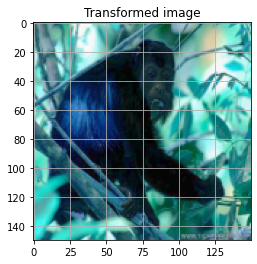

transformed


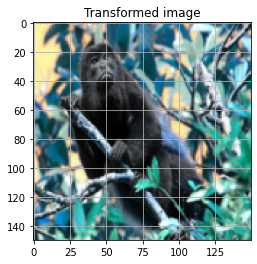

transformed


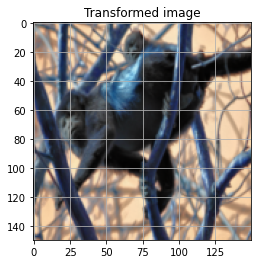

In [ ]:
import matplotlib.pyplot as plt
import cv2
for img_path in all_img_paths[0:30:10]:
    img = cv2.imread(img_path)
    img = preprocess_img(img)
    print('transformed')
    plt.imshow(img)
    plt.grid('off')    
    plt.title('Transformed image')
    plt.show()

In [ ]:
x_train=X
y_train=y

In [ ]:
'''from sklearn.model_selection import train_test_split
x_train, x_test,y_train,y_test=train_test_split(X,y,test_size=0.2, random_state=2)
print(x_train.shape, y_train.shape)'''

(876, 150, 150, 3) (876, 10)


In [ ]:
print(x_train.shape)
print(x_test.shape)
print(y_train.shape)
print(y_test.shape)

(1096, 150, 150, 3)
(272, 150, 150, 3)
(1096, 10)
(272, 10)


In [ ]:
type(x_train)

numpy.ndarray

### 다시 돌려보기 도전

In [ ]:
dir_data = "monkeys10"
dir_seg = dir_data + "/training/training"
dir_img = dir_data + "/validation/validation"
root_dir='monkeys10/training/training/'
all_img_paths = glob.glob(os.path.join(root_dir, '*/*.jpg')) # jpg인 파일만 모아서 출력
all_img_paths[-5:]

['monkeys10/training/training/n9/n9141.jpg',
 'monkeys10/training/training/n9/n9163.jpg',
 'monkeys10/training/training/n9/n9150.jpg',
 'monkeys10/training/training/n9/n9144.jpg',
 'monkeys10/training/training/n9/n9134.jpg']

In [ ]:
import glob, os
all_mask_paths = glob.glob(os.path.join(dir_seg, '*.jpg'))
all_mask_paths[:5]

[]

In [ ]:
x = []
y = []
count = 0

import cv2
for i in range(len(all_img_paths)):
  img = cv2.imread(all_img_paths[i])
  img = cv2.resize(img,(150,150))
  mask_path = dir_seg+all_img_paths[i].split('/')[-1] # 여기도 원래는 \\로 split
  img_mask = cv2.imread(mask_path)
  img_mask = cv2.resize(img_mask,(150,150))
  x.append(img)
  y.append(img_mask)
  if(i%100==0):
    print(i)

error: ignored

### 그림그리고 싶어


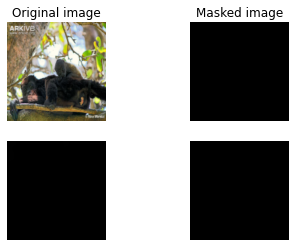

In [ ]:
import matplotlib.pyplot as plt
%matplotlib inline
plt.subplot(221)
plt.imshow(x_test2[1])
plt.axis('off')
plt.title('Original image')
plt.grid('off')
plt.subplot(222)
plt.imshow(x_decoded[1]*255)
plt.axis('off')
plt.title('Masked image')
plt.grid('off')
plt.subplot(223)
plt.imshow(x_test[2])
plt.axis('off')
plt.grid('off')
plt.subplot(224)
plt.imshow(x_decoded[2]*255)
plt.axis('off')
plt.grid('off')
plt.show()

In [ ]:
x_decoded = autoencoder.predict(x_test2)

In [ ]:
x_test2 = x_test
print(x_test2.shape)
print(type(x_test2))
print(x_test.shape)
print(type(x_test))


(272, 150, 150, 3)
<class 'numpy.ndarray'>
(272, 150, 150, 3)
<class 'numpy.ndarray'>


### 모델 시작


loss: 0.0364 - val_loss: 0.0385

In [ ]:
# reshape to (28, 28, 1) and normalize input images
image_size = x_train.shape[1]
x_train2 = np.reshape(x_train, [-1, image_size, image_size, 3]) # cnn은 4d니까 다시 만듦
x_test2 = np.reshape(x_test, [-1, image_size, image_size, 3])
x_train2 = x_train2.astype('float32') / 255
x_test2 = x_test2.astype('float32') / 255


In [ ]:
print(x_train.shape)
print(x_test.shape)
print(y_train.shape)
print(y_test.shape)

(1096, 150, 150, 3)
(272, 150, 150, 3)
(1096, 10)
(272, 10)


In [ ]:
shape

(None, 37, 37, 64)

Model: "model_17"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_24 (InputLayer)        (None, 150, 150, 3)       0         
_________________________________________________________________
conv2d_25 (Conv2D)           (None, 75, 75, 32)        896       
_________________________________________________________________
conv2d_26 (Conv2D)           (None, 37, 37, 64)        18496     
_________________________________________________________________
flatten_23 (Flatten)         (None, 87616)             0         
_________________________________________________________________
dense_67 (Dense)             (None, 16)                1401872   
Total params: 1,421,264
Trainable params: 1,421,264
Non-trainable params: 0
_________________________________________________________________


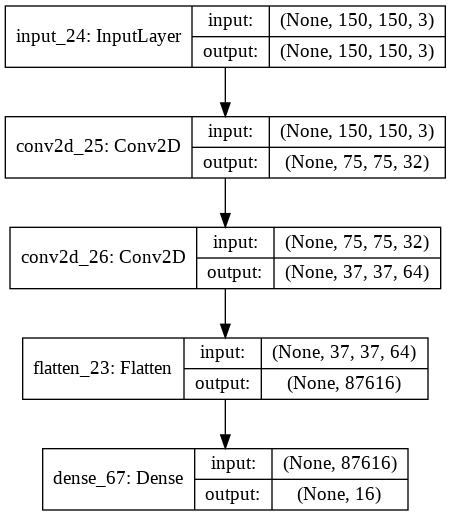

In [ ]:
from keras import backend as k
from keras.utils import plot_model
# 인코더 모델
inputs = Input(shape=(150,150,3))
x=Conv2D(32,3,activation='relu', strides=2, padding='same')(inputs) # 1/2로 줄어듦, 채널32
x=Conv2D(64,3,activation='relu', strides=2, )(x) #다시 줄어들고 채널 64

shape = k.int_shape(x) # x의 shape을 기억하고 싶음 none, 37,37,64
# 배치가 있고, 7,7,64가 있음. 0,1,2,3으로 기억하고있음.  shape[0]는 배치사이즈 나중에 32임.
# decoder에서 나가줘야하니까
x = Flatten()(x)
latent_z = Dense(16)(x) # 잠재변수 16개

encoder = Model(inputs,latent_z)
encoder.summary()
plot_model(encoder,
           to_file='encoder.png',
           show_shapes=True)

Model: "decoder"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_25 (InputLayer)        (None, 16)                0         
_________________________________________________________________
dense_68 (Dense)             (None, 87616)             1489472   
_________________________________________________________________
reshape_8 (Reshape)          (None, 37, 37, 64)        0         
_________________________________________________________________
conv2d_transpose_22 (Conv2DT (None, 75, 75, 64)        36928     
_________________________________________________________________
conv2d_transpose_23 (Conv2DT (None, 150, 150, 32)      18464     
_________________________________________________________________
conv2d_transpose_24 (Conv2DT (None, 150, 150, 3)       867       
Total params: 1,545,731
Trainable params: 1,545,731
Non-trainable params: 0
_________________________________________________

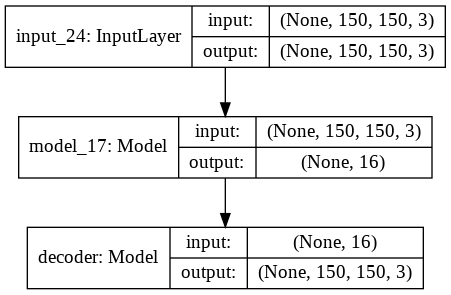

In [ ]:
# 디코더 모델
latent_inputs = Input(shape=(16,)) # 잠재변수 받아옴. 16,1으로 1D텐서
x = Dense(shape[1] * shape[2] * shape[3])(latent_inputs)#37,37,64가 만들어짐reshape을 해줄 수 있음.
x = Reshape((shape[1], shape[2], shape[3]))(x) # 3d텐서가 됨. 샘플까지 하면 4d
x = Conv2DTranspose(64,3,activation='relu',strides=2)(x) # 2dT하니까 14로 변하고 
#x = ZeroPadding2D(padding = (1))(x)
x = Conv2DTranspose(32,3,activation='relu',strides=2,padding='same')(x) # 2dT 또 하니까 28이 됨.
x_tilde= Conv2DTranspose(3,3,activation='sigmoid',padding='same')(x)
# 2dT를 쓰나 그냥 2dconv를 쓰나 똑같음.

decoder = Model(latent_inputs, x_tilde, name='decoder') # 디코더 정의
decoder.summary()
plot_model(decoder, to_file='decoder.png', show_shapes=True)

autoencoder = Model(inputs, # 인코더의 인풋으로 시작해서 
                    decoder(encoder(inputs))) #디코더에서 잠재를 받아서 넣어줌
autoencoder.summary()
plot_model(autoencoder,
           to_file='autoencoder.png',
           show_shapes=True)


In [ ]:
autoencoder.summary()

Model: "model_18"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_24 (InputLayer)        (None, 150, 150, 3)       0         
_________________________________________________________________
model_17 (Model)             (None, 16)                1421264   
_________________________________________________________________
decoder (Model)              (None, 150, 150, 3)       1545731   
Total params: 2,966,995
Trainable params: 2,966,995
Non-trainable params: 0
_________________________________________________________________


In [ ]:
img_shape=(150,150,3)
input_img=Input(shape=img_shape)
autoencoder=Model(input_img,decoder(encoder(input_img)))

autoencoder.compile(loss='mse', optimizer='adam') # x와 x_tilde를 비교하는 것.

autoencoder.fit(x_train, x_train, validation_data=(x_test, x_test), epochs=10, batch_size=32)

Train on 1096 samples, validate on 272 samples
Epoch 1/10
1096/1096 [==============================] - 10s 9ms/step - loss: 0.0719 - val_loss: 0.0682
Epoch 2/10
1096/1096 [==============================] - 10s 9ms/step - loss: 0.0632 - val_loss: 0.0547
Epoch 3/10
1096/1096 [==============================] - 10s 9ms/step - loss: 0.0521 - val_loss: 0.0489
Epoch 4/10
1096/1096 [==============================] - 10s 9ms/step - loss: 0.0474 - val_loss: 0.0453
Epoch 5/10
1096/1096 [==============================] - 10s 9ms/step - loss: 0.0437 - val_loss: 0.0427
Epoch 6/10
1096/1096 [==============================] - 10s 9ms/step - loss: 0.0415 - val_loss: 0.0412
Epoch 7/10
1096/1096 [==============================] - 10s 9ms/step - loss: 0.0400 - val_loss: 0.0397
Epoch 8/10
1096/1096 [==============================] - 10s 9ms/step - loss: 0.0382 - val_loss: 0.0390
Epoch 9/10
1096/1096 [==============================] - 10s 9ms/step - loss: 0.0373 - val_loss: 0.0386
Epoch 10/10
1096/1096 [===

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:9: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  if __name__ == '__main__':


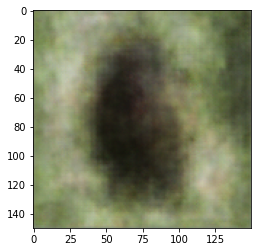

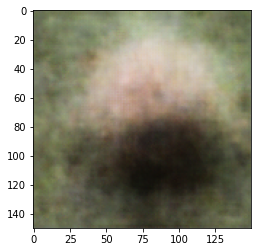

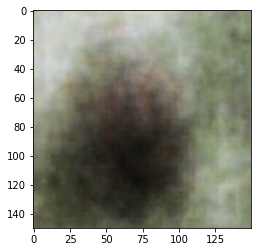

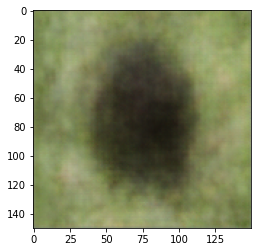

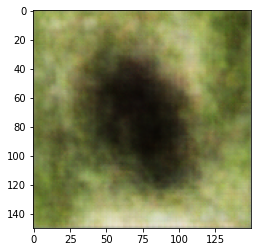

...

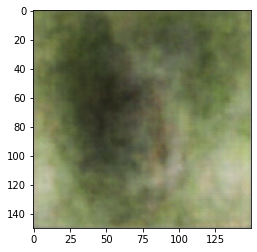

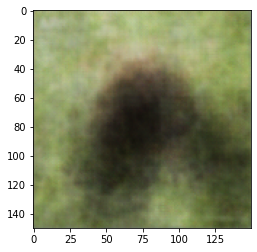

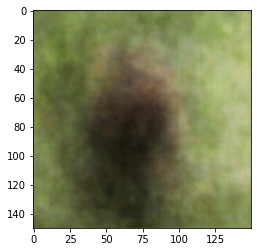

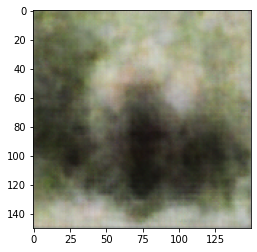

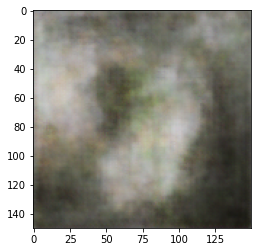

KeyboardInterrupt: ignored

In [ ]:
import matplotlib.pyplot as plt
from keras.preprocessing import image
#random_latent_vectors = np.random.normal(size=(10, latent_dim))

x_decoded = autoencoder.predict(x_test)

for i in range(x_decoded.shape[0]):
    img = image.array_to_img(x_decoded[i] * 255., scale=False)
    plt.figure()
    plt.imshow(img)
    
plt.show()

In [ ]:
x_decoded.shape

(272, 150, 150, 3)

In [ ]:
x_decoded = autoencoder.predict(x_test)

imgs = np.concatenate([x_test[:6], x_decoded[:6]]) # 6개 true값이 있고, 그걸 가지고 6장 만듦
# 12장이 나올 것. 
imgs.shape

(12, 150, 150, 3)

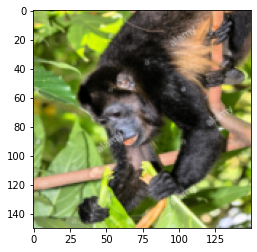

In [ ]:
import matplotlib.pyplot as plt
plt.imshow(x_train[1])
plt.show()

In [ ]:
imgs = imgs.reshape((-1, 6, image_size, image_size))
imgs.shape

(6, 6, 150, 150)

In [ ]:
imgs = np.vstack([np.hstack(i) for i in imgs])
imgs.shape

(900, 900)

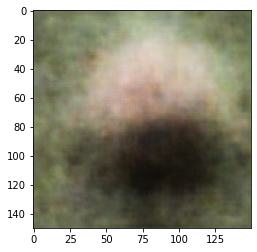

In [ ]:
import matplotlib.pyplot as plt
plt.imshow(x_decoded[1])
plt.show()

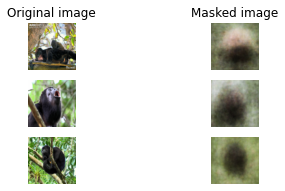

In [ ]:
import matplotlib.pyplot as plt
%matplotlib inline
plt.subplot(421)
plt.imshow(x_test[1])
plt.axis('off')
plt.title('Original image')
plt.grid('off')
plt.subplot(422)
plt.imshow(x_decoded[1])
plt.axis('off')
plt.title('Masked image')
plt.grid('off')
plt.subplot(423)
plt.imshow(x_test[2])
plt.axis('off')
plt.grid('off')
plt.subplot(424)
plt.imshow(x_decoded[2])
plt.axis('off')
plt.subplot(425)
plt.imshow(x_test[3])
plt.axis('off')
plt.subplot(426)
plt.imshow(x_decoded[3])
plt.axis('off')
plt.grid('off')
plt.show()

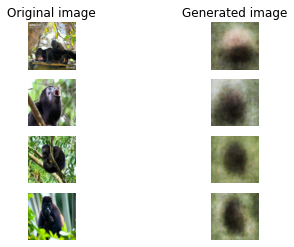

In [ ]:
import matplotlib.pyplot as plt
%matplotlib inline
plt.subplot(421)
plt.imshow(x_test[1])
plt.axis('off')
plt.title('Original image')
plt.grid('off')
plt.subplot(422)
plt.imshow(x_decoded[1])
plt.axis('off')
plt.title('Generated image')
plt.grid('off')
plt.subplot(423)
plt.imshow(x_test[2])
plt.axis('off')
plt.grid('off')
plt.subplot(424)
plt.imshow(x_decoded[2])
plt.axis('off')
plt.subplot(425)
plt.imshow(x_test[3])
plt.axis('off')
plt.subplot(426)
plt.imshow(x_decoded[3])
plt.axis('off')
plt.subplot(427)
plt.imshow(x_test[0])
plt.axis('off')
plt.subplot(428)
plt.imshow(x_decoded[0])
plt.axis('off')
plt.grid('off')
plt.show()

## Noise AutoEncoder

loss: 0.0377 - val_loss: 0.0391

In [ ]:
# 노이즈를 만들 것임. 
noise = np.random.normal(loc=0.5, scale=0.5, size=x_train.shape) # 평균이 0.5 SD=0.5인거부터 만듦
x_train_noise = x_train + noise # 더해줌.
noise = np.random.normal(loc=0.5, scale=0.5, size=x_test.shape)
x_test_noise = x_test + noise

# adding noise may exceed normalized pixel values>1.0 or <0.0
# clip pixel values >1.0 to 1.0 and <0.0 to 0.0
x_train_noise = np.clip(x_train_noise, 0., 1.) # 0보다 작은건 0, 1보다 큰건 1로 넣어줌.
x_test_noise = np.clip(x_test_noise, 0., 1.) # 노말라이제이션을 함 그림 그려야 하니까

inputs = Input(shape=(150,150,3))
x=Conv2D(32,3,activation='relu', strides=2, padding='same')(inputs)
x=Conv2D(64,3,activation='relu', strides=2)(x)

shape = k.int_shape(x)
x = Flatten()(x)
latent_z = Dense(16)(x)

encoder = Model(inputs,latent_z)
encoder.summary()

latent_inputs = Input(shape=(16,))
x = Dense(shape[1] * shape[2] * shape[3])(latent_inputs)
x = Reshape((shape[1], shape[2], shape[3]))(x)
x = Conv2DTranspose(64,3,activation='relu',strides=2)(x)
x = Conv2DTranspose(32,3,activation='relu',strides=2,padding='same')(x)
x_tilde= Conv2DTranspose(3,3,activation='sigmoid',padding='same')(x)

decoder = Model(latent_inputs, x_tilde, name='decoder')
decoder.summary()


autoencoder = Model(inputs,decoder(encoder(inputs)))
autoencoder.compile(loss='mse', optimizer='adam')

autoencoder.fit(x_train_noise, # x noise를 이용 원랜 x_train
                x_train, # y_train이 들어가는 자리인데 여긴 목적변수가 없음
                validation_data=(x_test_noise, x_test),
                epochs=10,
                batch_size=32)

"autoencoder = Model(inputs,decoder(encoder(inputs)))\nautoencoder.compile(loss='mse', optimizer='adam')\n\nautoencoder.fit(x_train_noise, # x noise를 이용 원랜 x_train\n                x_train, # y_train이 들어가는 자리인데 여긴 목적변수가 없음\n                validation_data=(x_test_noise, x_test),\n                epochs=10,\n                batch_size=32)"

In [ ]:
latent_inputs = Input(shape=(16,))
x = Dense(shape[1] * shape[2] * shape[3])(latent_inputs)
x = Reshape((shape[1], shape[2], shape[3]))(x)
x = Conv2DTranspose(64,3,activation='relu',strides=2)(x)
x = Conv2DTranspose(32,3,activation='relu',strides=2,padding='same')(x)
x_tilde= Conv2DTranspose(3,3,activation='sigmoid',padding='same')(x)

decoder = Model(latent_inputs, x_tilde, name='decoder')
decoder.summary()

Model: "decoder"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_51 (InputLayer)        (None, 16)                0         
_________________________________________________________________
dense_92 (Dense)             (None, 87616)             1489472   
_________________________________________________________________
reshape_25 (Reshape)         (None, 37, 37, 64)        0         
_________________________________________________________________
conv2d_transpose_73 (Conv2DT (None, 75, 75, 64)        36928     
_________________________________________________________________
conv2d_transpose_74 (Conv2DT (None, 150, 150, 32)      18464     
_________________________________________________________________
conv2d_transpose_75 (Conv2DT (None, 150, 150, 3)       867       
Total params: 1,545,731
Trainable params: 1,545,731
Non-trainable params: 0
_________________________________________________

In [ ]:
inputs = Input(shape=(150,150,3))
x=Conv2D(32,3,activation='relu', strides=2, padding='same')(inputs)
x=Conv2D(64,3,activation='relu', strides=2)(x)

shape = k.int_shape(x)
x = Flatten()(x)
latent_z = Dense(16)(x)

encoder = Model(inputs,latent_z)
encoder.summary()

Model: "model_31"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_48 (InputLayer)        (None, 150, 150, 3)       0         
_________________________________________________________________
conv2d_41 (Conv2D)           (None, 75, 75, 32)        896       
_________________________________________________________________
conv2d_42 (Conv2D)           (None, 37, 37, 64)        18496     
_________________________________________________________________
flatten_30 (Flatten)         (None, 87616)             0         
_________________________________________________________________
dense_89 (Dense)             (None, 16)                1401872   
Total params: 1,421,264
Trainable params: 1,421,264
Non-trainable params: 0
_________________________________________________________________


In [ ]:
autoencoder = Model(inputs,decoder(encoder(inputs)))
autoencoder.compile(loss='mse', optimizer='adam')

autoencoder.fit(x_train_noise, # x noise를 이용 원랜 x_train
                x_train, # y_train이 들어가는 자리인데 여긴 목적변수가 없음
                validation_data=(x_test_noise, x_test),
                epochs=10,
                batch_size=32)

Train on 1096 samples, validate on 272 samples
Epoch 1/10
1096/1096 [==============================] - 10s 9ms/step - loss: 0.0731 - val_loss: 0.0695
Epoch 2/10
1096/1096 [==============================] - 10s 9ms/step - loss: 0.0693 - val_loss: 0.0682
Epoch 3/10
1096/1096 [==============================] - 10s 9ms/step - loss: 0.0644 - val_loss: 0.0553
Epoch 4/10
1096/1096 [==============================] - 10s 9ms/step - loss: 0.0539 - val_loss: 0.0514
Epoch 5/10
1096/1096 [==============================] - 10s 9ms/step - loss: 0.0498 - val_loss: 0.0474
Epoch 6/10
1096/1096 [==============================] - 10s 9ms/step - loss: 0.0455 - val_loss: 0.0438
Epoch 7/10
1096/1096 [==============================] - 10s 9ms/step - loss: 0.0426 - val_loss: 0.0423
Epoch 8/10
1096/1096 [==============================] - 10s 9ms/step - loss: 0.0405 - val_loss: 0.0403
Epoch 9/10
1096/1096 [==============================] - 10s 9ms/step - loss: 0.0388 - val_loss: 0.0396
Epoch 10/10
1096/1096 [===

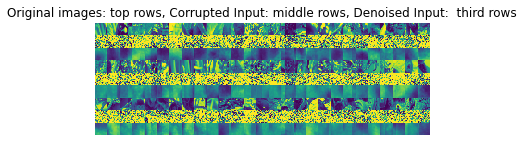

In [ ]:
x_decoded = autoencoder.predict(x_test_noise)

imgs = np.concatenate([x_test[:27], x_test_noise[:27], x_decoded[:27]])
imgs = imgs.reshape((9,-1, x_test.shape[1],x_test.shape[1]))
imgs = np.vstack(np.split(imgs, 3, axis=1))
imgs = imgs.reshape((9, -1, x_test.shape[1],x_test.shape[1]))
imgs = np.vstack([np.hstack(i) for i in imgs])
imgs = (imgs * 255).astype(np.uint8)
plt.figure()
plt.axis('off')
plt.title('Original images: top rows, '
          'Corrupted Input: middle rows, '
          'Denoised Input:  third rows')
plt.imshow(imgs, interpolation='none')
plt.show()

In [ ]:
x_decoded = autoencoder.predict(x_test_noise)

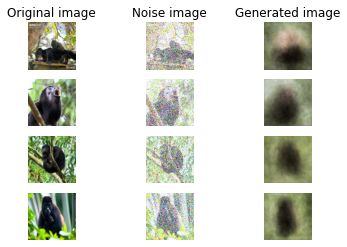

In [ ]:
import matplotlib.pyplot as plt
%matplotlib inline
plt.subplot(431)
plt.imshow(x_test[1])
plt.axis('off')
plt.title('Original image')
plt.grid('off')

plt.subplot(432)
plt.imshow(x_test_noise[1])
plt.axis('off')
plt.title('Noise image')
plt.grid('off')

plt.subplot(433)
plt.imshow(x_decoded[1])
plt.axis('off')
plt.title('Generated image')
plt.grid('off')

plt.subplot(434)
plt.imshow(x_test[2])
plt.axis('off')
plt.subplot(435)
plt.imshow(x_test_noise[2])
plt.axis('off')
plt.subplot(436)
plt.imshow(x_decoded[2])
plt.axis('off')

plt.subplot(437)
plt.imshow(x_test[3])
plt.axis('off')
plt.subplot(438)
plt.imshow(x_test_noise[3])
plt.axis('off')
plt.subplot(439)
plt.imshow(x_decoded[3])
plt.axis('off')

plt.subplot(4,3,10)
plt.imshow(x_test[0])
plt.axis('off')
plt.subplot(4,3,11)
plt.imshow(x_test_noise[0])
plt.axis('off')
plt.subplot(4,3,12)
plt.imshow(x_decoded[0])
plt.axis('off')
plt.grid('off')
plt.show()

### 2nd

In [ ]:
# 노이즈를 만들 것임. 
noise = np.random.normal(loc=0.5, scale=0.5, size=x_train.shape) # 평균이 0.5 SD=0.5인거부터 만듦
x_train_noise = x_train + noise # 더해줌.
noise = np.random.normal(loc=0.5, scale=0.5, size=x_test.shape)
x_test_noise = x_test + noise

# adding noise may exceed normalized pixel values>1.0 or <0.0
# clip pixel values >1.0 to 1.0 and <0.0 to 0.0
x_train_noise = np.clip(x_train_noise, 0., 1.) # 0보다 작은건 0, 1보다 큰건 1로 넣어줌.
x_test_noise = np.clip(x_test_noise, 0., 1.) # 노말라이제이션을 함 그림 그려야 하니까


autoencoder = Model(inputs,decoder(encoder(inputs)))
autoencoder.compile(loss='mse', optimizer='adam')

autoencoder.fit(x_train_noise, # x noise를 이용 원랜 x_train
                x_train, # y_train이 들어가는 자리인데 여긴 목적변수가 없음
                validation_data=(x_test_noise, x_test),
                epochs=10,
                batch_size=32)

Train on 1096 samples, validate on 272 samples
Epoch 1/10
1096/1096 [==============================] - 12s 11ms/step - loss: 0.0748 - val_loss: 0.0702
Epoch 2/10
1096/1096 [==============================] - 12s 11ms/step - loss: 0.0699 - val_loss: 0.0694
Epoch 3/10
1096/1096 [==============================] - 12s 11ms/step - loss: 0.0680 - val_loss: 0.0605
Epoch 4/10
1096/1096 [==============================] - 12s 11ms/step - loss: 0.0569 - val_loss: 0.0526
Epoch 5/10
1096/1096 [==============================] - 12s 11ms/step - loss: 0.0499 - val_loss: 0.0469
Epoch 6/10
1096/1096 [==============================] - 11s 10ms/step - loss: 0.0455 - val_loss: 0.0436
Epoch 7/10
1096/1096 [==============================] - 12s 11ms/step - loss: 0.0437 - val_loss: 0.0417
Epoch 8/10
1096/1096 [==============================] - 11s 10ms/step - loss: 0.0406 - val_loss: 0.0395
Epoch 9/10
1096/1096 [==============================] - 12s 11ms/step - loss: 0.0389 - val_loss: 0.0392
Epoch 10/10
1096/

In [ ]:
x_decoded = autoencoder.predict(x_test_noise)

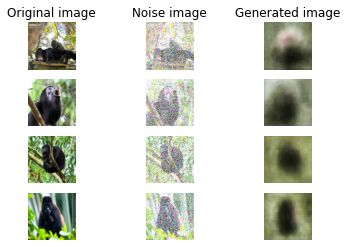

In [ ]:
import matplotlib.pyplot as plt
%matplotlib inline
plt.subplot(431)
plt.imshow(x_test[1])
plt.axis('off')
plt.title('Original image')
plt.grid('off')

plt.subplot(432)
plt.imshow(x_test_noise[1])
plt.axis('off')
plt.title('Noise image')
plt.grid('off')

plt.subplot(433)
plt.imshow(x_decoded[1])
plt.axis('off')
plt.title('Generated image')
plt.grid('off')

plt.subplot(434)
plt.imshow(x_test[2])
plt.axis('off')
plt.subplot(435)
plt.imshow(x_test_noise[2])
plt.axis('off')
plt.subplot(436)
plt.imshow(x_decoded[2])
plt.axis('off')

plt.subplot(437)
plt.imshow(x_test[3])
plt.axis('off')
plt.subplot(438)
plt.imshow(x_test_noise[3])
plt.axis('off')
plt.subplot(439)
plt.imshow(x_decoded[3])
plt.axis('off')

plt.subplot(4,3,10)
plt.imshow(x_test[0])
plt.axis('off')
plt.subplot(4,3,11)
plt.imshow(x_test_noise[0])
plt.axis('off')
plt.subplot(4,3,12)
plt.imshow(x_decoded[0])
plt.axis('off')
plt.grid('off')
plt.show()

In [ ]:
inputs = Input(shape=(150,150,3))
x=Conv2D(32,3,activation='relu', strides=2, padding='same')(inputs)
x=Conv2D(64,3,activation='relu', strides=2)(x)
x=Conv2D(128,3,activation='relu', strides=2)(x)

shape = k.int_shape(x)
x = Flatten()(x)
latent_z = Dense(16)(x)

encoder = Model(inputs,latent_z)
encoder.summary()

Model: "model_34"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_52 (InputLayer)        (None, 150, 150, 3)       0         
_________________________________________________________________
conv2d_43 (Conv2D)           (None, 75, 75, 32)        896       
_________________________________________________________________
conv2d_44 (Conv2D)           (None, 37, 37, 64)        18496     
_________________________________________________________________
conv2d_45 (Conv2D)           (None, 18, 18, 128)       73856     
_________________________________________________________________
flatten_31 (Flatten)         (None, 41472)             0         
_________________________________________________________________
dense_93 (Dense)             (None, 16)                663568    
Total params: 756,816
Trainable params: 756,816
Non-trainable params: 0
____________________________________________________

In [ ]:
latent_inputs = Input(shape=(16,))
x = Dense(shape[1] * shape[2] * shape[3])(latent_inputs)
x = Reshape((shape[1], shape[2], shape[3]))(x)
x = Conv2DTranspose(128,3,activation='relu',strides=2)(x)
x = Conv2DTranspose(64,3,activation='relu',strides=2)(x)
x = Conv2DTranspose(32,3,activation='relu',strides=2,padding='same')(x)
x_tilde= Conv2DTranspose(3,3,activation='sigmoid',padding='same')(x)

decoder = Model(latent_inputs, x_tilde, name='decoder')
decoder.summary()



Model: "decoder"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_53 (InputLayer)        (None, 16)                0         
_________________________________________________________________
dense_94 (Dense)             (None, 41472)             705024    
_________________________________________________________________
reshape_26 (Reshape)         (None, 18, 18, 128)       0         
_________________________________________________________________
conv2d_transpose_76 (Conv2DT (None, 37, 37, 128)       147584    
_________________________________________________________________
conv2d_transpose_77 (Conv2DT (None, 75, 75, 64)        73792     
_________________________________________________________________
conv2d_transpose_78 (Conv2DT (None, 150, 150, 32)      18464     
_________________________________________________________________
conv2d_transpose_79 (Conv2DT (None, 150, 150, 3)       867 

## VAE

### 1st

dim = 10

loss: 1173.1994 - val_loss: 1197.3910

In [ ]:
img_shape=(150,150,3)
batch_size=16
latent_dim=10 # 노말의 dim이 2라 bivariate임. 

input_img=Input(shape=img_shape)
x=Conv2D(32,3,padding='same', strides=2, activation='relu')(input_img)
x=Conv2D(64,3,  strides=2, activation='relu')(x)
shape=k.int_shape(x) # 7,7,64
x=Flatten()(x)
x=Dense(32, activation='relu')(x)
z_mean=Dense(latent_dim)(x)
z_log_var=Dense(latent_dim)(x) # 로그 어쩌고 하는게 conv가 빠름
# 이거 두개 같은거 아님?

In [ ]:
def sampling(args):
    z_mean,z_log_var=args
    batch=k.shape(z_mean)[0] # 16
    dim=k.int_shape(z_mean)[1] #2이 들어가게 됨. <-- 이거 맞는지 확인
    epsilon=k.random_normal(shape=(batch,dim))
    return z_mean+k.exp(0.5*z_log_var)*epsilon # 평균이 뮤, 분산이 시그마^2 # 57분
# random number를 generating 시킨 것
z=Lambda(sampling,output_shape=(latent_dim,))([z_mean,z_log_var]) # 얘는 input
# lambda를 통해 built in이 아닌 layer 추가

Model: "model_41"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_58 (InputLayer)           (None, 150, 150, 3)  0                                            
__________________________________________________________________________________________________
conv2d_53 (Conv2D)              (None, 75, 75, 32)   896         input_58[0][0]                   
__________________________________________________________________________________________________
conv2d_54 (Conv2D)              (None, 37, 37, 64)   18496       conv2d_53[0][0]                  
__________________________________________________________________________________________________
flatten_35 (Flatten)            (None, 87616)        0           conv2d_54[0][0]                  
___________________________________________________________________________________________

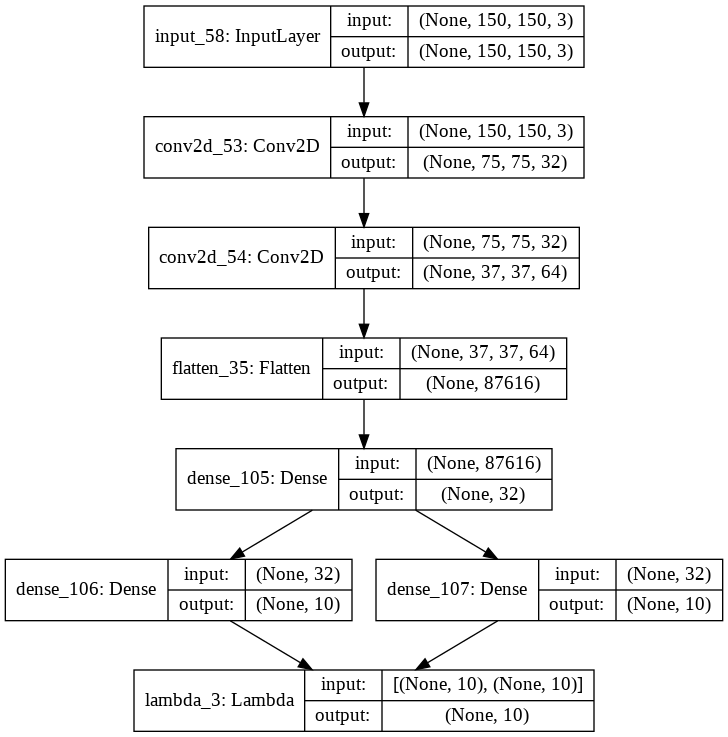

In [ ]:
encoder=Model(input_img,[z_mean, z_log_var, z])
encoder.summary()
plot_model(encoder,show_shapes=True)

Model: "model_44"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_60 (InputLayer)        (None, 10)                0         
_________________________________________________________________
dense_109 (Dense)            (None, 87616)             963776    
_________________________________________________________________
reshape_29 (Reshape)         (None, 37, 37, 64)        0         
_________________________________________________________________
conv2d_transpose_84 (Conv2DT (None, 75, 75, 64)        36928     
_________________________________________________________________
conv2d_transpose_85 (Conv2DT (None, 150, 150, 32)      18464     
_________________________________________________________________
conv2d_56 (Conv2D)           (None, 150, 150, 3)       867       
Total params: 1,020,035
Trainable params: 1,020,035
Non-trainable params: 0
________________________________________________

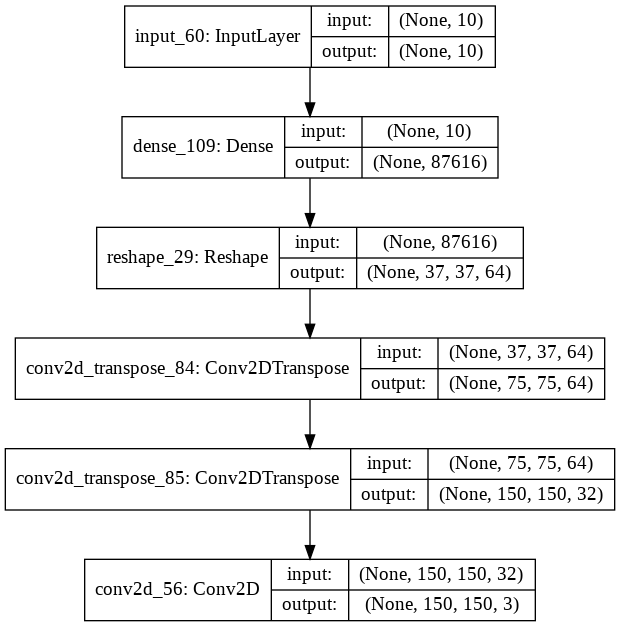

In [ ]:
latent_input=Input(shape=(latent_dim,))
x=Dense(np.prod(shape[1:]), activation='relu')(latent_input)
x=Reshape(shape[1:])(x) # 7,7,64
x=Conv2DTranspose(64,3,strides=2,activation='relu')(x)
x=Conv2DTranspose(32,3,padding='same',strides=2,activation='relu')(x)
output=Conv2D(3,3, padding='same',activation='sigmoid')(x)
decoder=Model(latent_input,output)
decoder.summary()
plot_model(decoder, show_shapes=True)

In [ ]:
f_output=decoder(encoder(input_img)[2]) # 인코더의 output중 z만 필요하므로 [2]
vae=Model(input_img, f_output)
vae.summary()

Model: "model_45"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_58 (InputLayer)        (None, 150, 150, 3)       0         
_________________________________________________________________
model_41 (Model)             [(None, 10), (None, 10),  2823796   
_________________________________________________________________
model_44 (Model)             (None, 150, 150, 3)       1020035   
Total params: 3,843,831
Trainable params: 3,843,831
Non-trainable params: 0
_________________________________________________________________


In [ ]:
# Loss function 정의
input_img1=k.flatten(input_img)
f_output1=k.flatten(f_output)
print(input_img1, f_output1)
reconstruction_loss=keras.losses.mse(input_img1, f_output1) # 첫번째 식
reconstruction_loss*=input_img.shape[1]*input_img.shape[1] # 28*28는 빼주기위해서 다시 곱함
inference_loss=1+z_log_var-k.square(z_mean)-k.exp(z_log_var) # 두번째 식
inference_loss=k.sum(inference_loss, axis=-1)*-0.5         #-0.5 왜하는데?
vae_loss=k.mean(reconstruction_loss+inference_loss)

vae.add_loss(vae_loss)
vae.compile(optimizer='rmsprop')


Tensor("Reshape_32:0", shape=(None,), dtype=float32) Tensor("Reshape_33:0", shape=(None,), dtype=float32)


/usr/local/lib/python3.6/dist-packages/keras/engine/training_utils.py:819: UserWarning: Output model_44 missing from loss dictionary. We assume this was done on purpose. The fit and evaluate APIs will not be expecting any data to be passed to model_44.
  'be expecting any data to be passed to {0}.'.format(name))


In [ ]:
vae.fit(x_train, epochs=10, shuffle=True, batch_size=batch_size, validation_data=(x_test,None))

Train on 1096 samples, validate on 272 samples
Epoch 1/10
1096/1096 [==============================] - 17s 16ms/step - loss: 1595.6411 - val_loss: 1557.2489
Epoch 2/10
1096/1096 [==============================] - 17s 15ms/step - loss: 1559.9377 - val_loss: 1523.2881
Epoch 3/10
1096/1096 [==============================] - 16s 15ms/step - loss: 1456.0620 - val_loss: 1360.9038
Epoch 4/10
1096/1096 [==============================] - 16s 15ms/step - loss: 1349.9684 - val_loss: 1281.5363
Epoch 5/10
1096/1096 [==============================] - 17s 15ms/step - loss: 1268.7176 - val_loss: 1231.2403
Epoch 6/10
1096/1096 [==============================] - 17s 16ms/step - loss: 1232.9821 - val_loss: 1213.6430
Epoch 7/10
1096/1096 [==============================] - 17s 15ms/step - loss: 1210.4708 - val_loss: 1195.7156
Epoch 8/10
1096/1096 [==============================] - 16s 15ms/step - loss: 1192.9411 - val_loss: 1174.5594
Epoch 9/10
1096/1096 [==============================] - 17s 15ms/step - l

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:9: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  if __name__ == '__main__':


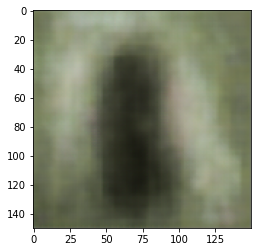

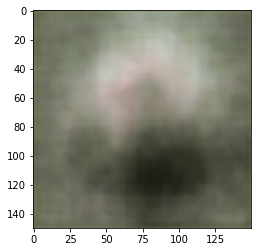

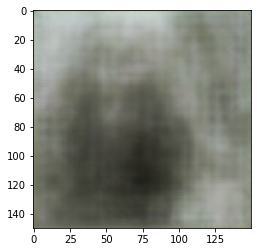

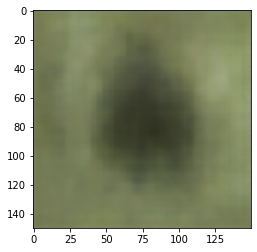

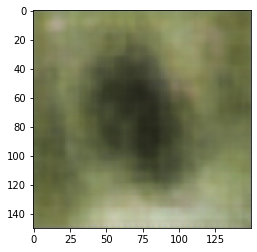

...

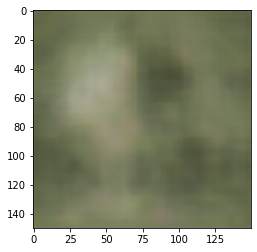

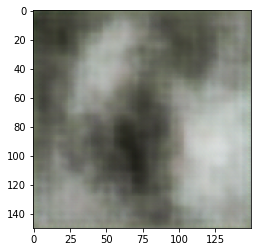

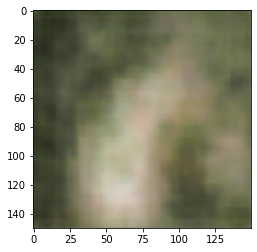

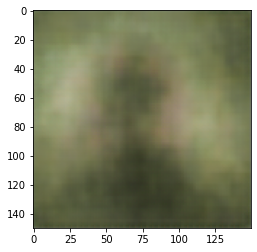

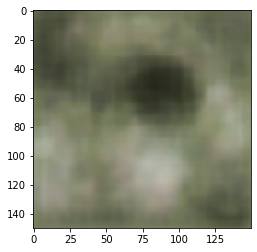

KeyboardInterrupt: ignored

In [ ]:
import matplotlib.pyplot as plt
from keras.preprocessing import image
#random_latent_vectors = np.random.normal(size=(10, latent_dim))

x_decoded = autoencoder.predict(x_test)

for i in range(x_decoded.shape[0]):
    img = image.array_to_img(x_decoded[i] * 255., scale=False)
    plt.figure()
    plt.imshow(img)
    
plt.show()

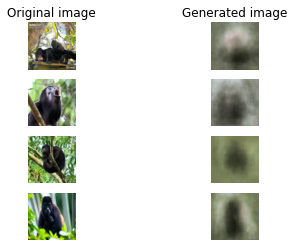

In [ ]:
import matplotlib.pyplot as plt
%matplotlib inline
plt.subplot(421)
plt.imshow(x_test[1])
plt.axis('off')
plt.title('Original image')
plt.grid('off')
plt.subplot(422)
plt.imshow(x_decoded[1])
plt.axis('off')
plt.title('Generated image')
plt.grid('off')
plt.subplot(423)
plt.imshow(x_test[2])
plt.axis('off')
plt.grid('off')
plt.subplot(424)
plt.imshow(x_decoded[2])
plt.axis('off')
plt.subplot(425)
plt.imshow(x_test[3])
plt.axis('off')
plt.subplot(426)
plt.imshow(x_decoded[3])
plt.axis('off')
plt.subplot(427)
plt.imshow(x_test[0])
plt.axis('off')
plt.subplot(428)
plt.imshow(x_decoded[0])
plt.axis('off')
plt.grid('off')
plt.show()

### 2nd 

latent dim = 3

loss: 1279.3226 - val_loss: 1283.4971

In [ ]:
img_shape=(150,150,3)
batch_size=16
latent_dim=3 # 노말의 dim이 2라 bivariate임. 

input_img=Input(shape=img_shape)
x=Conv2D(32,3,padding='same', strides=2, activation='relu')(input_img)
x=Conv2D(64,3,  strides=2, activation='relu')(x)
shape=k.int_shape(x) # 7,7,64
x=Flatten()(x)
x=Dense(32, activation='relu')(x)
z_mean=Dense(latent_dim)(x)
z_log_var=Dense(latent_dim)(x) # 로그 어쩌고 하는게 conv가 빠름
# 이거 두개 같은거 아님?


def sampling(args):
    z_mean,z_log_var=args
    batch=k.shape(z_mean)[0] # 16
    dim=k.int_shape(z_mean)[1] #2이 들어가게 됨. <-- 이거 맞는지 확인
    epsilon=k.random_normal(shape=(batch,dim))
    return z_mean+k.exp(0.5*z_log_var)*epsilon # 평균이 뮤, 분산이 시그마^2 # 57분
# random number를 generating 시킨 것
z=Lambda(sampling,output_shape=(latent_dim,))([z_mean,z_log_var]) # 얘는 input
# lambda를 통해 built in이 아닌 layer 추가

encoder=Model(input_img,[z_mean, z_log_var, z])
encoder.summary()
plot_model(encoder,show_shapes=True)

latent_input=Input(shape=(latent_dim,))
x=Dense(np.prod(shape[1:]), activation='relu')(latent_input)
x=Reshape(shape[1:])(x) # 7,7,64
x=Conv2DTranspose(64,3,strides=2,activation='relu')(x)
x=Conv2DTranspose(32,3,padding='same',strides=2,activation='relu')(x)
output=Conv2D(3,3, padding='same',activation='sigmoid')(x)
decoder=Model(latent_input,output)
decoder.summary()
plot_model(decoder, show_shapes=True)



f_output=decoder(encoder(input_img)[2]) # 인코더의 output중 z만 필요하므로 [2]
vae=Model(input_img, f_output)
vae.summary()



# Loss function 정의
input_img1=k.flatten(input_img)
f_output1=k.flatten(f_output)
print(input_img1, f_output1)
reconstruction_loss=keras.losses.mse(input_img1, f_output1) # 첫번째 식
reconstruction_loss*=input_img.shape[1]*input_img.shape[1] # 28*28는 빼주기위해서 다시 곱함
inference_loss=1+z_log_var-k.square(z_mean)-k.exp(z_log_var) # 두번째 식
inference_loss=k.sum(inference_loss, axis=-1)*-0.5         #-0.5 왜하는데?
vae_loss=k.mean(reconstruction_loss+inference_loss)

vae.add_loss(vae_loss)
vae.compile(optimizer='rmsprop')


Model: "model_46"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_61 (InputLayer)           (None, 150, 150, 3)  0                                            
__________________________________________________________________________________________________
conv2d_57 (Conv2D)              (None, 75, 75, 32)   896         input_61[0][0]                   
__________________________________________________________________________________________________
conv2d_58 (Conv2D)              (None, 37, 37, 64)   18496       conv2d_57[0][0]                  
__________________________________________________________________________________________________
flatten_36 (Flatten)            (None, 87616)        0           conv2d_58[0][0]                  
___________________________________________________________________________________________

/usr/local/lib/python3.6/dist-packages/keras/engine/training_utils.py:819: UserWarning: Output model_47 missing from loss dictionary. We assume this was done on purpose. The fit and evaluate APIs will not be expecting any data to be passed to model_47.
  'be expecting any data to be passed to {0}.'.format(name))


In [ ]:
vae.fit(x_train, epochs=10, shuffle=True, batch_size=batch_size, validation_data=(x_test,None))

Train on 1096 samples, validate on 272 samples
Epoch 1/10
1096/1096 [==============================] - 17s 16ms/step - loss: 1587.4291 - val_loss: 1550.6110
Epoch 2/10
1096/1096 [==============================] - 17s 16ms/step - loss: 1544.0820 - val_loss: 1481.6369
Epoch 3/10
1096/1096 [==============================] - 18s 16ms/step - loss: 1452.6230 - val_loss: 1377.5585
Epoch 4/10
1096/1096 [==============================] - 17s 16ms/step - loss: 1372.9720 - val_loss: 1363.9897
Epoch 5/10
1096/1096 [==============================] - 17s 16ms/step - loss: 1340.8484 - val_loss: 1385.6689
Epoch 6/10
1096/1096 [==============================] - 17s 16ms/step - loss: 1317.5020 - val_loss: 1316.5708
Epoch 7/10
1096/1096 [==============================] - 17s 16ms/step - loss: 1306.4106 - val_loss: 1311.7635
Epoch 8/10
1096/1096 [==============================] - 17s 16ms/step - loss: 1297.2262 - val_loss: 1300.3676
Epoch 9/10
1096/1096 [==============================] - 18s 16ms/step - l

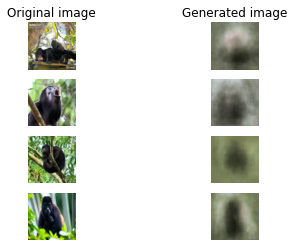

In [ ]:
import matplotlib.pyplot as plt
%matplotlib inline
plt.subplot(421)
plt.imshow(x_test[1])
plt.axis('off')
plt.title('Original image')
plt.grid('off')
plt.subplot(422)
plt.imshow(x_decoded[1])
plt.axis('off')
plt.title('Generated image')
plt.grid('off')
plt.subplot(423)
plt.imshow(x_test[2])
plt.axis('off')
plt.grid('off')
plt.subplot(424)
plt.imshow(x_decoded[2])
plt.axis('off')
plt.subplot(425)
plt.imshow(x_test[3])
plt.axis('off')
plt.subplot(426)
plt.imshow(x_decoded[3])
plt.axis('off')
plt.subplot(427)
plt.imshow(x_test[0])
plt.axis('off')
plt.subplot(428)
plt.imshow(x_decoded[0])
plt.axis('off')
plt.grid('off')
plt.show()

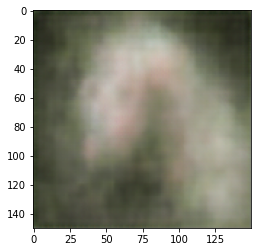

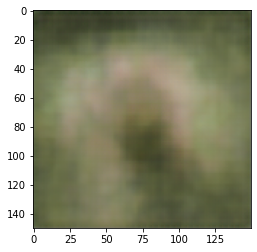

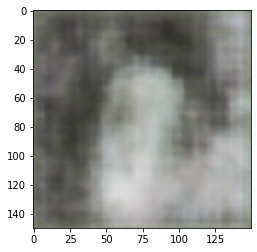

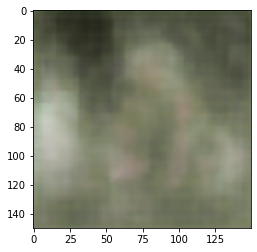

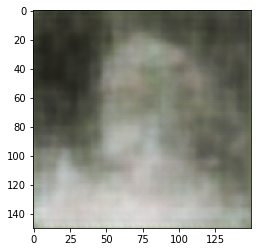

In [ ]:
import matplotlib.pyplot as plt
from keras.preprocessing import image
#random_latent_vectors = np.random.normal(size=(10, latent_dim))

x_decoded = autoencoder.predict(x_test)

for i in range(25,30):
    img = image.array_to_img(x_decoded[i] * 255., scale=False)
    plt.figure()
    plt.imshow(img)
    
plt.show()

### 3rd 

latent dim = 30


1269.2293 - val_loss: 1261.7750

In [ ]:
img_shape=(150,150,3)
batch_size=16
latent_dim=30 # 노말의 dim이 2라 bivariate임. 

input_img=Input(shape=img_shape)
x=Conv2D(32,3,padding='same', strides=2, activation='relu')(input_img)
x=Conv2D(64,3,  strides=2, activation='relu')(x)
shape=k.int_shape(x) # 7,7,64
x=Flatten()(x)
x=Dense(32, activation='relu')(x)
z_mean=Dense(latent_dim)(x)
z_log_var=Dense(latent_dim)(x) # 로그 어쩌고 하는게 conv가 빠름
# 이거 두개 같은거 아님?


def sampling(args):
    z_mean,z_log_var=args
    batch=k.shape(z_mean)[0] # 16
    dim=k.int_shape(z_mean)[1] #2이 들어가게 됨. <-- 이거 맞는지 확인
    epsilon=k.random_normal(shape=(batch,dim))
    return z_mean+k.exp(0.5*z_log_var)*epsilon # 평균이 뮤, 분산이 시그마^2 # 57분
# random number를 generating 시킨 것
z=Lambda(sampling,output_shape=(latent_dim,))([z_mean,z_log_var]) # 얘는 input
# lambda를 통해 built in이 아닌 layer 추가

encoder=Model(input_img,[z_mean, z_log_var, z])
encoder.summary()
plot_model(encoder,show_shapes=True)

latent_input=Input(shape=(latent_dim,))
x=Dense(np.prod(shape[1:]), activation='relu')(latent_input)
x=Reshape(shape[1:])(x) # 7,7,64
x=Conv2DTranspose(64,3,strides=2,activation='relu')(x)
x=Conv2DTranspose(32,3,padding='same',strides=2,activation='relu')(x)
output=Conv2D(3,3, padding='same',activation='sigmoid')(x)
decoder=Model(latent_input,output)
decoder.summary()
plot_model(decoder, show_shapes=True)



f_output=decoder(encoder(input_img)[2]) # 인코더의 output중 z만 필요하므로 [2]
vae=Model(input_img, f_output)
vae.summary()



# Loss function 정의
input_img1=k.flatten(input_img)
f_output1=k.flatten(f_output)
print(input_img1, f_output1)
reconstruction_loss=keras.losses.mse(input_img1, f_output1) # 첫번째 식
reconstruction_loss*=input_img.shape[1]*input_img.shape[1] # 28*28는 빼주기위해서 다시 곱함
inference_loss=1+z_log_var-k.square(z_mean)-k.exp(z_log_var) # 두번째 식
inference_loss=k.sum(inference_loss, axis=-1)*-0.5         #-0.5 왜하는데?
vae_loss=k.mean(reconstruction_loss+inference_loss)

vae.add_loss(vae_loss)
vae.compile(optimizer='rmsprop')


Model: "model_49"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_63 (InputLayer)           (None, 150, 150, 3)  0                                            
__________________________________________________________________________________________________
conv2d_60 (Conv2D)              (None, 75, 75, 32)   896         input_63[0][0]                   
__________________________________________________________________________________________________
conv2d_61 (Conv2D)              (None, 37, 37, 64)   18496       conv2d_60[0][0]                  
__________________________________________________________________________________________________
flatten_37 (Flatten)            (None, 87616)        0           conv2d_61[0][0]                  
___________________________________________________________________________________________

/usr/local/lib/python3.6/dist-packages/keras/engine/training_utils.py:819: UserWarning: Output model_50 missing from loss dictionary. We assume this was done on purpose. The fit and evaluate APIs will not be expecting any data to be passed to model_50.
  'be expecting any data to be passed to {0}.'.format(name))


In [ ]:
vae.fit(x_train, epochs=10, shuffle=True, batch_size=batch_size, validation_data=(x_test,None))

Train on 1096 samples, validate on 272 samples
Epoch 1/10
1096/1096 [==============================] - 18s 16ms/step - loss: 1589.7758 - val_loss: 1486.0624
Epoch 2/10
1096/1096 [==============================] - 17s 16ms/step - loss: 1456.5963 - val_loss: 1410.6095
Epoch 3/10
1096/1096 [==============================] - 17s 15ms/step - loss: 1403.1752 - val_loss: 1367.5506
Epoch 4/10
1096/1096 [==============================] - 18s 16ms/step - loss: 1365.9679 - val_loss: 1330.1506
Epoch 5/10
1096/1096 [==============================] - 18s 16ms/step - loss: 1345.1422 - val_loss: 1310.4418
Epoch 6/10
1096/1096 [==============================] - 18s 16ms/step - loss: 1330.2202 - val_loss: 1324.2812
Epoch 7/10
1096/1096 [==============================] - 18s 16ms/step - loss: 1311.9206 - val_loss: 1325.4335
Epoch 8/10
1096/1096 [==============================] - 18s 17ms/step - loss: 1291.7415 - val_loss: 1288.6375
Epoch 9/10
1096/1096 [==============================] - 19s 17ms/step - l

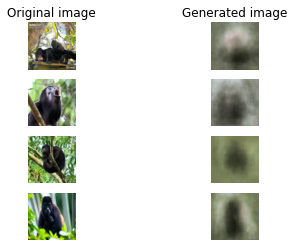

In [ ]:
import matplotlib.pyplot as plt
%matplotlib inline
plt.subplot(421)
plt.imshow(x_test[1])
plt.axis('off')
plt.title('Original image')
plt.grid('off')
plt.subplot(422)
plt.imshow(x_decoded[1])
plt.axis('off')
plt.title('Generated image')
plt.grid('off')
plt.subplot(423)
plt.imshow(x_test[2])
plt.axis('off')
plt.grid('off')
plt.subplot(424)
plt.imshow(x_decoded[2])
plt.axis('off')
plt.subplot(425)
plt.imshow(x_test[3])
plt.axis('off')
plt.subplot(426)
plt.imshow(x_decoded[3])
plt.axis('off')
plt.subplot(427)
plt.imshow(x_test[0])
plt.axis('off')
plt.subplot(428)
plt.imshow(x_decoded[0])
plt.axis('off')
plt.grid('off')
plt.show()

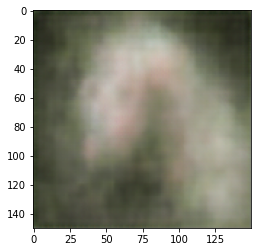

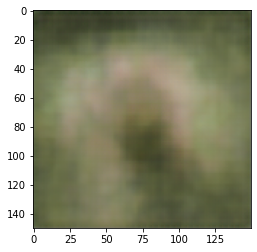

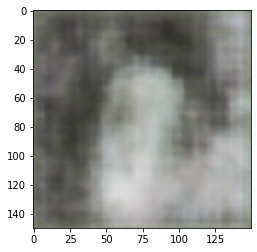

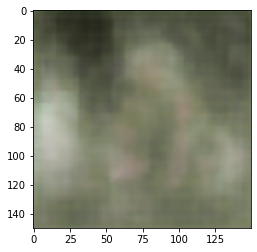

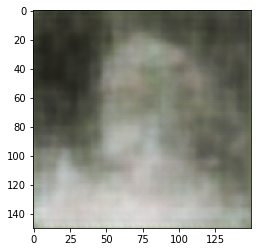

In [ ]:
import matplotlib.pyplot as plt
from keras.preprocessing import image
#random_latent_vectors = np.random.normal(size=(10, latent_dim))

x_decoded = autoencoder.predict(x_test)

for i in range(25,30):
    img = image.array_to_img(x_decoded[i] * 255., scale=False)
    plt.figure()
    plt.imshow(img)
    
plt.show()

### 4th 

latent dim = 50

loss: 1567.3230 - val_loss: 1558.7056



In [ ]:
img_shape=(150,150,3)
batch_size=16
latent_dim=50 # 노말의 dim이 2라 bivariate임. 

input_img=Input(shape=img_shape)
x=Conv2D(32,3,padding='same', strides=2, activation='relu')(input_img)
x=Conv2D(64,3,  strides=2, activation='relu')(x)
shape=k.int_shape(x) # 7,7,64
x=Flatten()(x)
x=Dense(32, activation='relu')(x)
z_mean=Dense(latent_dim)(x)
z_log_var=Dense(latent_dim)(x) # 로그 어쩌고 하는게 conv가 빠름
# 이거 두개 같은거 아님?


def sampling(args):
    z_mean,z_log_var=args
    batch=k.shape(z_mean)[0] # 16
    dim=k.int_shape(z_mean)[1] #2이 들어가게 됨. <-- 이거 맞는지 확인
    epsilon=k.random_normal(shape=(batch,dim))
    return z_mean+k.exp(0.5*z_log_var)*epsilon # 평균이 뮤, 분산이 시그마^2 # 57분
# random number를 generating 시킨 것
z=Lambda(sampling,output_shape=(latent_dim,))([z_mean,z_log_var]) # 얘는 input
# lambda를 통해 built in이 아닌 layer 추가

encoder=Model(input_img,[z_mean, z_log_var, z])
encoder.summary()
plot_model(encoder,show_shapes=True)

latent_input=Input(shape=(latent_dim,))
x=Dense(np.prod(shape[1:]), activation='relu')(latent_input)
x=Reshape(shape[1:])(x) # 7,7,64
x=Conv2DTranspose(64,3,strides=2,activation='relu')(x)
x=Conv2DTranspose(32,3,padding='same',strides=2,activation='relu')(x)
output=Conv2D(3,3, padding='same',activation='sigmoid')(x)
decoder=Model(latent_input,output)
decoder.summary()
plot_model(decoder, show_shapes=True)



f_output=decoder(encoder(input_img)[2]) # 인코더의 output중 z만 필요하므로 [2]
vae=Model(input_img, f_output)
vae.summary()



# Loss function 정의
input_img1=k.flatten(input_img)
f_output1=k.flatten(f_output)
print(input_img1, f_output1)
reconstruction_loss=keras.losses.mse(input_img1, f_output1) # 첫번째 식
reconstruction_loss*=input_img.shape[1]*input_img.shape[1] # 28*28는 빼주기위해서 다시 곱함
inference_loss=1+z_log_var-k.square(z_mean)-k.exp(z_log_var) # 두번째 식
inference_loss=k.sum(inference_loss, axis=-1)*-0.5         #-0.5 왜하는데?
vae_loss=k.mean(reconstruction_loss+inference_loss)

vae.add_loss(vae_loss)
vae.compile(optimizer='rmsprop')


Model: "model_52"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_65 (InputLayer)           (None, 150, 150, 3)  0                                            
__________________________________________________________________________________________________
conv2d_63 (Conv2D)              (None, 75, 75, 32)   896         input_65[0][0]                   
__________________________________________________________________________________________________
conv2d_64 (Conv2D)              (None, 37, 37, 64)   18496       conv2d_63[0][0]                  
__________________________________________________________________________________________________
flatten_38 (Flatten)            (None, 87616)        0           conv2d_64[0][0]                  
___________________________________________________________________________________________

/usr/local/lib/python3.6/dist-packages/keras/engine/training_utils.py:819: UserWarning: Output model_53 missing from loss dictionary. We assume this was done on purpose. The fit and evaluate APIs will not be expecting any data to be passed to model_53.
  'be expecting any data to be passed to {0}.'.format(name))


In [ ]:
vae.fit(x_train, epochs=10, shuffle=True, batch_size=batch_size, validation_data=(x_test,None))

Train on 1096 samples, validate on 272 samples
Epoch 1/10
1096/1096 [==============================] - 19s 17ms/step - loss: 1603.1640 - val_loss: 1577.5686
Epoch 2/10
1096/1096 [==============================] - 18s 17ms/step - loss: 1581.0704 - val_loss: 1580.9890
Epoch 3/10
1096/1096 [==============================] - 18s 17ms/step - loss: 1577.8881 - val_loss: 1568.0476
Epoch 4/10
1096/1096 [==============================] - 18s 17ms/step - loss: 1572.3404 - val_loss: 1568.8981
Epoch 5/10
1096/1096 [==============================] - 18s 16ms/step - loss: 1570.6833 - val_loss: 1563.9353
Epoch 6/10
1096/1096 [==============================] - 19s 17ms/step - loss: 1570.3865 - val_loss: 1561.1719
Epoch 7/10
1096/1096 [==============================] - 19s 17ms/step - loss: 1568.9045 - val_loss: 1560.0126
Epoch 8/10
1096/1096 [==============================] - 19s 17ms/step - loss: 1567.7294 - val_loss: 1555.7524
Epoch 9/10
1096/1096 [==============================] - 19s 18ms/step - l

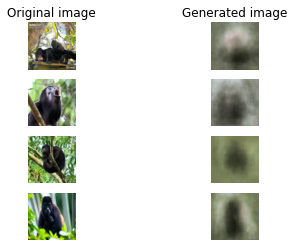

In [ ]:
import matplotlib.pyplot as plt
%matplotlib inline
plt.subplot(421)
plt.imshow(x_test[1])
plt.axis('off')
plt.title('Original image')
plt.grid('off')
plt.subplot(422)
plt.imshow(x_decoded[1])
plt.axis('off')
plt.title('Generated image')
plt.grid('off')
plt.subplot(423)
plt.imshow(x_test[2])
plt.axis('off')
plt.grid('off')
plt.subplot(424)
plt.imshow(x_decoded[2])
plt.axis('off')
plt.subplot(425)
plt.imshow(x_test[3])
plt.axis('off')
plt.subplot(426)
plt.imshow(x_decoded[3])
plt.axis('off')
plt.subplot(427)
plt.imshow(x_test[0])
plt.axis('off')
plt.subplot(428)
plt.imshow(x_decoded[0])
plt.axis('off')
plt.grid('off')
plt.show()

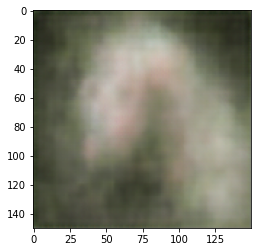

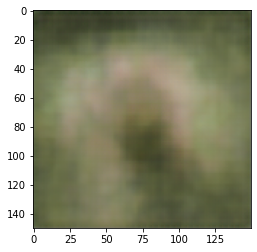

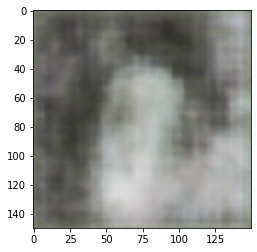

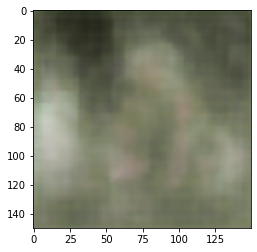

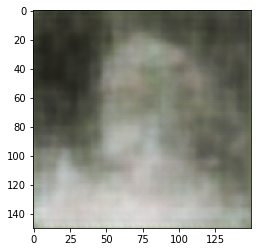

In [ ]:
import matplotlib.pyplot as plt
from keras.preprocessing import image
#random_latent_vectors = np.random.normal(size=(10, latent_dim))

x_decoded = autoencoder.predict(x_test)

for i in range(25,30):
    img = image.array_to_img(x_decoded[i] * 255., scale=False)
    plt.figure()
    plt.imshow(img)
    
plt.show()

### 5th 

latent dim = 15

loss: 1292.1348 - val_loss: 1280.1620


In [ ]:
img_shape=(150,150,3)
batch_size=16
latent_dim=15 # 노말의 dim이 2라 bivariate임. 

input_img=Input(shape=img_shape)
x=Conv2D(32,3,padding='same', strides=2, activation='relu')(input_img)
x=Conv2D(64,3,  strides=2, activation='relu')(x)
shape=k.int_shape(x) # 7,7,64
x=Flatten()(x)
x=Dense(32, activation='relu')(x)
z_mean=Dense(latent_dim)(x)
z_log_var=Dense(latent_dim)(x) # 로그 어쩌고 하는게 conv가 빠름
# 이거 두개 같은거 아님?


def sampling(args):
    z_mean,z_log_var=args
    batch=k.shape(z_mean)[0] # 16
    dim=k.int_shape(z_mean)[1] #2이 들어가게 됨. <-- 이거 맞는지 확인
    epsilon=k.random_normal(shape=(batch,dim))
    return z_mean+k.exp(0.5*z_log_var)*epsilon # 평균이 뮤, 분산이 시그마^2 # 57분
# random number를 generating 시킨 것
z=Lambda(sampling,output_shape=(latent_dim,))([z_mean,z_log_var]) # 얘는 input
# lambda를 통해 built in이 아닌 layer 추가

encoder=Model(input_img,[z_mean, z_log_var, z])
encoder.summary()
plot_model(encoder,show_shapes=True)

latent_input=Input(shape=(latent_dim,))
x=Dense(np.prod(shape[1:]), activation='relu')(latent_input)
x=Reshape(shape[1:])(x) # 7,7,64
x=Conv2DTranspose(64,3,strides=2,activation='relu')(x)
x=Conv2DTranspose(32,3,padding='same',strides=2,activation='relu')(x)
output=Conv2D(3,3, padding='same',activation='sigmoid')(x)
decoder=Model(latent_input,output)
decoder.summary()
plot_model(decoder, show_shapes=True)



f_output=decoder(encoder(input_img)[2]) # 인코더의 output중 z만 필요하므로 [2]
vae=Model(input_img, f_output)
vae.summary()



# Loss function 정의
input_img1=k.flatten(input_img)
f_output1=k.flatten(f_output)
print(input_img1, f_output1)
reconstruction_loss=keras.losses.mse(input_img1, f_output1) # 첫번째 식
reconstruction_loss*=input_img.shape[1]*input_img.shape[1] # 28*28는 빼주기위해서 다시 곱함
inference_loss=1+z_log_var-k.square(z_mean)-k.exp(z_log_var) # 두번째 식
inference_loss=k.sum(inference_loss, axis=-1)*-0.5         #-0.5 왜하는데?
vae_loss=k.mean(reconstruction_loss+inference_loss)

vae.add_loss(vae_loss)
vae.compile(optimizer='rmsprop')


Model: "model_55"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_67 (InputLayer)           (None, 150, 150, 3)  0                                            
__________________________________________________________________________________________________
conv2d_66 (Conv2D)              (None, 75, 75, 32)   896         input_67[0][0]                   
__________________________________________________________________________________________________
conv2d_67 (Conv2D)              (None, 37, 37, 64)   18496       conv2d_66[0][0]                  
__________________________________________________________________________________________________
flatten_39 (Flatten)            (None, 87616)        0           conv2d_67[0][0]                  
___________________________________________________________________________________________

/usr/local/lib/python3.6/dist-packages/keras/engine/training_utils.py:819: UserWarning: Output model_56 missing from loss dictionary. We assume this was done on purpose. The fit and evaluate APIs will not be expecting any data to be passed to model_56.
  'be expecting any data to be passed to {0}.'.format(name))


In [ ]:
vae.fit(x_train, epochs=10, shuffle=True, batch_size=batch_size, validation_data=(x_test,None))

Train on 1096 samples, validate on 272 samples
Epoch 1/10
1096/1096 [==============================] - 20s 18ms/step - loss: 1570.2025 - val_loss: 1461.5094
Epoch 2/10
1096/1096 [==============================] - 20s 18ms/step - loss: 1414.3200 - val_loss: 1355.0449
Epoch 3/10
1096/1096 [==============================] - 19s 18ms/step - loss: 1365.8277 - val_loss: 1339.6806
Epoch 4/10
1096/1096 [==============================] - 19s 17ms/step - loss: 1342.9360 - val_loss: 1355.8047
Epoch 5/10
1096/1096 [==============================] - 19s 17ms/step - loss: 1321.1889 - val_loss: 1305.3227
Epoch 6/10
1096/1096 [==============================] - 19s 17ms/step - loss: 1311.7885 - val_loss: 1293.7354
Epoch 7/10
1096/1096 [==============================] - 19s 18ms/step - loss: 1303.8413 - val_loss: 1290.3861
Epoch 8/10
1096/1096 [==============================] - 20s 18ms/step - loss: 1298.8209 - val_loss: 1287.4729
Epoch 9/10
1096/1096 [==============================] - 20s 18ms/step - l

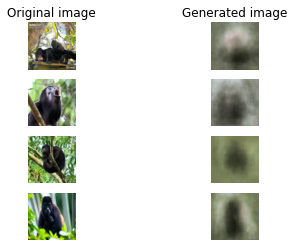

In [ ]:
import matplotlib.pyplot as plt
%matplotlib inline
plt.subplot(421)
plt.imshow(x_test[1])
plt.axis('off')
plt.title('Original image')
plt.grid('off')
plt.subplot(422)
plt.imshow(x_decoded[1])
plt.axis('off')
plt.title('Generated image')
plt.grid('off')
plt.subplot(423)
plt.imshow(x_test[2])
plt.axis('off')
plt.grid('off')
plt.subplot(424)
plt.imshow(x_decoded[2])
plt.axis('off')
plt.subplot(425)
plt.imshow(x_test[3])
plt.axis('off')
plt.subplot(426)
plt.imshow(x_decoded[3])
plt.axis('off')
plt.subplot(427)
plt.imshow(x_test[0])
plt.axis('off')
plt.subplot(428)
plt.imshow(x_decoded[0])
plt.axis('off')
plt.grid('off')
plt.show()

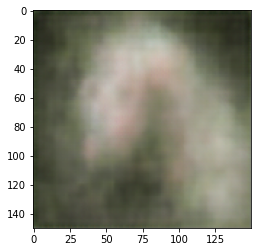

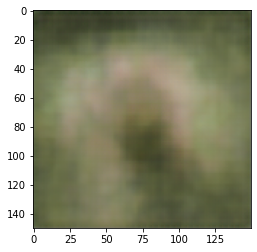

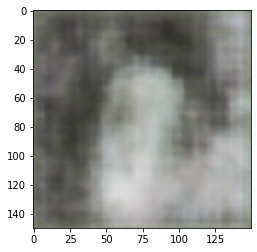

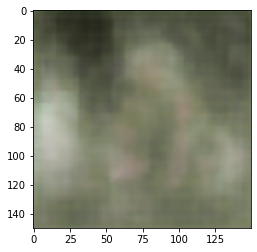

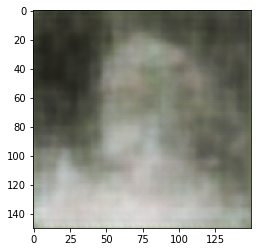

In [ ]:
import matplotlib.pyplot as plt
from keras.preprocessing import image
#random_latent_vectors = np.random.normal(size=(10, latent_dim))

x_decoded = autoencoder.predict(x_test)

for i in range(25,30):
    img = image.array_to_img(x_decoded[i] * 255., scale=False)
    plt.figure()
    plt.imshow(img)
    
plt.show()

### 6th 

latent dim = 8

loss: 1212.0582 - val_loss: 1236.0010

In [ ]:
img_shape=(150,150,3)
batch_size=16
latent_dim=8 # 노말의 dim이 2라 bivariate임. 

input_img=Input(shape=img_shape)
x=Conv2D(32,3,padding='same', strides=2, activation='relu')(input_img)
x=Conv2D(64,3,  strides=2, activation='relu')(x)
shape=k.int_shape(x) # 7,7,64
x=Flatten()(x)
x=Dense(32, activation='relu')(x)
z_mean=Dense(latent_dim)(x)
z_log_var=Dense(latent_dim)(x) # 로그 어쩌고 하는게 conv가 빠름
# 이거 두개 같은거 아님?


def sampling(args):
    z_mean,z_log_var=args
    batch=k.shape(z_mean)[0] # 16
    dim=k.int_shape(z_mean)[1] #2이 들어가게 됨. <-- 이거 맞는지 확인
    epsilon=k.random_normal(shape=(batch,dim))
    return z_mean+k.exp(0.5*z_log_var)*epsilon # 평균이 뮤, 분산이 시그마^2 # 57분
# random number를 generating 시킨 것
z=Lambda(sampling,output_shape=(latent_dim,))([z_mean,z_log_var]) # 얘는 input
# lambda를 통해 built in이 아닌 layer 추가

encoder=Model(input_img,[z_mean, z_log_var, z])
encoder.summary()
plot_model(encoder,show_shapes=True)

latent_input=Input(shape=(latent_dim,))
x=Dense(np.prod(shape[1:]), activation='relu')(latent_input)
x=Reshape(shape[1:])(x) # 7,7,64
x=Conv2DTranspose(64,3,strides=2,activation='relu')(x)
x=Conv2DTranspose(32,3,padding='same',strides=2,activation='relu')(x)
output=Conv2D(3,3, padding='same',activation='sigmoid')(x)
decoder=Model(latent_input,output)
decoder.summary()
plot_model(decoder, show_shapes=True)



f_output=decoder(encoder(input_img)[2]) # 인코더의 output중 z만 필요하므로 [2]
vae=Model(input_img, f_output)
vae.summary()



# Loss function 정의
input_img1=k.flatten(input_img)
f_output1=k.flatten(f_output)
print(input_img1, f_output1)
reconstruction_loss=keras.losses.mse(input_img1, f_output1) # 첫번째 식
reconstruction_loss*=input_img.shape[1]*input_img.shape[1] # 28*28는 빼주기위해서 다시 곱함
inference_loss=1+z_log_var-k.square(z_mean)-k.exp(z_log_var) # 두번째 식
inference_loss=k.sum(inference_loss, axis=-1)*-0.5         #-0.5 왜하는데?
vae_loss=k.mean(reconstruction_loss+inference_loss)

vae.add_loss(vae_loss)
vae.compile(optimizer='rmsprop')


Model: "model_58"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_69 (InputLayer)           (None, 150, 150, 3)  0                                            
__________________________________________________________________________________________________
conv2d_69 (Conv2D)              (None, 75, 75, 32)   896         input_69[0][0]                   
__________________________________________________________________________________________________
conv2d_70 (Conv2D)              (None, 37, 37, 64)   18496       conv2d_69[0][0]                  
__________________________________________________________________________________________________
flatten_40 (Flatten)            (None, 87616)        0           conv2d_70[0][0]                  
___________________________________________________________________________________________

/usr/local/lib/python3.6/dist-packages/keras/engine/training_utils.py:819: UserWarning: Output model_59 missing from loss dictionary. We assume this was done on purpose. The fit and evaluate APIs will not be expecting any data to be passed to model_59.
  'be expecting any data to be passed to {0}.'.format(name))


In [ ]:
vae.fit(x_train, epochs=10, shuffle=True, batch_size=batch_size, validation_data=(x_test,None))

Train on 1096 samples, validate on 272 samples
Epoch 1/10
1096/1096 [==============================] - 18s 16ms/step - loss: 1570.6483 - val_loss: 1497.2402
Epoch 2/10
1096/1096 [==============================] - 17s 16ms/step - loss: 1437.7480 - val_loss: 1373.7809
Epoch 3/10
1096/1096 [==============================] - 18s 17ms/step - loss: 1363.2174 - val_loss: 1320.4055
Epoch 4/10
1096/1096 [==============================] - 18s 16ms/step - loss: 1319.0713 - val_loss: 1276.5708
Epoch 5/10
1096/1096 [==============================] - 17s 16ms/step - loss: 1272.8036 - val_loss: 1270.1909
Epoch 6/10
1096/1096 [==============================] - 17s 16ms/step - loss: 1250.2260 - val_loss: 1242.8492
Epoch 7/10
1096/1096 [==============================] - 17s 16ms/step - loss: 1237.7732 - val_loss: 1222.8101
Epoch 8/10
1096/1096 [==============================] - 17s 16ms/step - loss: 1228.5646 - val_loss: 1207.0892
Epoch 9/10
1096/1096 [==============================] - 17s 16ms/step - l

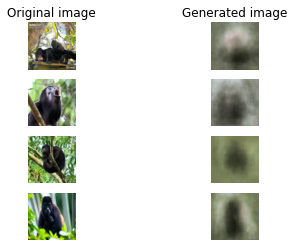

In [ ]:
import matplotlib.pyplot as plt
%matplotlib inline
plt.subplot(421)
plt.imshow(x_test[1])
plt.axis('off')
plt.title('Original image')
plt.grid('off')
plt.subplot(422)
plt.imshow(x_decoded[1])
plt.axis('off')
plt.title('Generated image')
plt.grid('off')
plt.subplot(423)
plt.imshow(x_test[2])
plt.axis('off')
plt.grid('off')
plt.subplot(424)
plt.imshow(x_decoded[2])
plt.axis('off')
plt.subplot(425)
plt.imshow(x_test[3])
plt.axis('off')
plt.subplot(426)
plt.imshow(x_decoded[3])
plt.axis('off')
plt.subplot(427)
plt.imshow(x_test[0])
plt.axis('off')
plt.subplot(428)
plt.imshow(x_decoded[0])
plt.axis('off')
plt.grid('off')
plt.show()

# 8) ResNet - 50

## 1st Kaggle

Monkey Classifier 

https://www.kaggle.com/kgkevinwg/monkey-classifier-97-accuracy-using-resnet-50

In [ ]:
N_CLASSES = 10
EPOCHS = 15
PATIENCE = 5
TRAIN_PATH= 'monkeys10/training/training/'
VALID_PATH = 'monkeys10/validation/validation/'
MODEL_CHECK_WEIGHT_NAME = 'resnet_monki_v1_chk.h5'

In [ ]:
k.set_learning_phase(0)
model = ResNet50(input_shape=(224,224,3),include_top=False, weights='imagenet', pooling='avg')
k.set_learning_phase(1)
x = model.output
x = Dense(512, activation='relu')(x)
x = Dropout(0.5)(x)
x = Dense(512, activation='relu')(x)
x = Dropout(0.5)(x)
output = Dense(N_CLASSES, activation='softmax', name='custom_output')(x)
custom_resnet = Model(inputs=model.input, outputs = output)

for layer in model.layers:
    layer.trainable = False

custom_resnet.compile(Adam(lr=0.001), loss='categorical_crossentropy', metrics=['accuracy'])
custom_resnet.summary()

94658560/94653016 [==============================] - 1s 0us/step
Model: "model_64"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_74 (InputLayer)           (None, 224, 224, 3)  0                                            
__________________________________________________________________________________________________
conv1_pad (ZeroPadding2D)       (None, 230, 230, 3)  0           input_74[0][0]                   
__________________________________________________________________________________________________
conv1 (Conv2D)                  (None, 112, 112, 64) 9472        conv1_pad[0][0]                  
__________________________________________________________________________________________________
bn_conv1 (BatchNormalization)   (None, 112, 112, 64) 256         conv1[0][0]                      
__________________________

In [ ]:
datagen = ImageDataGenerator(preprocessing_function=preprocess_input)
traingen = datagen.flow_from_directory(TRAIN_PATH, target_size=(224,224), batch_size=32, class_mode='categorical')
validgen = datagen.flow_from_directory(VALID_PATH, target_size=(224,224), batch_size=32, class_mode='categorical', shuffle=False)

Found 1098 images belonging to 10 classes.
Found 272 images belonging to 10 classes.


In [ ]:
es_callback = EarlyStopping(monitor='val_acc', patience=PATIENCE, mode='max')
mc_callback = ModelCheckpoint(filepath=MODEL_CHECK_WEIGHT_NAME, monitor='val_acc', save_best_only=True, mode='max')
train_history = custom_resnet.fit_generator(traingen, steps_per_epoch=len(traingen), epochs= EPOCHS, validation_data=validgen, validation_steps=len(validgen), verbose=2, callbacks=[es_callback, mc_callback])

Epoch 1/15
 - 43s - loss: 1.3703 - accuracy: 0.5565 - val_loss: 0.1851 - val_accuracy: 0.8993
Epoch 2/15


/usr/local/lib/python3.6/dist-packages/keras/callbacks/callbacks.py:846: RuntimeWarning: Early stopping conditioned on metric `val_acc` which is not available. Available metrics are: val_loss,val_accuracy,loss,accuracy
  (self.monitor, ','.join(list(logs.keys()))), RuntimeWarning
/usr/local/lib/python3.6/dist-packages/keras/callbacks/callbacks.py:707: RuntimeWarning: Can save best model only with val_acc available, skipping.
  'skipping.' % (self.monitor), RuntimeWarning)


 - 39s - loss: 0.2699 - accuracy: 0.9144 - val_loss: 0.2244 - val_accuracy: 0.9062
Epoch 3/15
 - 39s - loss: 0.1539 - accuracy: 0.9490 - val_loss: 0.0161 - val_accuracy: 0.9861
Epoch 4/15
 - 39s - loss: 0.1159 - accuracy: 0.9617 - val_loss: 0.1273 - val_accuracy: 0.9662
Epoch 5/15
 - 37s - loss: 0.0947 - accuracy: 0.9663 - val_loss: 0.0500 - val_accuracy: 0.9653
Epoch 6/15
 - 39s - loss: 0.0344 - accuracy: 0.9900 - val_loss: 0.0285 - val_accuracy: 0.9896
Epoch 7/15
 - 39s - loss: 0.0309 - accuracy: 0.9909 - val_loss: 0.0154 - val_accuracy: 0.9896
Epoch 8/15
 - 40s - loss: 0.0456 - accuracy: 0.9836 - val_loss: 0.1044 - val_accuracy: 0.9774
Epoch 9/15
 - 39s - loss: 0.0380 - accuracy: 0.9882 - val_loss: 0.1745 - val_accuracy: 0.9896
Epoch 10/15
 - 39s - loss: 0.0265 - accuracy: 0.9918 - val_loss: 0.0873 - val_accuracy: 0.9965
Epoch 11/15
 - 39s - loss: 0.0650 - accuracy: 0.9791 - val_loss: 0.0271 - val_accuracy: 0.9896
Epoch 12/15
 - 41s - loss: 0.0990 - accuracy: 0.9745 - val_loss: 0.09

In [ ]:
custom_resnet.load_weights(MODEL_CHECK_WEIGHT_NAME)

In [ ]:
predict = custom_resnet.predict_generator(validgen, steps=len(validgen), verbose=1)
test_labels = validgen.classes
confusion_matrix(test_labels, predict.argmax(axis=1))

9/9 [==============================] - 10s 1s/step


array([[26,  0,  0,  0,  0,  0,  0,  0,  0,  0],
       [ 0, 28,  0,  0,  0,  0,  0,  0,  0,  0],
       [ 0,  0, 27,  0,  0,  0,  0,  0,  0,  0],
       [ 0,  0,  0, 26,  2,  0,  1,  0,  0,  1],
       [ 1,  0,  0,  0, 25,  0,  0,  0,  0,  0],
       [ 0,  0,  0,  0,  1, 26,  1,  0,  0,  0],
       [ 0,  0,  0,  0,  0,  1, 25,  0,  0,  0],
       [ 0,  0,  0,  0,  0,  0,  0, 28,  0,  0],
       [ 0,  0,  0,  0,  2,  0,  0,  0, 25,  0],
       [ 0,  0,  0,  0,  1,  0,  0,  0,  0, 25]])

In [ ]:
cr_labels = list(validgen.class_indices.keys())
classification_report(test_labels, predict.argmax(axis=1), target_names=cr_labels)

'              precision    recall  f1-score   support\n\n          n0       0.96      1.00      0.98        26\n          n1       1.00      1.00      1.00        28\n          n2       1.00      1.00      1.00        27\n          n3       1.00      0.87      0.93        30\n          n4       0.81      0.96      0.88        26\n          n5       0.96      0.93      0.95        28\n          n6       0.93      0.96      0.94        26\n          n7       1.00      1.00      1.00        28\n          n8       1.00      0.93      0.96        27\n          n9       0.96      0.96      0.96        26\n\n    accuracy                           0.96       272\n   macro avg       0.96      0.96      0.96       272\nweighted avg       0.96      0.96      0.96       272\n'

In [ ]:
accuracy_score(test_labels,predict.argmax(axis=1))

0.9595588235294118

## 2nd
512-512

0.5-0.5

0.9740 - val_loss: 0.2856 - val_accuracy: 0.9265

In [ ]:
N_CLASSES = 10
EPOCHS = 15
PATIENCE = 5
TRAIN_PATH= 'monkeys10/training/training/'
VALID_PATH = 'monkeys10/validation/validation/'
MODEL_CHECK_WEIGHT_NAME = 'resnet_monki_v1_chk.h5'

datagen = ImageDataGenerator(rescale=1./255)
datagen = ImageDataGenerator(preprocessing_function=preprocess_input)
traingen = datagen.flow_from_directory(TRAIN_PATH, target_size=(150,150), 
                                       batch_size=16, class_mode='categorical')
validgen = datagen.flow_from_directory(VALID_PATH, target_size=(150,150), 
                                       batch_size=16, class_mode='categorical', shuffle=False)



STEP_SIZE_TRAIN=traingen.n//traingen.batch_size
STEP_SIZE_VALID=validgen.n//validgen.batch_size

Found 1098 images belonging to 10 classes.
Found 272 images belonging to 10 classes.


In [ ]:
k.set_learning_phase(0)
model = ResNet50(input_shape=(150,150,3),include_top=False, weights='imagenet', pooling='avg')
k.set_learning_phase(1)
x = model.output
x = Dense(512, activation='relu')(x)
x = Dropout(0.5)(x)
x = Dense(512, activation='relu')(x)
x = Dropout(0.5)(x)
output = Dense(N_CLASSES, activation='softmax', name='custom_output')(x)
custom_resnet = Model(inputs=model.input, outputs = output)

for layer in model.layers:
    layer.trainable = False

custom_resnet.compile(Adam(lr=0.001), loss='categorical_crossentropy', metrics=['accuracy'])
custom_resnet.summary()

NameError: ignored

In [ ]:
es_callback = EarlyStopping(monitor='val_acc', patience=PATIENCE, mode='max')
mc_callback = ModelCheckpoint(filepath=MODEL_CHECK_WEIGHT_NAME, monitor='val_acc', save_best_only=True, mode='max')
train_history = custom_resnet.fit_generator(traingen, steps_per_epoch=68, epochs= 10, 
                                            validation_data=validgen, validation_steps=STEP_SIZE_VALID, verbose=2, callbacks=[es_callback, mc_callback])

Epoch 1/10
 - 37s - loss: 1.3701 - accuracy: 0.6183 - val_loss: 0.3476 - val_accuracy: 0.8235
Epoch 2/10


/usr/local/lib/python3.6/dist-packages/keras/callbacks/callbacks.py:846: RuntimeWarning: Early stopping conditioned on metric `val_acc` which is not available. Available metrics are: val_loss,val_accuracy,loss,accuracy
  (self.monitor, ','.join(list(logs.keys()))), RuntimeWarning
/usr/local/lib/python3.6/dist-packages/keras/callbacks/callbacks.py:707: RuntimeWarning: Can save best model only with val_acc available, skipping.
  'skipping.' % (self.monitor), RuntimeWarning)


 - 36s - loss: 0.4147 - accuracy: 0.8667 - val_loss: 0.7187 - val_accuracy: 0.8750
Epoch 3/10
 - 36s - loss: 0.3107 - accuracy: 0.9052 - val_loss: 0.4360 - val_accuracy: 0.9118
Epoch 4/10
 - 36s - loss: 0.1863 - accuracy: 0.9357 - val_loss: 0.2245 - val_accuracy: 0.8419
Epoch 5/10
 - 37s - loss: 0.1574 - accuracy: 0.9452 - val_loss: 0.0306 - val_accuracy: 0.9118
Epoch 6/10
 - 36s - loss: 0.1620 - accuracy: 0.9504 - val_loss: 0.0705 - val_accuracy: 0.9301
Epoch 7/10
 - 35s - loss: 0.1066 - accuracy: 0.9656 - val_loss: 0.5563 - val_accuracy: 0.9118
Epoch 8/10
 - 36s - loss: 0.1290 - accuracy: 0.9584 - val_loss: 0.2805 - val_accuracy: 0.9044
Epoch 9/10
 - 36s - loss: 0.0817 - accuracy: 0.9770 - val_loss: 0.2882 - val_accuracy: 0.9228
Epoch 10/10
 - 35s - loss: 0.0882 - accuracy: 0.9740 - val_loss: 0.2856 - val_accuracy: 0.9265


## 3rd
512-256

0.6-0.5

0.9519 - val_loss: 0.1350 - val_accuracy: 0.9449

In [ ]:
N_CLASSES = 10
EPOCHS = 15
PATIENCE = 5
TRAIN_PATH= 'monkeys10/training/training/'
VALID_PATH = 'monkeys10/validation/validation/'
MODEL_CHECK_WEIGHT_NAME = 'resnet_monki_v1_chk.h5'

#datagen = ImageDataGenerator(rescale=1./255)
datagen = ImageDataGenerator(preprocessing_function=preprocess_input)
traingen = datagen.flow_from_directory(TRAIN_PATH, target_size=(150,150), 
                                       batch_size=16, class_mode='categorical')
validgen = datagen.flow_from_directory(VALID_PATH, target_size=(150,150), 
                                       batch_size=16, class_mode='categorical', shuffle=False)



STEP_SIZE_TRAIN=traingen.n//traingen.batch_size
STEP_SIZE_VALID=validgen.n//validgen.batch_size

Found 1098 images belonging to 10 classes.
Found 272 images belonging to 10 classes.


In [ ]:
k.set_learning_phase(0)
model = ResNet50(input_shape=(150,150,3),include_top=False, weights='imagenet', pooling='avg')
k.set_learning_phase(1)
x = model.output
x = Dense(512, activation='relu')(x)
x = Dropout(0.6)(x)
x = Dense(256, activation='relu')(x)
x = Dropout(0.5)(x)
output = Dense(N_CLASSES, activation='softmax', name='custom_output')(x)
custom_resnet = Model(inputs=model.input, outputs = output)

for layer in model.layers:
    layer.trainable = False

custom_resnet.compile(Adam(lr=0.001), loss='categorical_crossentropy', metrics=['accuracy'])
#custom_resnet.summary()

In [ ]:
es_callback = EarlyStopping(monitor='val_acc', patience=PATIENCE, mode='max')
mc_callback = ModelCheckpoint(filepath=MODEL_CHECK_WEIGHT_NAME, monitor='val_acc', save_best_only=True, mode='max')
train_history = custom_resnet.fit_generator(traingen, steps_per_epoch=68, epochs= 10, 
                                            validation_data=validgen, validation_steps=STEP_SIZE_VALID, verbose=2, callbacks=[es_callback, mc_callback])

Epoch 1/10
 - 38s - loss: 1.9747 - accuracy: 0.4834 - val_loss: 0.7904 - val_accuracy: 0.7610
Epoch 2/10


/usr/local/lib/python3.6/dist-packages/keras/callbacks/callbacks.py:846: RuntimeWarning: Early stopping conditioned on metric `val_acc` which is not available. Available metrics are: val_loss,val_accuracy,loss,accuracy
  (self.monitor, ','.join(list(logs.keys()))), RuntimeWarning
/usr/local/lib/python3.6/dist-packages/keras/callbacks/callbacks.py:707: RuntimeWarning: Can save best model only with val_acc available, skipping.
  'skipping.' % (self.monitor), RuntimeWarning)


 - 37s - loss: 0.6148 - accuracy: 0.7884 - val_loss: 0.7271 - val_accuracy: 0.7978
Epoch 3/10
 - 36s - loss: 0.4389 - accuracy: 0.8651 - val_loss: 0.6156 - val_accuracy: 0.8419
Epoch 4/10
 - 36s - loss: 0.3292 - accuracy: 0.8882 - val_loss: 1.0645 - val_accuracy: 0.8419
Epoch 5/10
 - 36s - loss: 0.3099 - accuracy: 0.9039 - val_loss: 1.0232 - val_accuracy: 0.8566
Epoch 6/10
 - 36s - loss: 0.2538 - accuracy: 0.9298 - val_loss: 0.8539 - val_accuracy: 0.8934
Epoch 7/10
 - 35s - loss: 0.2349 - accuracy: 0.9335 - val_loss: 0.8658 - val_accuracy: 0.8713
Epoch 8/10
 - 35s - loss: 0.2539 - accuracy: 0.9196 - val_loss: 0.4245 - val_accuracy: 0.9118
Epoch 9/10
 - 35s - loss: 0.1769 - accuracy: 0.9464 - val_loss: 1.5164 - val_accuracy: 0.9007
Epoch 10/10
 - 35s - loss: 0.1696 - accuracy: 0.9519 - val_loss: 0.1350 - val_accuracy: 0.9449


## 4th

512 - 256

0.6-0.55

In [ ]:
k.set_learning_phase(0)
model = ResNet50(input_shape=(150,150,3),include_top=False, weights='imagenet', pooling='avg')
k.set_learning_phase(1)
x = model.output
x = Dense(512, activation='relu')(x)
x = Dropout(0.6)(x)
x = Dense(256, activation='relu')(x)
x = Dropout(0.55)(x)
output = Dense(N_CLASSES, activation='softmax', name='custom_output')(x)
custom_resnet = Model(inputs=model.input, outputs = output)

for layer in model.layers:
    layer.trainable = False

custom_resnet.compile(Adam(lr=0.001), loss='categorical_crossentropy', metrics=['accuracy'])
#custom_resnet.summary()

94658560/94653016 [==============================] - 1s 0us/step


In [ ]:
es_callback = EarlyStopping(monitor='val_acc', patience=PATIENCE, mode='max')
mc_callback = ModelCheckpoint(filepath=MODEL_CHECK_WEIGHT_NAME, monitor='val_acc', save_best_only=True, mode='max')
train_history = custom_resnet.fit_generator(traingen, steps_per_epoch=68, epochs= 10, 
                                            validation_data=validgen, validation_steps=STEP_SIZE_VALID, verbose=2, callbacks=[es_callback, mc_callback])

Epoch 1/10
 - 336s - loss: 2.3583 - accuracy: 0.4076 - val_loss: 2.1489 - val_accuracy: 0.6103
Epoch 2/10


/usr/local/lib/python3.6/dist-packages/keras/callbacks/callbacks.py:846: RuntimeWarning: Early stopping conditioned on metric `val_acc` which is not available. Available metrics are: val_loss,val_accuracy,loss,accuracy
  (self.monitor, ','.join(list(logs.keys()))), RuntimeWarning
/usr/local/lib/python3.6/dist-packages/keras/callbacks/callbacks.py:707: RuntimeWarning: Can save best model only with val_acc available, skipping.
  'skipping.' % (self.monitor), RuntimeWarning)


 - 34s - loss: 0.7195 - accuracy: 0.7579 - val_loss: 0.2734 - val_accuracy: 0.7610
Epoch 3/10
 - 34s - loss: 0.4741 - accuracy: 0.8475 - val_loss: 2.0267 - val_accuracy: 0.8382
Epoch 4/10
 - 33s - loss: 0.3697 - accuracy: 0.8808 - val_loss: 0.3445 - val_accuracy: 0.8897
Epoch 5/10
 - 33s - loss: 0.3358 - accuracy: 0.8909 - val_loss: 2.3707 - val_accuracy: 0.8897
Epoch 6/10
 - 33s - loss: 0.2643 - accuracy: 0.9159 - val_loss: 0.9198 - val_accuracy: 0.8382
Epoch 7/10
 - 33s - loss: 0.1724 - accuracy: 0.9427 - val_loss: 0.6790 - val_accuracy: 0.8713
Epoch 8/10
 - 33s - loss: 0.2136 - accuracy: 0.9261 - val_loss: 0.3753 - val_accuracy: 0.9228
Epoch 9/10
 - 33s - loss: 0.2151 - accuracy: 0.9283 - val_loss: 0.0599 - val_accuracy: 0.9044
Epoch 10/10
 - 31s - loss: 0.1590 - accuracy: 0.9507 - val_loss: 0.2629 - val_accuracy: 0.9228


## 5th

512 - 256

0.65-0.55

0.9390 - val_loss: 0.9138 - val_accuracy: 0.8676

In [ ]:
k.set_learning_phase(0)
model = ResNet50(input_shape=(150,150,3),include_top=False, weights='imagenet', pooling='avg')
k.set_learning_phase(1)
x = model.output
x = Dense(512, activation='relu')(x)
x = Dropout(0.65)(x)
x = Dense(256, activation='relu')(x)
x = Dropout(0.55)(x)
output = Dense(N_CLASSES, activation='softmax', name='custom_output')(x)
custom_resnet = Model(inputs=model.input, outputs = output)

for layer in model.layers:
    layer.trainable = False

custom_resnet.compile(Adam(lr=0.001), loss='categorical_crossentropy', metrics=['accuracy'])
#custom_resnet.summary()

In [ ]:
es_callback = EarlyStopping(monitor='val_acc', patience=PATIENCE, mode='max')
mc_callback = ModelCheckpoint(filepath=MODEL_CHECK_WEIGHT_NAME, monitor='val_acc', save_best_only=True, mode='max')
train_history = custom_resnet.fit_generator(traingen, steps_per_epoch=68, epochs= 10, 
                                            validation_data=validgen, validation_steps=STEP_SIZE_VALID, verbose=2, callbacks=[es_callback, mc_callback])

Epoch 1/10
 - 34s - loss: 2.4777 - accuracy: 0.3392 - val_loss: 1.6383 - val_accuracy: 0.5551
Epoch 2/10


/usr/local/lib/python3.6/dist-packages/keras/callbacks/callbacks.py:846: RuntimeWarning: Early stopping conditioned on metric `val_acc` which is not available. Available metrics are: val_loss,val_accuracy,loss,accuracy
  (self.monitor, ','.join(list(logs.keys()))), RuntimeWarning
/usr/local/lib/python3.6/dist-packages/keras/callbacks/callbacks.py:707: RuntimeWarning: Can save best model only with val_acc available, skipping.
  'skipping.' % (self.monitor), RuntimeWarning)


 - 35s - loss: 0.9285 - accuracy: 0.6848 - val_loss: 1.4035 - val_accuracy: 0.7537
Epoch 3/10
 - 34s - loss: 0.6168 - accuracy: 0.7976 - val_loss: 0.6701 - val_accuracy: 0.8015
Epoch 4/10
 - 34s - loss: 0.4237 - accuracy: 0.8595 - val_loss: 0.4906 - val_accuracy: 0.8603
Epoch 5/10
 - 33s - loss: 0.3231 - accuracy: 0.9020 - val_loss: 0.6739 - val_accuracy: 0.8566
Epoch 6/10
 - 34s - loss: 0.3463 - accuracy: 0.8974 - val_loss: 0.9666 - val_accuracy: 0.8640
Epoch 7/10
 - 33s - loss: 0.2258 - accuracy: 0.9237 - val_loss: 0.8186 - val_accuracy: 0.8787
Epoch 8/10
 - 33s - loss: 0.2570 - accuracy: 0.9173 - val_loss: 0.4906 - val_accuracy: 0.8787
Epoch 9/10
 - 32s - loss: 0.2574 - accuracy: 0.9261 - val_loss: 0.2204 - val_accuracy: 0.9191
Epoch 10/10
 - 32s - loss: 0.1984 - accuracy: 0.9390 - val_loss: 0.9138 - val_accuracy: 0.8676


# 기타

## 224,224,3 으로 바꿔서 하나 해보자

그렇다고 성능이 더 좋은건 아니다

In [ ]:
vgg_base2=VGG16(weights='imagenet') 
vgg_base2.summary()

553467904/553467096 [==============================] - 7s 0us/step
Model: "vgg16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_7 (InputLayer)         (None, 224, 224, 3)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
____________________________________________________________

In [ ]:
# image generator로 rescale만 하고 새로만들진 않음.
train_datagen=ImageDataGenerator(rescale=1./255)
validation_datagen=ImageDataGenerator(rescale=1./255)
train_generator=train_datagen.flow_from_directory(train_dir,target_size=(224,224),
                                              batch_size=16, class_mode='categorical')
validation_generator=train_datagen.flow_from_directory(validation_dir,target_size=(224,224),
                                              batch_size=16, class_mode='categorical')

Found 1098 images belonging to 10 classes.
Found 272 images belonging to 10 classes.


In [ ]:
from keras.callbacks import ReduceLROnPlateau
STEP_SIZE_TRAIN=train_generator.n//train_generator.batch_size
STEP_SIZE_VALID=validation_generator.n//validation_generator.batch_size

learning_rate_reduction = ReduceLROnPlateau(monitor='val_accuracy', # 검증 정확도를 기준으로 call back 호출ㄹ
                                            patience=2,   # epoch2동안 개선 되지 않으면 call back호출
                                            verbose=1, 
                                            factor=0.5, # callback호출시 학습률을 1/2로 줄임
                                            min_lr=0.00001)

In [ ]:
model6_tran.summary()

ValueError: ignored

In [ ]:
model6_tran = Sequential()
for layer in vgg_base2.layers[:]:
  model6_tran.add(layer)

for layer in model6_tran.layers:
  layer.trainable = False


#model6_tran.add(Flatten())
#model6_tran.add(Dense(256, activation='relu'))
model6_tran.add(Dropout(0.6))
model6_tran.add(Dense(10, activation='softmax'))
model6_tran.summary()
  
model6_tran.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model6_tran.fit_generator(generator=train_generator,
                          steps_per_epoch=STEP_SIZE_TRAIN,
                          validation_data=validation_generator,
                          validation_steps=STEP_SIZE_VALID,
                          epochs=10,
                          verbose=1,
                          callbacks=[learning_rate_reduction])

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)       0         
_________________________________________________________________
block3_conv1 (Conv2D)        (None, 56, 56, 256)      